<a href="https://colab.research.google.com/github/gabrie1-s/Chagas_analysis/blob/lstm/Attention_based_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Version: A-LSTM_1.0.0

## Download files

In [1]:
%%capture
!pip install neptune-notebooks

In [2]:
%%capture
!jupyter nbextension enable --py neptune-notebooks

In [3]:
%%capture
!pip install neptune-client

In [4]:
%%capture
!pip install mat73
!pip install Bayesian-Optimization
!pip install pycatch22
!pip install ray
!pip install h5py

In [5]:
import keras
import pdb
import gc
import requests

In [6]:
from google.colab import drive
import mat73
import scipy.io as sio
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import random
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error
import pycatch22
import ray
import requests
import neptune.new as neptune

/usr/local/lib/python3.10/dist-packages/neptune/internal/backends/hosted_client.py:51: NeptuneDeprecationWarning: The 'neptune-client' package has been deprecated and will be removed in the future. Install the 'neptune' package instead. For more, see https://docs.neptune.ai/setup/upgrading/
  from neptune.version import version as neptune_client_version
<ipython-input-6-63106ba5601a>:14: NeptuneDeprecationWarning: You're importing the Neptune client library via the deprecated `neptune.new` module, which will be removed in a future release. Import directly from `neptune` instead.
  import neptune.new as neptune


In [7]:
drive.mount('/content/drive')

Mounted at /content/drive


In [8]:
%cd /content/drive/MyDrive/CNN_Chagas/Chagas/LSTM

/content/drive/MyDrive/CNN_Chagas/Chagas/LSTM


In [9]:
# run = neptune.init_run(
#     project="gabrie1-s/NACA-data-extraction",
#     api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI1ODlmNWY4ZS0zNmUzLTQ3NWQtYmVkYy05ZmUyMDM4ZGQxMzkifQ==",
#     description='''Usando os dados da execução NACA-17, vamos criar um modelo
#     de LSTM que recebe sinais constituídos por 3 batimentos. Esse modelo será
#     otimizado pela Otimização Bayesiana''',
#     source_files=["LSTM.ipynb"],
# )  # your credentials

# run["code_version"] = "LSTM_2.0.2"

In [10]:
%cd -

/content


In [11]:
dataset = mat73.loadmat('/content/drive/MyDrive/CNN_Chagas/Chagas/data/Dataset_Raw.mat')

In [12]:
signals = list(dataset['Dataset_Raw'])

output = []
for i in range(0, len(signals)):
    output.append(signals[i][-1])
    signals[i] = np.delete(signals[i], [-1,-2])
    # signals[i] = signals[i][0:1000]

In [13]:
for idx, signal in enumerate(signals):
  for i in range(1, len(signal)):
    if signal[-1] != 0:
      break
    if signal[-1*i] != 0:
      signals[idx] = signals[idx][0:(-1*i+1)]
      break

In [14]:
def discrete_ratio(ratio_set, n):
    classes = list(range(1, n+1))
    ratio = 1.0/n

    for j in range(0, len(ratio_set)):
        for i in range(0, n):
            if ratio_set[j] > ratio*i and ratio_set[j] <= ratio*(i+1):
                ratio_set[j] = int(classes[i])
                break

    return ratio_set

In [15]:
output = discrete_ratio(output, 2)

In [16]:
output = [i-1 for i in output]

## Preprocessing and analisys

In [17]:
q = 1000

In [18]:
def window(signalss, q):
  new_signal = []
  for s in signalss:
    new_s = []
    for i in range(0, len(s)-q, q):
      new_s.append(s[i:i+1000])

    new_signal.append(new_s)

  return new_signal

In [19]:
signals = window(signals, q)

In [20]:
len(signals[0][0])

1000

In [21]:
ray.init()

2023-09-14 13:02:14,767	INFO worker.py:1621 -- Started a local Ray instance.


Python version:,3.10.12
Ray version:,2.6.3


In [22]:
@ray.remote
def catch_feat(s):
  new_s = []
  for feat in s:
    feature = pycatch22.catch22_all(feat)
    new_s.append(feature['values'])

  return new_s

In [23]:
def get_max_min(vec):
  arrays = []
  for i in vec:
    for j in i:
      arrays.append(j)

  arrays = np.array(arrays)
  arrays = arrays.transpose()

  mn = []
  mx = []

  for i in arrays:
    mn.append(min(i))
    mx.append(max(i))

  return np.array(mn), np.array(mx)

In [24]:
def normalize(vec, mn, mx):
  divisor = np.subtract(mx, mn)

  for i, v in enumerate(vec):
    val = np.subtract(v, mn)
    val = np.divide(val, divisor)
    vec[i] = val

  return vec

In [25]:
features = ray.get([catch_feat.remote(s) for s in signals])

In [26]:
x_rem, x_te, y_rem, y_te = train_test_split(features, output, test_size=0.15, stratify=output, random_state=38)
x_tr, x_va, y_tr, y_va = train_test_split(x_rem, y_rem, test_size=0.15, stratify=y_rem, random_state=38)

In [27]:
mn, mx = get_max_min(x_tr)

In [28]:
x_tr = normalize(x_tr, mn, mx)
x_va = normalize(x_va, mn, mx)
x_te = normalize(x_te, mn, mx)

In [29]:
def split_beats(signals, classes, bps):
    result_s = []
    result_c = []
    for idx, signal in enumerate(signals):
        for i in range(0, len(signal)-bps, bps):
            result_s.append(signal[i:i+bps])
            result_c.append(classes[idx])

    return result_s, result_c

In [30]:
bps = 200

In [31]:
x_tr, y_tr = split_beats(x_tr, y_tr, bps)
x_va, y_va = split_beats(x_va, y_va, bps)
x_te, y_te = split_beats(x_te, y_te, bps)

In [32]:
del cross_val_score, sio, mat73, i, requests, train_test_split
gc.collect()

30

In [33]:
y_va = np.array(y_va)
y_tr = np.array(y_tr)
y_te = np.array(y_te)

In [34]:
y_tr = np.reshape(y_tr, (y_tr.shape[0], -1))
y_va = np.reshape(y_va, (y_va.shape[0], -1))
y_te = np.reshape(y_te, (y_te.shape[0], -1))

In [35]:
x_tr = np.array(list(x_tr))
x_va = np.array(list(x_va))
x_te = np.array(list(x_te))

In [36]:
x_tr.shape

(1161, 200, 22)

In [37]:
inp_shape = (x_tr.shape[1], x_tr.shape[2])

In [38]:
inp_shape

(200, 22)

In [39]:
from keras.models import Sequential, load_model
from keras.layers import Dense, Flatten, LSTM, Dropout, Layer, Input
from keras.layers import GlobalAveragePooling1D, TimeDistributed, Multiply, GlobalMaxPooling1D
import keras.backend as K

from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction, load_logs
from bayes_opt.logger import JSONLogger
from bayes_opt.event import Events

from tensorflow.keras.optimizers import Adam, Adadelta,Adamax
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from math import floor
from sklearn.metrics import accuracy_score, f1_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn import metrics

import tensorflow as tf
import os

In [40]:
def network(units, optimizer, learning_rate):

    # Define custom initializers for kernel and bias
    '''kernel_init = Constant(value=0.1)
    matrix = np.full((units, 4*units), 0.1)
    matrix = gram_schmidt(matrix)
    matrix = Constant(value=matrix)'''


    encoder_inputs = Input(shape=inp_shape)
    att1 = GlobalMaxPooling1D()(encoder_inputs)
    # att1 = np.ones((22,1))
    se = Dense(22, activation='softmax')(att1)
    weighted_inputs = Multiply()([encoder_inputs, att1])

    encoder = LSTM(units, return_sequences=True, return_state=True)
    encoder_outputs, state_h, state_c = encoder(weighted_inputs)

    encoder_states = [state_h, state_c]

    att2 = GlobalAveragePooling1D()(encoder_outputs)
    se = Dense(bps, activation='softmax')(att2)
    att_out = Multiply()([encoder_outputs, att2])

    decoder_lstm = LSTM(units, return_sequences=True)(att_out, initial_state=encoder_states)

    output = Flatten()(decoder_lstm)

    output = Dense(1, activation='sigmoid')(output)

    classificador = tf.keras.Model(inputs=encoder_inputs, outputs=output)

    classificador.compile(loss='binary_crossentropy', optimizer=optimizer(learning_rate=learning_rate),weighted_metrics=['accuracy'])

    return classificador

In [41]:
def evaluate_network(units, optimizer, batch_size, learning_rate):

    units = 20*round(units)
    optimizer = round(optimizer)
    batch_size = 2**round(batch_size)

    optimizer_array = [Adam, Adadelta, Adamax]
    optimizer_val = optimizer_array[optimizer]

    model = network(units, optimizer_val, learning_rate)

    es = EarlyStopping(monitor="val_accuracy", mode='max', verbose=0, patience=15)

    checkpoint = ModelCheckpoint('_pesos_lstm1.h5', monitor="val_accuracy", verbose=0,
                                      save_best_only=True, mode='max')

    history_1 = model.fit(x_tr, y_tr, validation_data = (x_va, y_va),
                          epochs=150, batch_size = batch_size, callbacks=[checkpoint, es],
                          verbose=0, use_multiprocessing=True, workers=20)

    model = load_model('_pesos_lstm1.h5')

    os.remove("_pesos_lstm1.h5")

    #plot history
    plt.rcParams['figure.figsize']=(20,5)
    plt.rcParams.update({'font.size': 20})

    plt.plot(history_1.history['accuracy'])
    plt.plot(history_1.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'va'], loc='upper left')
    plt.savefig("history.png")
    plt.show()

    #predict
    y_pred = model.predict(x_te)
    y_pred = (np.asarray(y_pred)).round()
    y_pred = y_pred.astype(int)
    y_tes = y_te

    for i in y_pred:
      if math.isnan(i[0]):
        return 0
        # pdb.set_trace()

    #plot confusion matrix
    plt.rcParams['figure.figsize']=(2,2)
    plt.rcParams.update({'font.size': 10})


    cf_matrix = confusion_matrix(y_tes, y_pred)
    if cf_matrix.shape != (2,2):
      return 0

    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cf_matrix, display_labels = ['1','2'])
    cm_display.plot()
    plt.show()

    #display report
    relatorio = classification_report(y_tes, y_pred, target_names = ['1','2'])
    print(relatorio)

    #calculating score
    y_pred = model.predict(x_va)
    y_pred = (np.asarray(y_pred)).round()
    y_pred = y_pred.astype(int)
    y_val = np.array(y_va)

    # score = accuracy_score(y_val, y_pred) * f1_score(y_val, y_pred, average='weighted')
    score = math.sqrt(accuracy_score(y_val, y_pred) * f1_score(y_val, y_pred, average='macro'))

    gc.collect()
    return score

|   iter    |  target   | batch_... | learni... | optimizer |   units   |
-------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


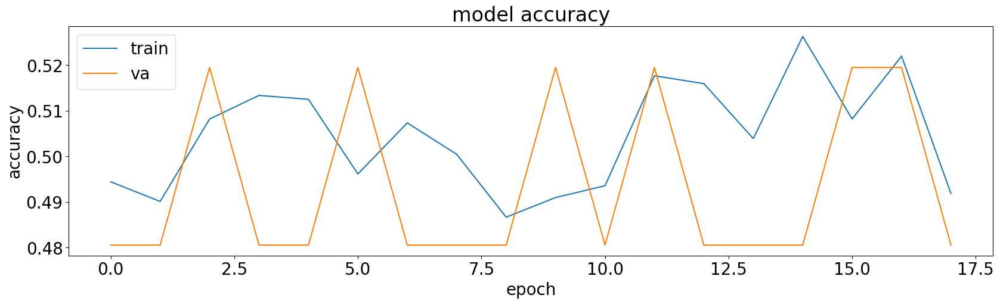

8/8 [==============================] - 1s 13ms/step


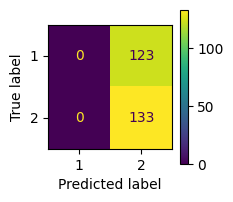

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 1s 13ms/step
| 1         | 0.4214    | 7.251     | 0.07231   | 0.0002287 | 7.442     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


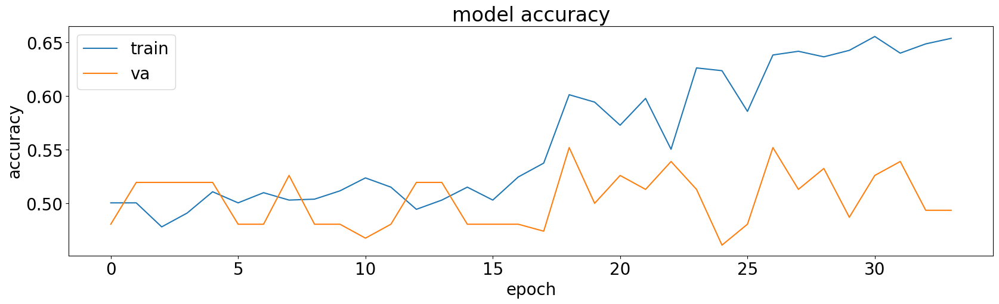

8/8 [==============================] - 3s 308ms/step


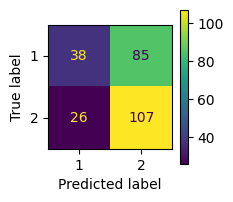

              precision    recall  f1-score   support

           1       0.59      0.31      0.41       123
           2       0.56      0.80      0.66       133

    accuracy                           0.57       256
   macro avg       0.58      0.56      0.53       256
weighted avg       0.57      0.57      0.54       256

5/5 [==============================] - 3s 524ms/step
| 2         | 0.5236    | 6.44      | 0.01014   | 0.3725    | 8.22      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


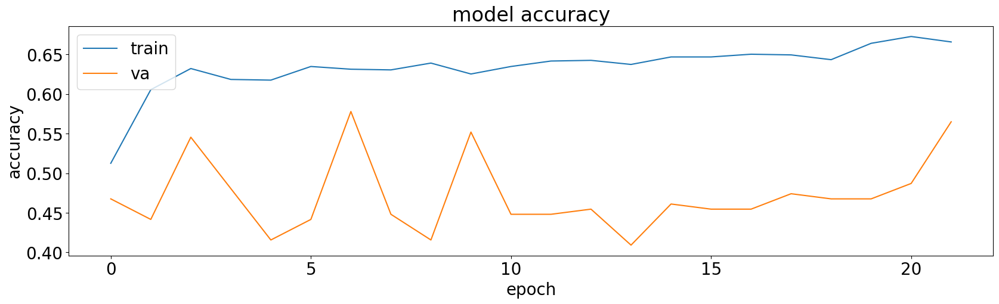

8/8 [==============================] - 1s 19ms/step


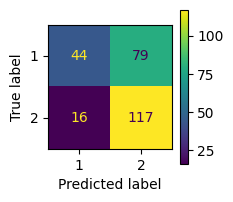

              precision    recall  f1-score   support

           1       0.73      0.36      0.48       123
           2       0.60      0.88      0.71       133

    accuracy                           0.63       256
   macro avg       0.67      0.62      0.60       256
weighted avg       0.66      0.63      0.60       256

5/5 [==============================] - 2s 354ms/step
| 3         | 0.5689    | 7.19      | 0.05434   | 0.8384    | 14.33     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


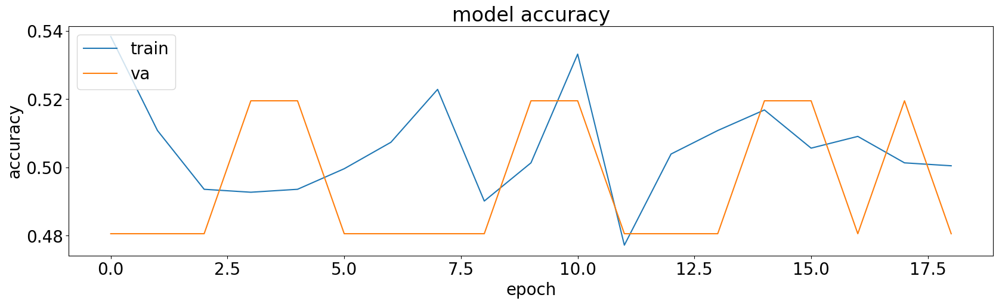

8/8 [==============================] - 1s 19ms/step


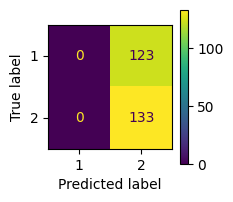

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 353ms/step
| 4         | 0.4214    | 6.613     | 0.08793   | 0.05478   | 14.07     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


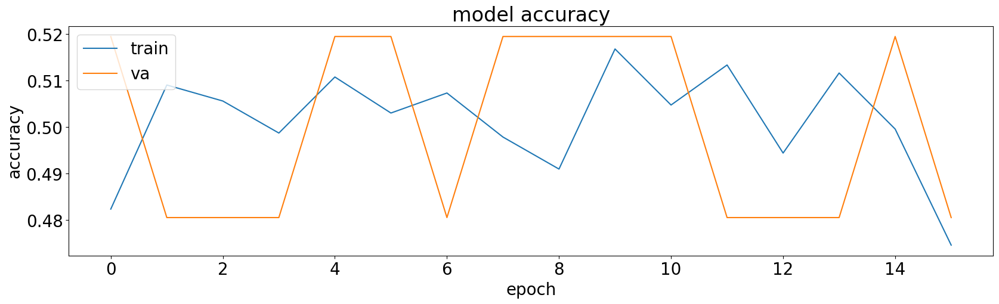

8/8 [==============================] - 3s 301ms/step


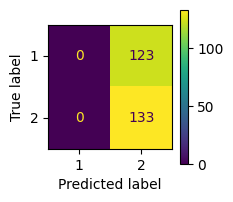

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 3s 491ms/step
| 5         | 0.4214    | 7.252     | 0.05631   | 0.2808    | 5.566     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


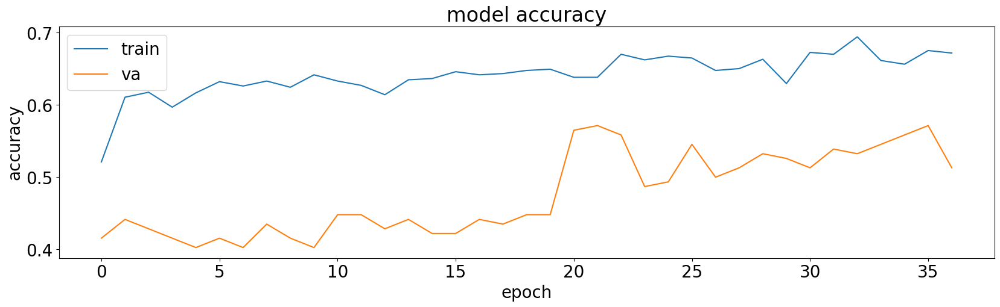

8/8 [==============================] - 3s 301ms/step


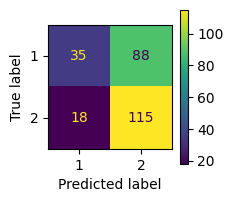

              precision    recall  f1-score   support

           1       0.66      0.28      0.40       123
           2       0.57      0.86      0.68       133

    accuracy                           0.59       256
   macro avg       0.61      0.57      0.54       256
weighted avg       0.61      0.59      0.55       256

5/5 [==============================] - 3s 463ms/step
| 6         | 0.5574    | 8.402     | 0.09686   | 0.6268    | 14.46     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


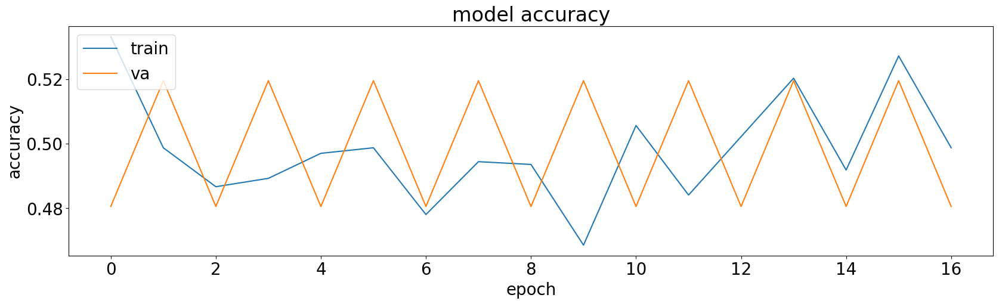

8/8 [==============================] - 1s 11ms/step


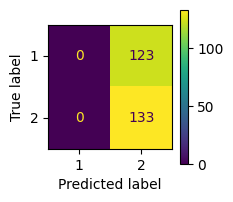

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 362ms/step
| 7         | 0.4214    | 8.629     | 0.08957   | 0.1701    | 2.703     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


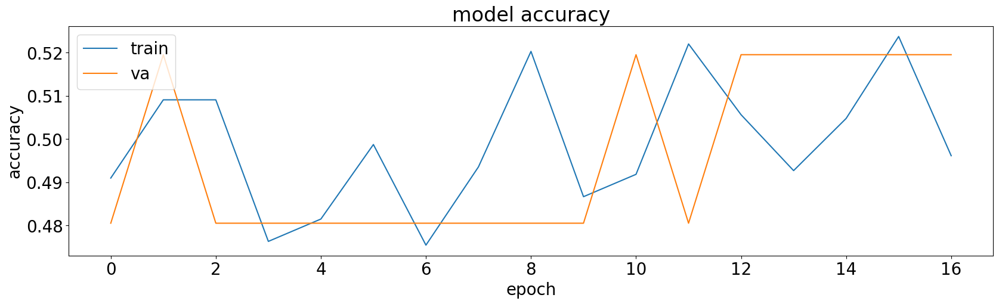

8/8 [==============================] - 1s 17ms/step


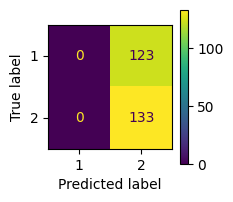

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 291ms/step
| 8         | 0.4214    | 6.509     | 0.08794   | 0.1967    | 9.58      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


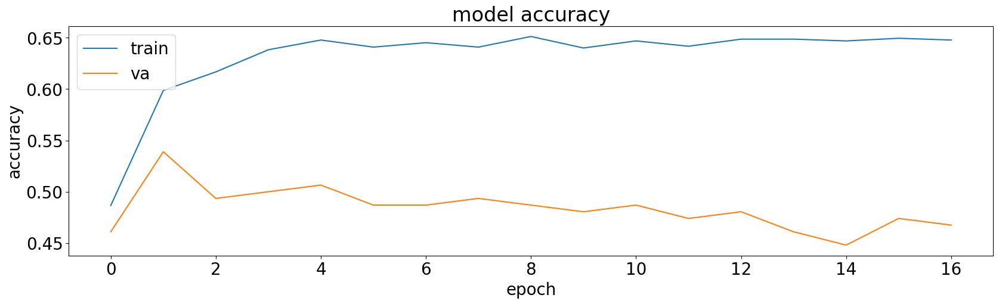

8/8 [==============================] - 1s 13ms/step


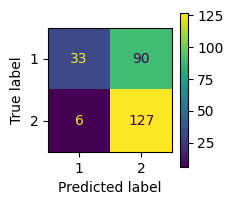

              precision    recall  f1-score   support

           1       0.85      0.27      0.41       123
           2       0.59      0.95      0.73       133

    accuracy                           0.62       256
   macro avg       0.72      0.61      0.57       256
weighted avg       0.71      0.62      0.57       256

5/5 [==============================] - 3s 483ms/step
| 9         | 0.5123    | 8.874     | 0.05378   | 1.384     | 7.679     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


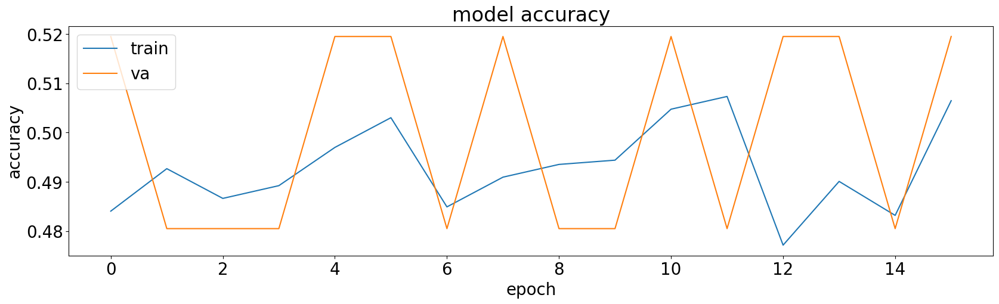

8/8 [==============================] - 3s 301ms/step


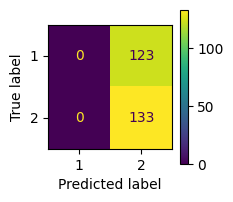

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 373ms/step
| 10        | 0.4214    | 8.06      | 0.08363   | 0.03658   | 15.5      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


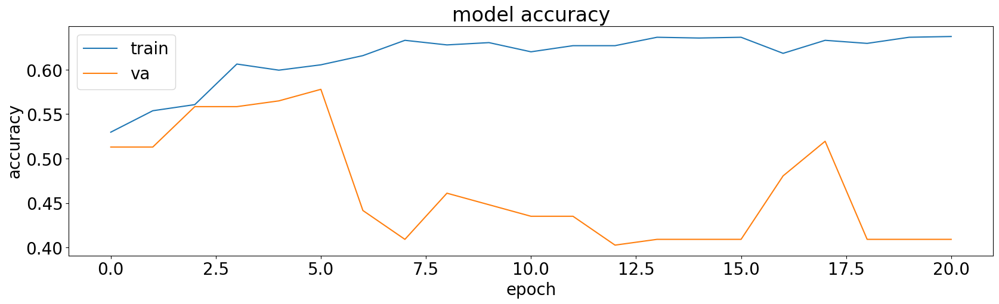

8/8 [==============================] - 1s 20ms/step


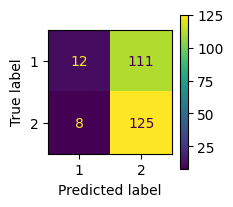

              precision    recall  f1-score   support

           1       0.60      0.10      0.17       123
           2       0.53      0.94      0.68       133

    accuracy                           0.54       256
   macro avg       0.56      0.52      0.42       256
weighted avg       0.56      0.54      0.43       256

5/5 [==============================] - 1s 20ms/step
| 11        | 0.5302    | 8.967     | 0.07507   | 0.5609    | 16.21     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


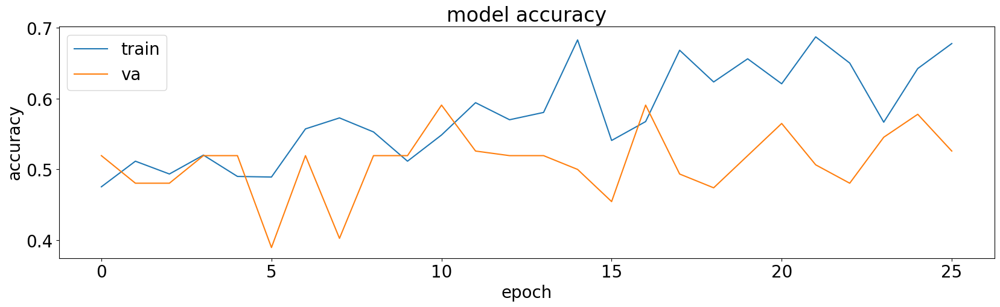

8/8 [==============================] - 3s 295ms/step


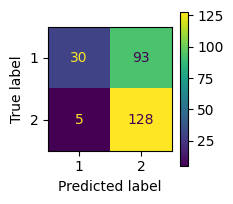

              precision    recall  f1-score   support

           1       0.86      0.24      0.38       123
           2       0.58      0.96      0.72       133

    accuracy                           0.62       256
   macro avg       0.72      0.60      0.55       256
weighted avg       0.71      0.62      0.56       256

5/5 [==============================] - 1s 13ms/step
| 12        | 0.5602    | 6.31      | 0.04534   | 1.817     | 7.285     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


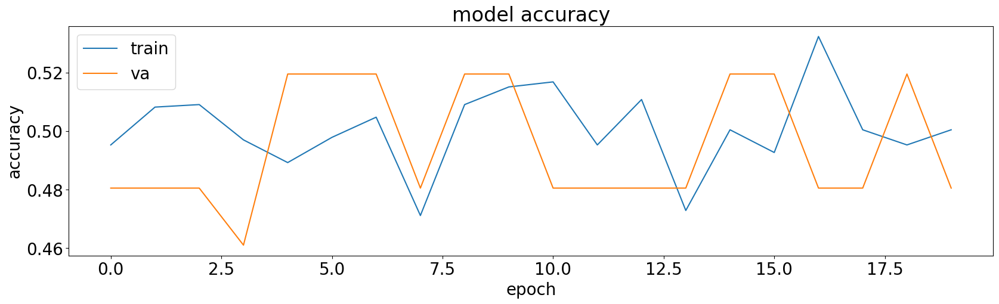

8/8 [==============================] - 3s 305ms/step


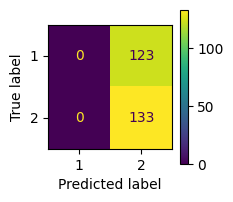

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 535ms/step
| 13        | 0.4214    | 6.863     | 0.01387   | 0.03873   | 14.22     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


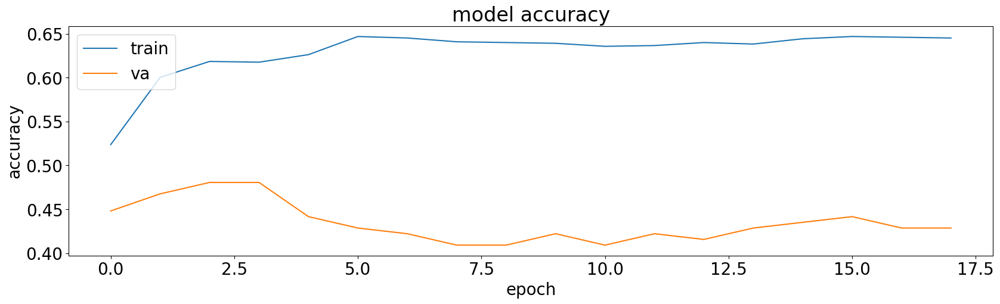

8/8 [==============================] - 3s 283ms/step


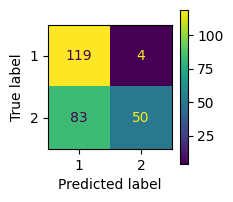

              precision    recall  f1-score   support

           1       0.59      0.97      0.73       123
           2       0.93      0.38      0.53       133

    accuracy                           0.66       256
   macro avg       0.76      0.67      0.63       256
weighted avg       0.76      0.66      0.63       256

5/5 [==============================] - 1s 11ms/step
| 14        | 0.467     | 6.635     | 0.02729   | 0.9831    | 2.961     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


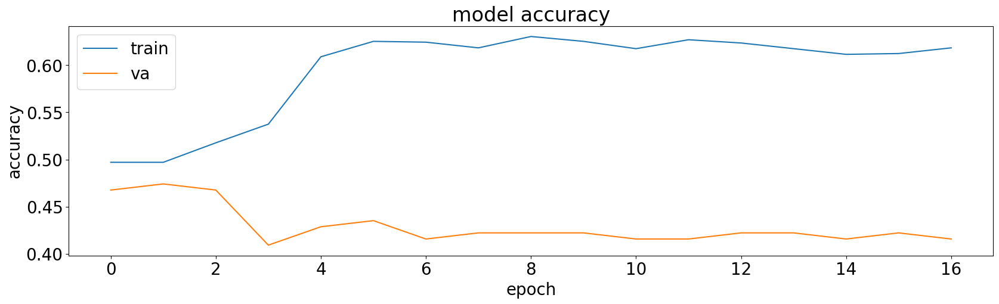

8/8 [==============================] - 2s 219ms/step


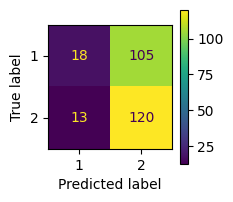

              precision    recall  f1-score   support

           1       0.58      0.15      0.23       123
           2       0.53      0.90      0.67       133

    accuracy                           0.54       256
   macro avg       0.56      0.52      0.45       256
weighted avg       0.56      0.54      0.46       256

5/5 [==============================] - 3s 531ms/step
| 15        | 0.4434    | 7.722     | 0.01553   | 1.179     | 14.6      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


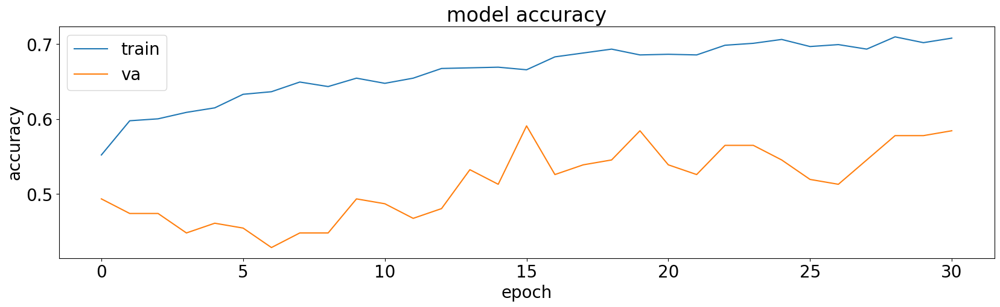

8/8 [==============================] - 2s 195ms/step


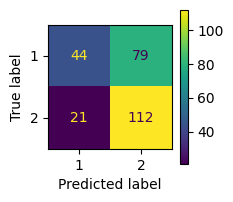

              precision    recall  f1-score   support

           1       0.68      0.36      0.47       123
           2       0.59      0.84      0.69       133

    accuracy                           0.61       256
   macro avg       0.63      0.60      0.58       256
weighted avg       0.63      0.61      0.58       256

5/5 [==============================] - 2s 304ms/step
| 16        | 0.581     | 6.307     | 0.04199   | 1.389     | 9.455     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


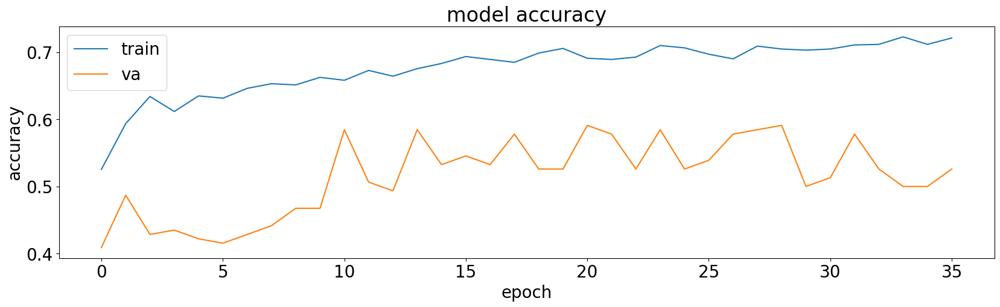

8/8 [==============================] - 3s 294ms/step


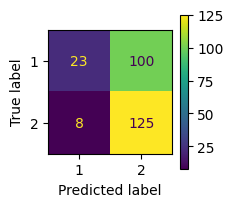

              precision    recall  f1-score   support

           1       0.74      0.19      0.30       123
           2       0.56      0.94      0.70       133

    accuracy                           0.58       256
   macro avg       0.65      0.56      0.50       256
weighted avg       0.65      0.58      0.51       256

5/5 [==============================] - 2s 324ms/step
| 17        | 0.5483    | 6.15      | 0.05405   | 1.328     | 11.27     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


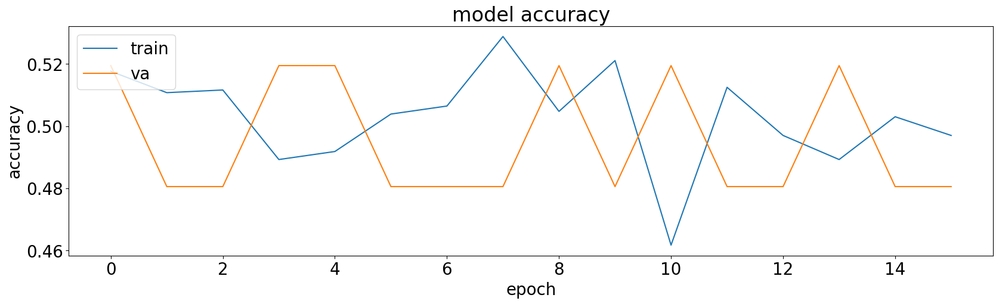

8/8 [==============================] - 2s 223ms/step


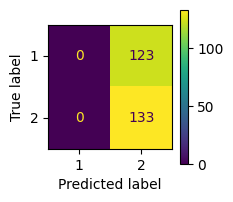

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 12ms/step
| 18        | 0.4214    | 8.834     | 0.05907   | 1.807     | 4.475     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


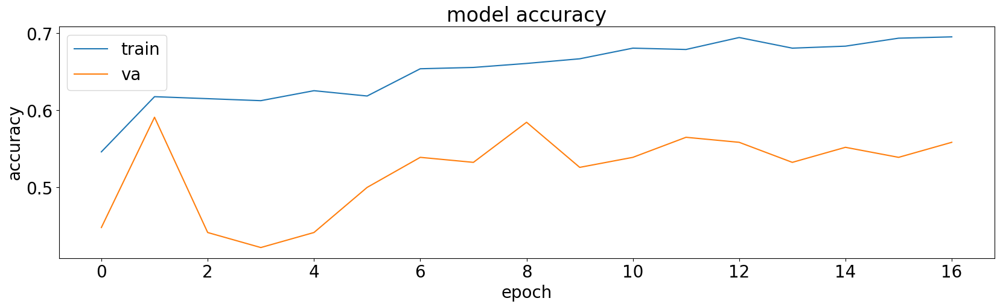

8/8 [==============================] - 3s 281ms/step


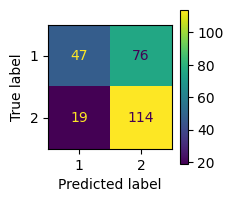

              precision    recall  f1-score   support

           1       0.71      0.38      0.50       123
           2       0.60      0.86      0.71       133

    accuracy                           0.63       256
   macro avg       0.66      0.62      0.60       256
weighted avg       0.65      0.63      0.61       256

5/5 [==============================] - 2s 383ms/step
| 19        | 0.5822    | 6.418     | 0.08093   | 0.7954    | 4.976     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


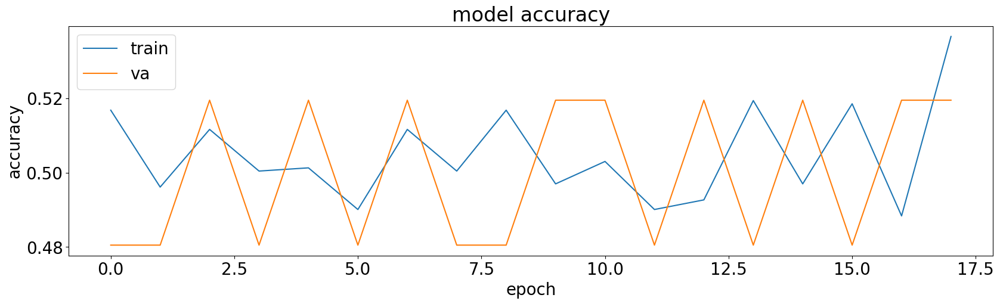

8/8 [==============================] - 1s 20ms/step


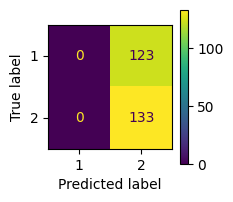

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 1s 20ms/step
| 20        | 0.4214    | 8.783     | 0.03543   | 1.502     | 15.07     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


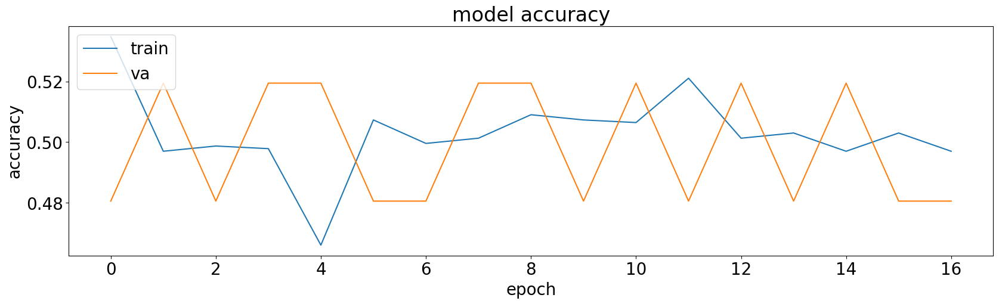

8/8 [==============================] - 3s 376ms/step


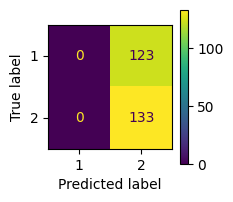

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 316ms/step
| 21        | 0.4214    | 8.65      | 0.06274   | 1.502     | 8.28      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


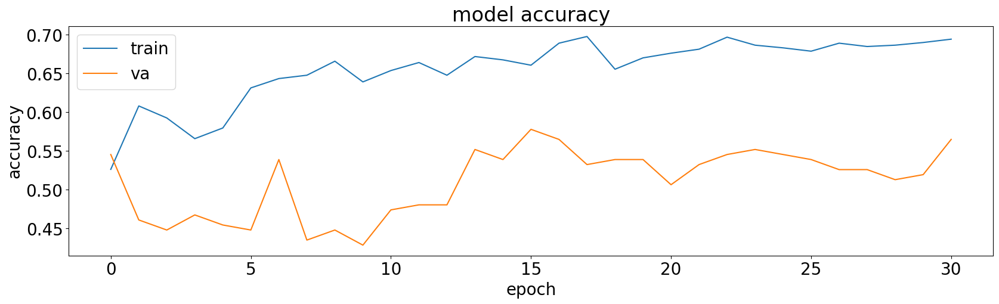

8/8 [==============================] - 2s 177ms/step


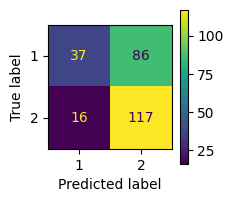

              precision    recall  f1-score   support

           1       0.70      0.30      0.42       123
           2       0.58      0.88      0.70       133

    accuracy                           0.60       256
   macro avg       0.64      0.59      0.56       256
weighted avg       0.63      0.60      0.56       256

5/5 [==============================] - 3s 454ms/step
| 22        | 0.5579    | 6.81      | 0.08969   | 0.8562    | 19.37     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


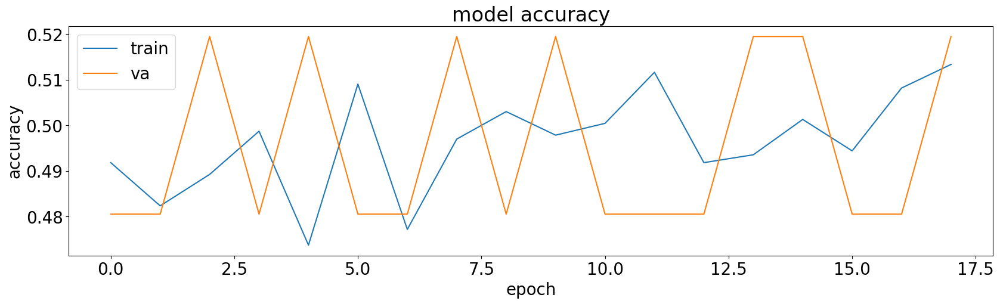

8/8 [==============================] - 3s 306ms/step


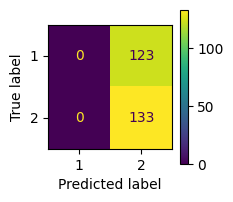

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 455ms/step
| 23        | 0.4214    | 7.99      | 0.06255   | 0.2295    | 19.09     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

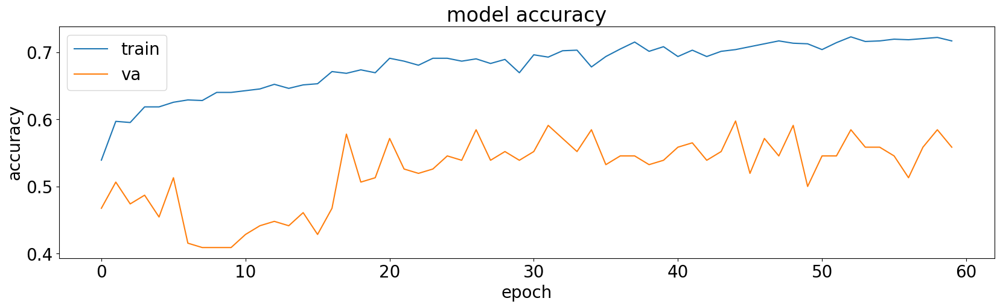

8/8 [==============================] - 3s 300ms/step


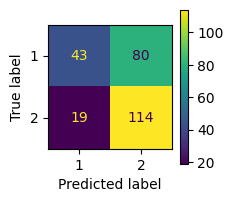

              precision    recall  f1-score   support

           1       0.69      0.35      0.46       123
           2       0.59      0.86      0.70       133

    accuracy                           0.61       256
   macro avg       0.64      0.60      0.58       256
weighted avg       0.64      0.61      0.59       256

5/5 [==============================] - 3s 518ms/step
| 24        | 0.5792    | 7.35      | 0.05826   | 0.8163    | 6.266     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


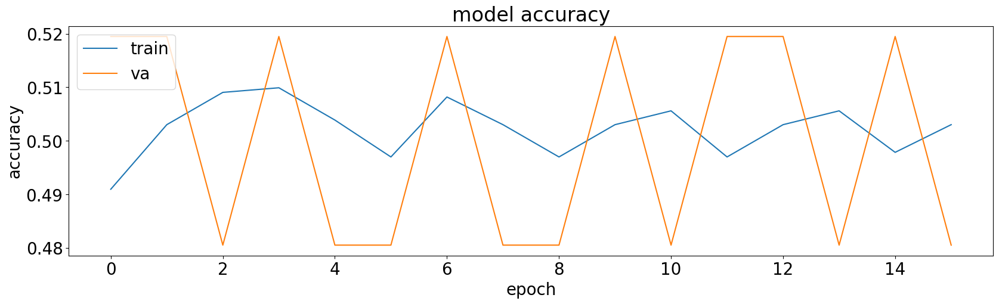

8/8 [==============================] - 3s 298ms/step


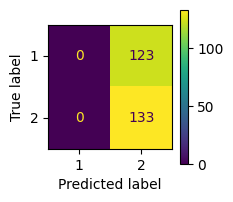

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 434ms/step
| 25        | 0.4214    | 8.71      | 0.05779   | 0.005741  | 13.11     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


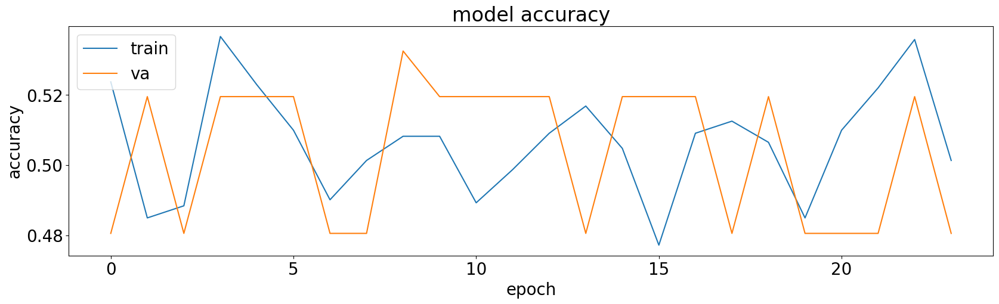

8/8 [==============================] - 2s 201ms/step


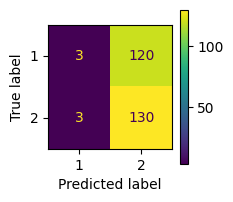

              precision    recall  f1-score   support

           1       0.50      0.02      0.05       123
           2       0.52      0.98      0.68       133

    accuracy                           0.52       256
   macro avg       0.51      0.50      0.36       256
weighted avg       0.51      0.52      0.38       256

5/5 [==============================] - 3s 444ms/step
| 26        | 0.4625    | 6.98      | 0.05318   | 1.772     | 8.431     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


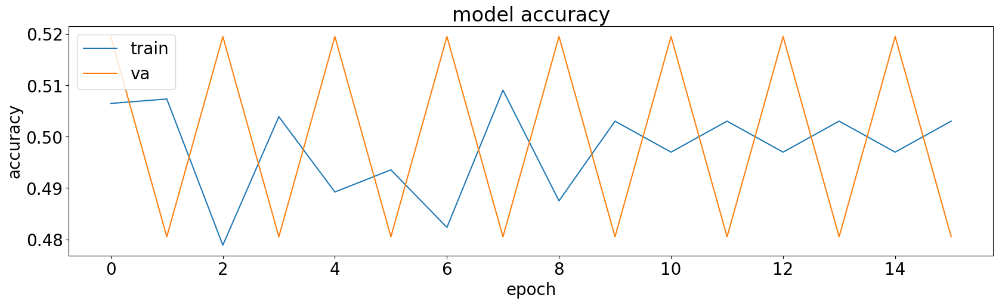

8/8 [==============================] - 2s 223ms/step


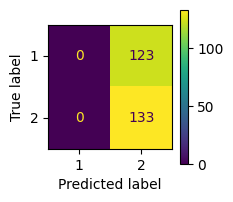

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 443ms/step
| 27        | 0.4214    | 8.726     | 0.06271   | 0.03164   | 18.73     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


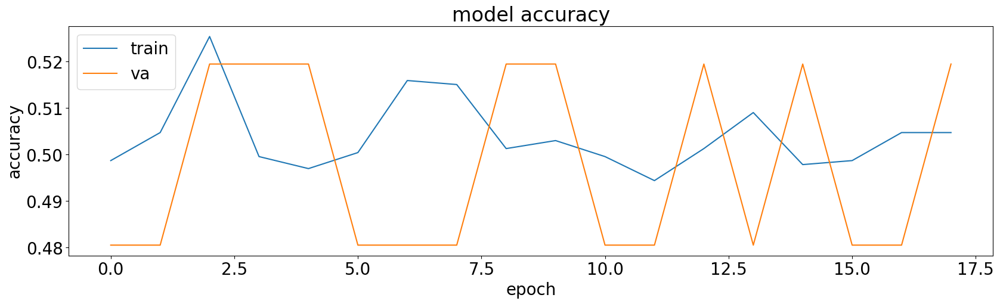

8/8 [==============================] - 3s 278ms/step


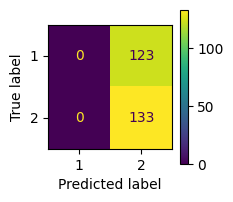

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 460ms/step
| 28        | 0.4214    | 8.073     | 0.09973   | 0.3447    | 4.468     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


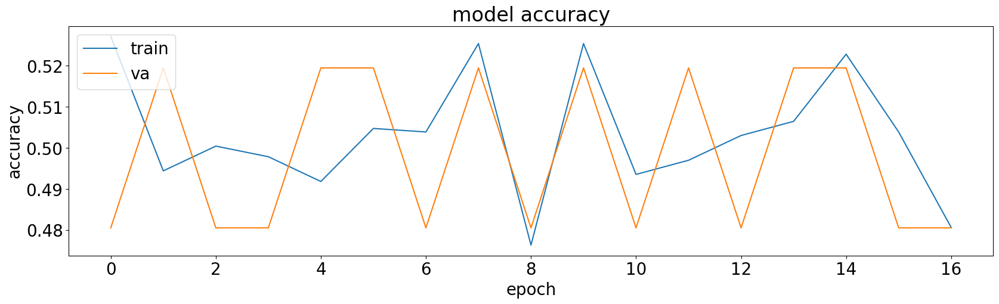

8/8 [==============================] - 3s 317ms/step


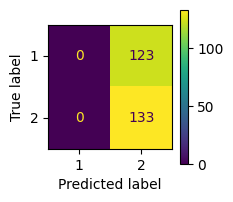

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 511ms/step
| 29        | 0.4214    | 8.798     | 0.06998   | 0.132     | 15.6      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


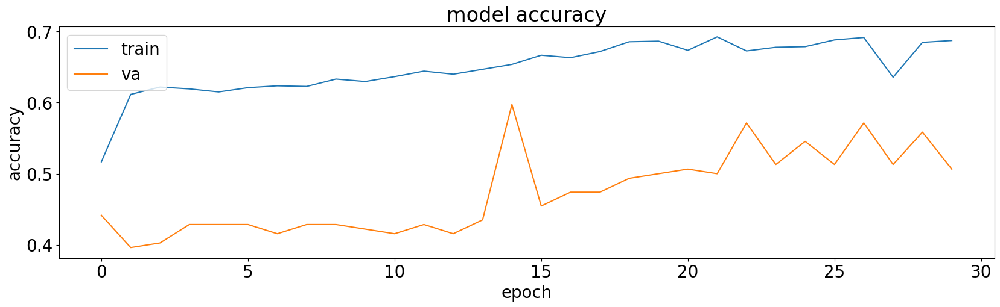

8/8 [==============================] - 3s 308ms/step


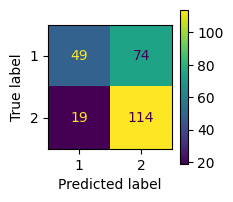

              precision    recall  f1-score   support

           1       0.72      0.40      0.51       123
           2       0.61      0.86      0.71       133

    accuracy                           0.64       256
   macro avg       0.66      0.63      0.61       256
weighted avg       0.66      0.64      0.62       256

5/5 [==============================] - 2s 379ms/step
| 30        | 0.5882    | 8.262     | 0.09238   | 1.423     | 4.237     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


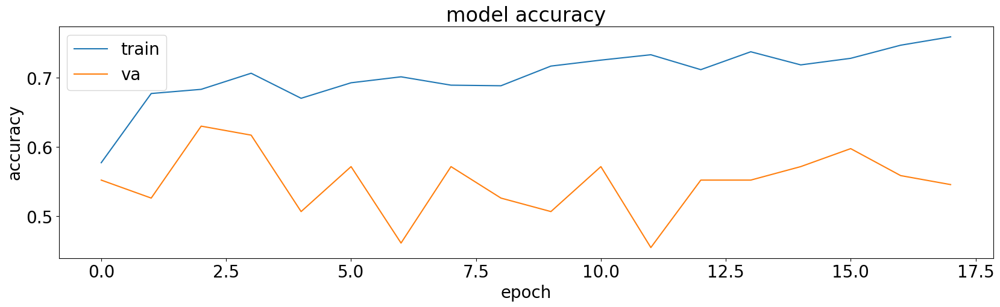

8/8 [==============================] - 3s 282ms/step


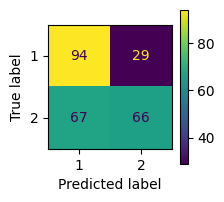

              precision    recall  f1-score   support

           1       0.58      0.76      0.66       123
           2       0.69      0.50      0.58       133

    accuracy                           0.62       256
   macro avg       0.64      0.63      0.62       256
weighted avg       0.64      0.62      0.62       256

5/5 [==============================] - 3s 463ms/step
| 31        | 0.6289    | 6.06      | 0.003595  | 0.05661   | 6.432     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


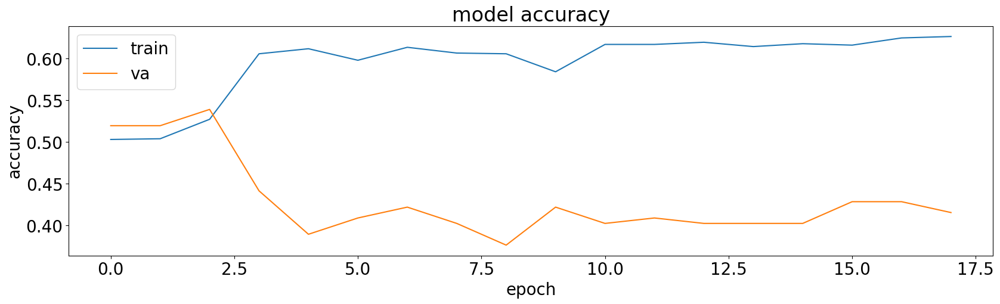

8/8 [==============================] - 3s 301ms/step


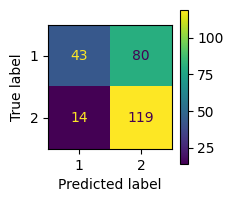

              precision    recall  f1-score   support

           1       0.75      0.35      0.48       123
           2       0.60      0.89      0.72       133

    accuracy                           0.63       256
   macro avg       0.68      0.62      0.60       256
weighted avg       0.67      0.63      0.60       256

5/5 [==============================] - 3s 460ms/step
| 32        | 0.5327    | 8.58      | 0.05434   | 1.106     | 17.16     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


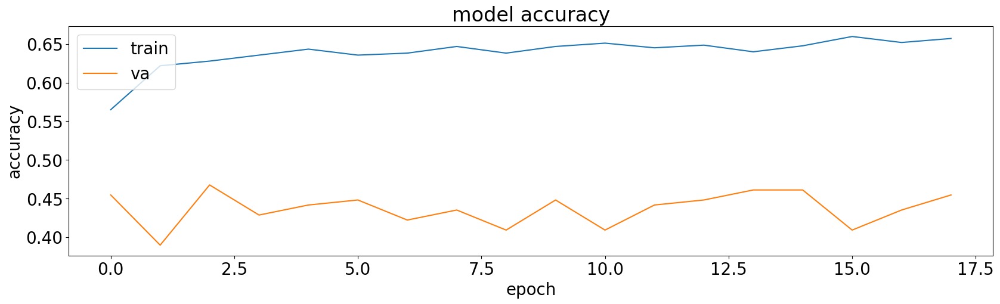

8/8 [==============================] - 1s 26ms/step


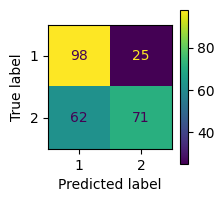

              precision    recall  f1-score   support

           1       0.61      0.80      0.69       123
           2       0.74      0.53      0.62       133

    accuracy                           0.66       256
   macro avg       0.68      0.67      0.66       256
weighted avg       0.68      0.66      0.65       256

5/5 [==============================] - 3s 527ms/step
| 33        | 0.4659    | 6.373     | 0.02864   | 1.172     | 19.45     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


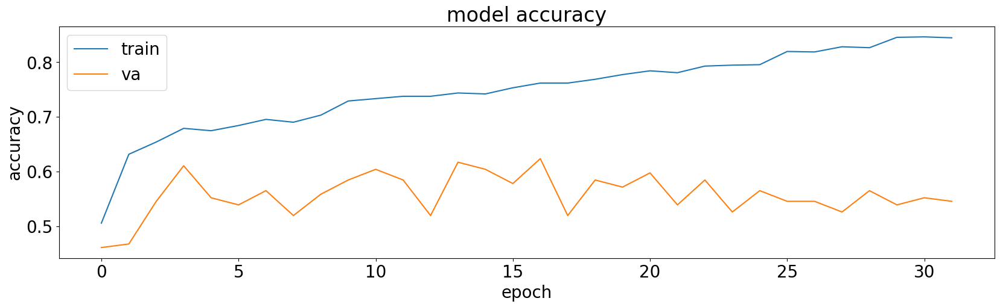

8/8 [==============================] - 3s 300ms/step


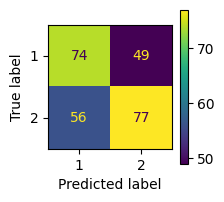

              precision    recall  f1-score   support

           1       0.57      0.60      0.58       123
           2       0.61      0.58      0.59       133

    accuracy                           0.59       256
   macro avg       0.59      0.59      0.59       256
weighted avg       0.59      0.59      0.59       256

5/5 [==============================] - 3s 466ms/step
| 34        | 0.6229    | 7.683     | 0.002846  | 1.601     | 6.194     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


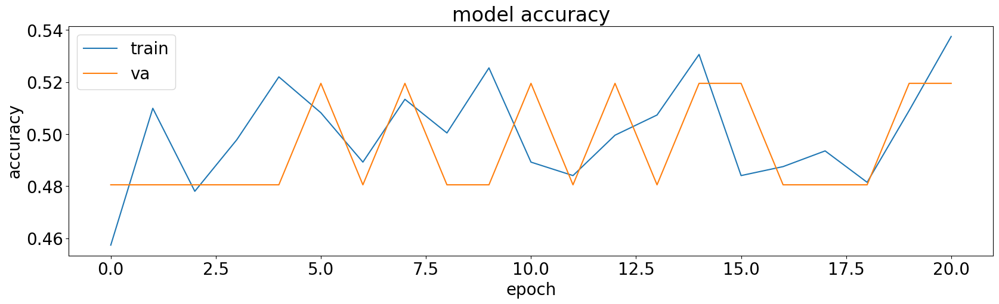

8/8 [==============================] - 3s 301ms/step


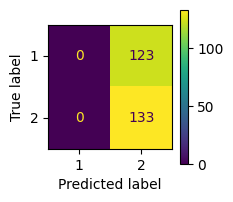

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 464ms/step
| 35        | 0.4214    | 8.421     | 0.0394    | 1.727     | 15.45     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


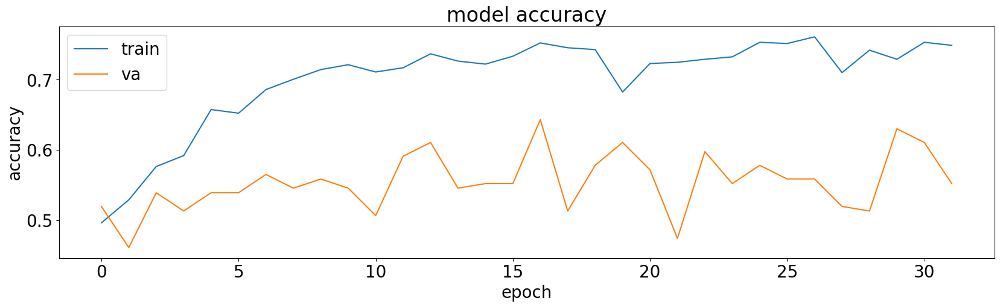

8/8 [==============================] - 1s 12ms/step


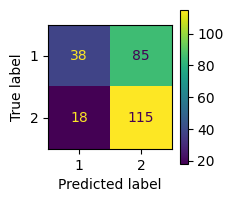

              precision    recall  f1-score   support

           1       0.68      0.31      0.42       123
           2       0.57      0.86      0.69       133

    accuracy                           0.60       256
   macro avg       0.63      0.59      0.56       256
weighted avg       0.62      0.60      0.56       256

5/5 [==============================] - 3s 489ms/step
| 36        | 0.6291    | 7.669     | 0.01451   | 0.1198    | 4.184     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


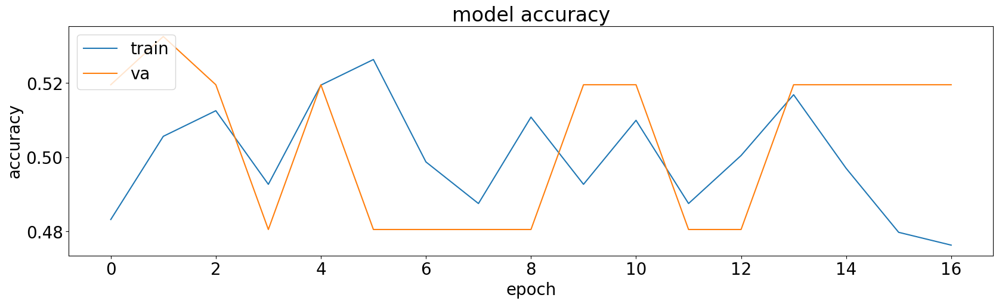

8/8 [==============================] - 1s 20ms/step


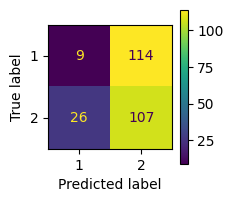

              precision    recall  f1-score   support

           1       0.26      0.07      0.11       123
           2       0.48      0.80      0.60       133

    accuracy                           0.45       256
   macro avg       0.37      0.44      0.36       256
weighted avg       0.38      0.45      0.37       256

5/5 [==============================] - 1s 20ms/step
| 37        | 0.4812    | 6.134     | 0.01164   | 0.4514    | 14.83     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

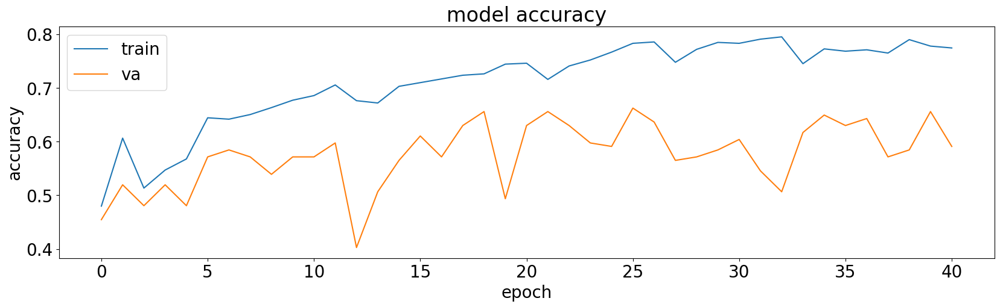

8/8 [==============================] - 1s 26ms/step


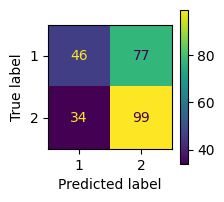

              precision    recall  f1-score   support

           1       0.57      0.37      0.45       123
           2       0.56      0.74      0.64       133

    accuracy                           0.57       256
   macro avg       0.57      0.56      0.55       256
weighted avg       0.57      0.57      0.55       256

5/5 [==============================] - 1s 25ms/step
| 38        | 0.6574    | 7.679     | 0.002243  | 0.1439    | 19.41     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


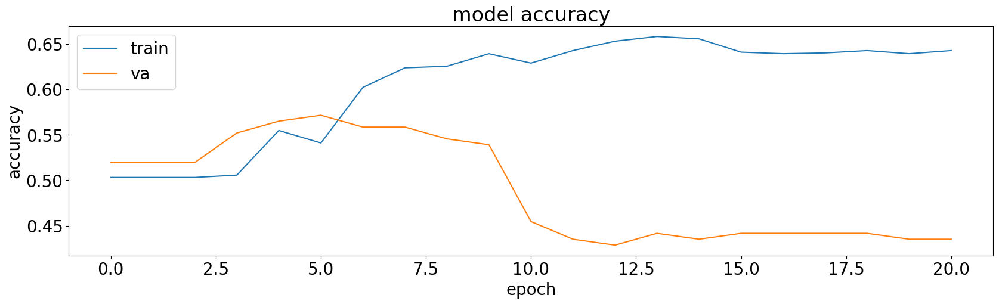

8/8 [==============================] - 3s 298ms/step


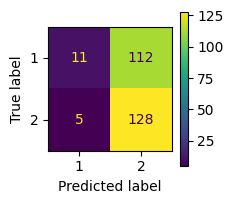

              precision    recall  f1-score   support

           1       0.69      0.09      0.16       123
           2       0.53      0.96      0.69       133

    accuracy                           0.54       256
   macro avg       0.61      0.53      0.42       256
weighted avg       0.61      0.54      0.43       256

5/5 [==============================] - 2s 446ms/step
| 39        | 0.5169    | 7.704     | 0.02113   | 0.5047    | 15.39     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


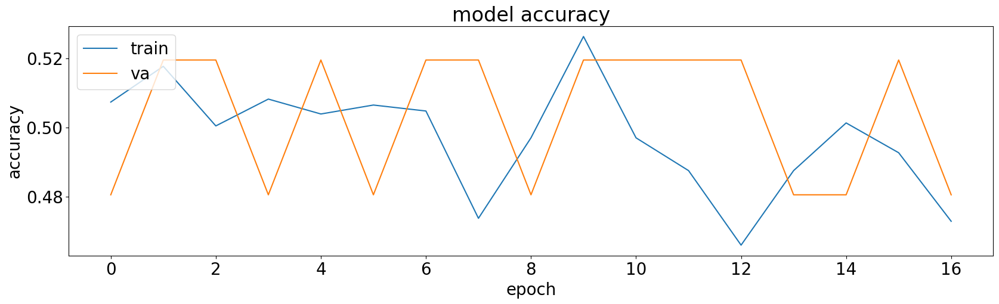

8/8 [==============================] - 2s 224ms/step


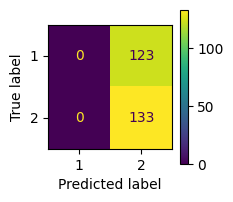

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 439ms/step
| 40        | 0.4214    | 6.586     | 0.05855   | 1.94      | 17.24     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

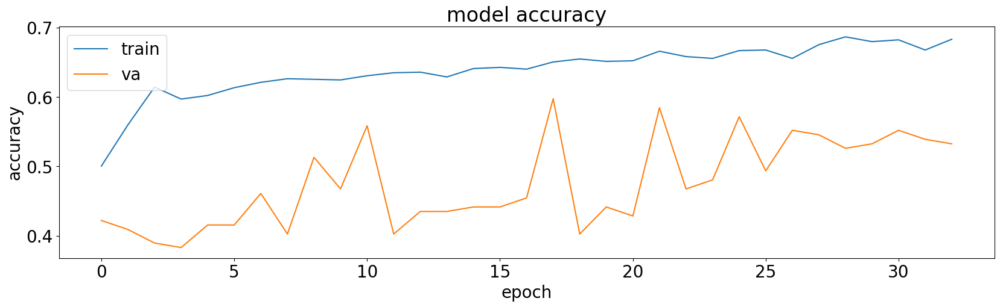

8/8 [==============================] - 3s 274ms/step


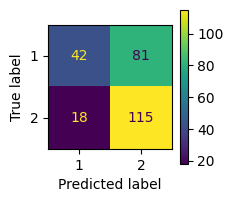

              precision    recall  f1-score   support

           1       0.70      0.34      0.46       123
           2       0.59      0.86      0.70       133

    accuracy                           0.61       256
   macro avg       0.64      0.60      0.58       256
weighted avg       0.64      0.61      0.58       256

5/5 [==============================] - 2s 429ms/step
| 41        | 0.5882    | 6.72      | 0.04988   | 1.24      | 16.92     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


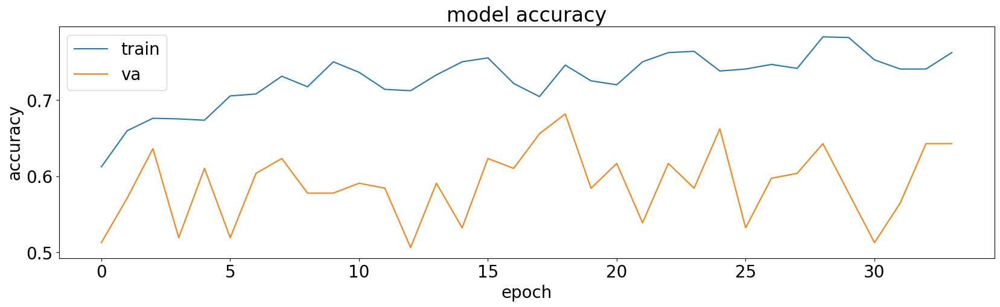

8/8 [==============================] - 3s 308ms/step


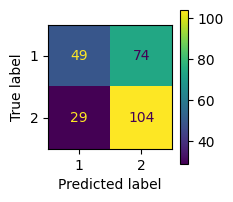

              precision    recall  f1-score   support

           1       0.63      0.40      0.49       123
           2       0.58      0.78      0.67       133

    accuracy                           0.60       256
   macro avg       0.61      0.59      0.58       256
weighted avg       0.61      0.60      0.58       256

5/5 [==============================] - 3s 537ms/step
| 42        | 0.6731    | 6.47      | 0.002839  | 0.14      | 10.75     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


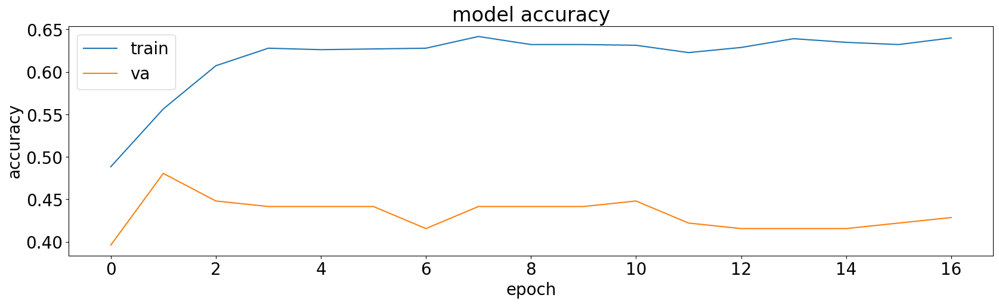

8/8 [==============================] - 1s 27ms/step


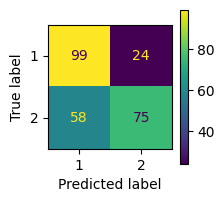

              precision    recall  f1-score   support

           1       0.63      0.80      0.71       123
           2       0.76      0.56      0.65       133

    accuracy                           0.68       256
   macro avg       0.69      0.68      0.68       256
weighted avg       0.70      0.68      0.68       256

5/5 [==============================] - 1s 29ms/step
| 43        | 0.4769    | 7.819     | 0.05732   | 0.6347    | 19.8      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


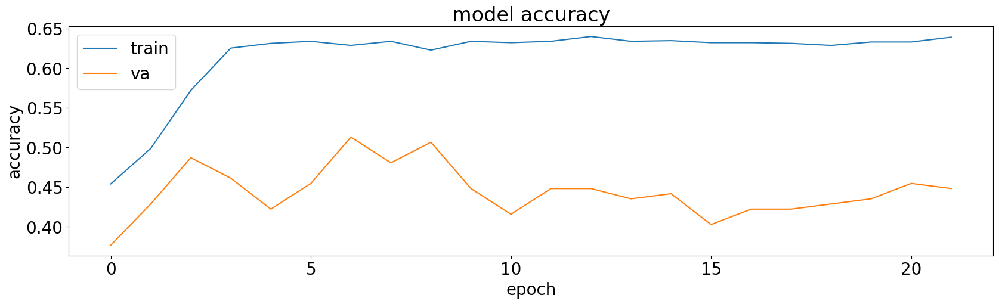

8/8 [==============================] - 3s 306ms/step


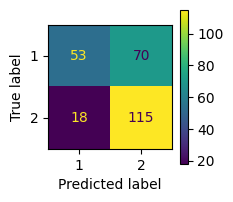

              precision    recall  f1-score   support

           1       0.75      0.43      0.55       123
           2       0.62      0.86      0.72       133

    accuracy                           0.66       256
   macro avg       0.68      0.65      0.63       256
weighted avg       0.68      0.66      0.64       256

5/5 [==============================] - 3s 503ms/step
| 44        | 0.5084    | 7.739     | 0.03863   | 1.102     | 15.42     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


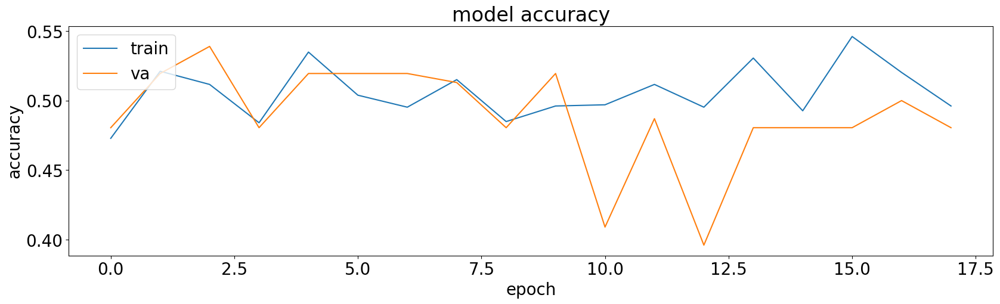

8/8 [==============================] - 2s 253ms/step


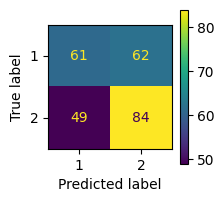

              precision    recall  f1-score   support

           1       0.55      0.50      0.52       123
           2       0.58      0.63      0.60       133

    accuracy                           0.57       256
   macro avg       0.56      0.56      0.56       256
weighted avg       0.57      0.57      0.56       256

5/5 [==============================] - 3s 376ms/step
| 45        | 0.5361    | 8.008     | 0.02723   | 0.1327    | 8.662     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


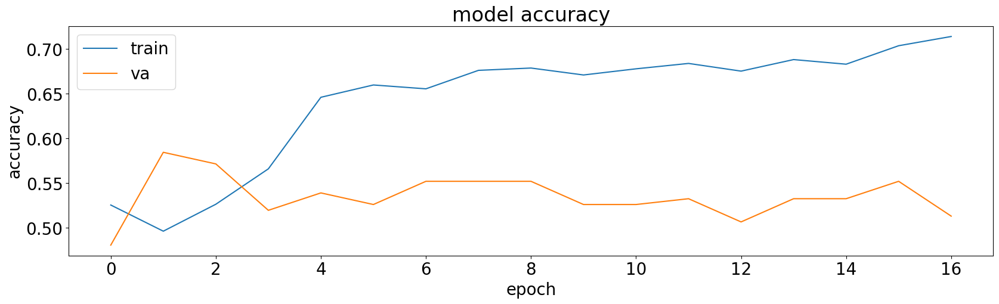

8/8 [==============================] - 3s 299ms/step


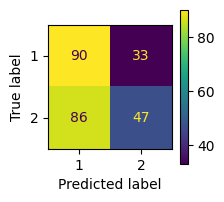

              precision    recall  f1-score   support

           1       0.51      0.73      0.60       123
           2       0.59      0.35      0.44       133

    accuracy                           0.54       256
   macro avg       0.55      0.54      0.52       256
weighted avg       0.55      0.54      0.52       256

5/5 [==============================] - 1s 11ms/step
| 46        | 0.5815    | 7.889     | 0.02181   | 1.506     | 3.198     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


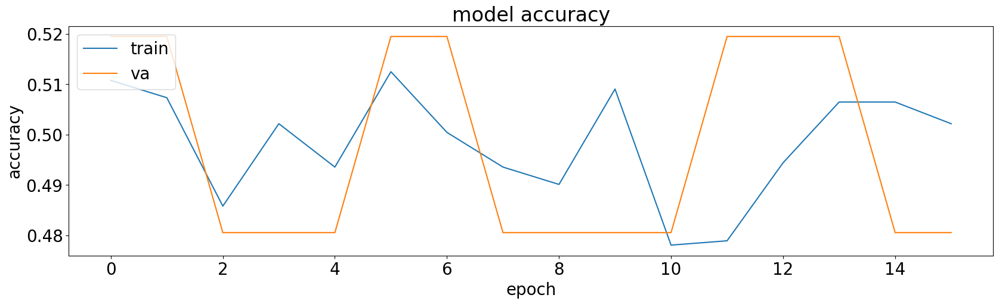

8/8 [==============================] - 3s 296ms/step


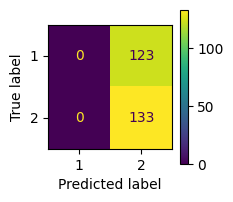

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 454ms/step
| 47        | 0.4214    | 6.781     | 0.08067   | 0.3869    | 13.51     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


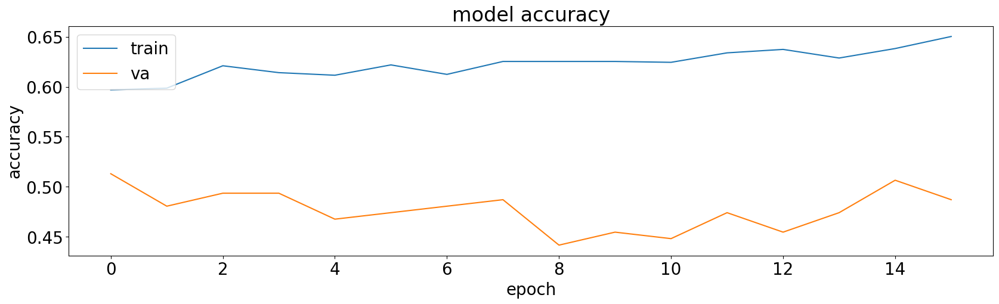

8/8 [==============================] - 1s 11ms/step


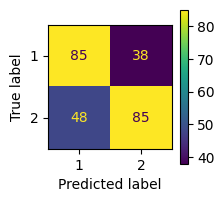

              precision    recall  f1-score   support

           1       0.64      0.69      0.66       123
           2       0.69      0.64      0.66       133

    accuracy                           0.66       256
   macro avg       0.67      0.67      0.66       256
weighted avg       0.67      0.66      0.66       256

5/5 [==============================] - 1s 11ms/step
| 48        | 0.5129    | 7.574     | 0.09256   | 0.5266    | 3.187     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


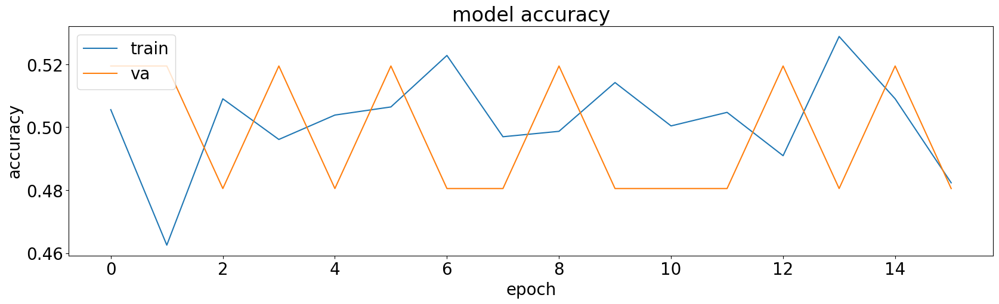

8/8 [==============================] - 3s 315ms/step


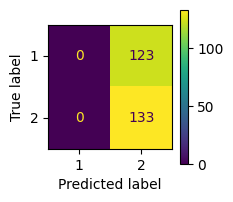

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 446ms/step
| 49        | 0.4214    | 8.205     | 0.07745   | 1.816     | 18.78     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

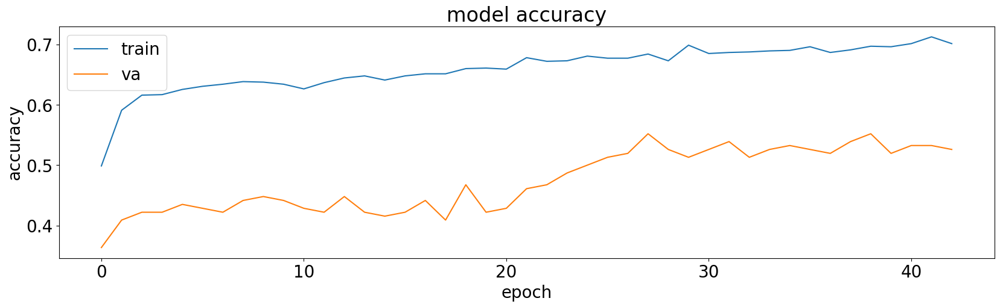

8/8 [==============================] - 3s 311ms/step


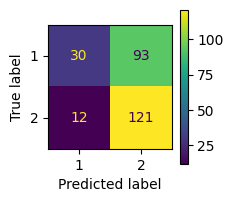

              precision    recall  f1-score   support

           1       0.71      0.24      0.36       123
           2       0.57      0.91      0.70       133

    accuracy                           0.59       256
   macro avg       0.64      0.58      0.53       256
weighted avg       0.64      0.59      0.54       256

5/5 [==============================] - 3s 622ms/step
| 50        | 0.5236    | 6.042     | 0.0242    | 1.234     | 19.08     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


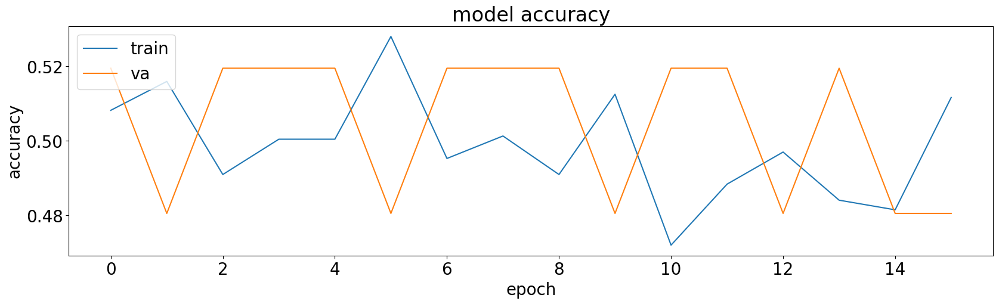

8/8 [==============================] - 3s 313ms/step


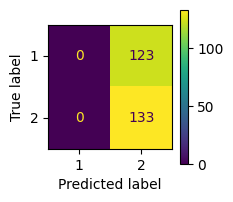

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 443ms/step
| 51        | 0.4214    | 7.754     | 0.06989   | 0.1439    | 19.48     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


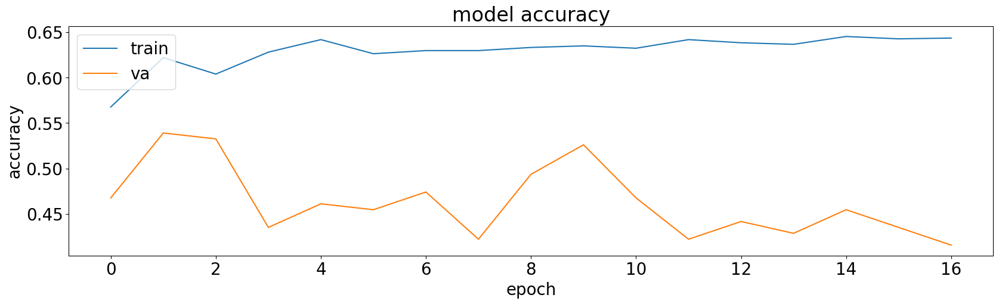

8/8 [==============================] - 3s 310ms/step


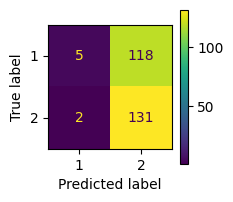

              precision    recall  f1-score   support

           1       0.71      0.04      0.08       123
           2       0.53      0.98      0.69       133

    accuracy                           0.53       256
   macro avg       0.62      0.51      0.38       256
weighted avg       0.62      0.53      0.39       256

5/5 [==============================] - 2s 292ms/step
| 52        | 0.4727    | 7.328     | 0.04193   | 1.096     | 15.4      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


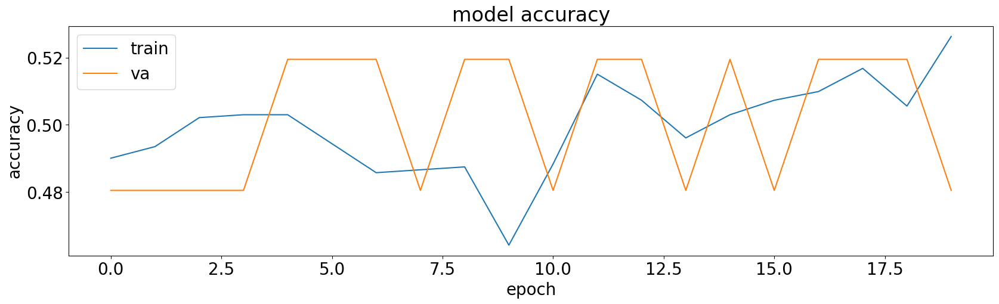

8/8 [==============================] - 2s 206ms/step


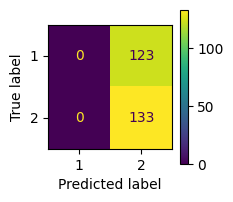

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 447ms/step
| 53        | 0.4214    | 7.87      | 0.0231    | 1.918     | 16.48     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


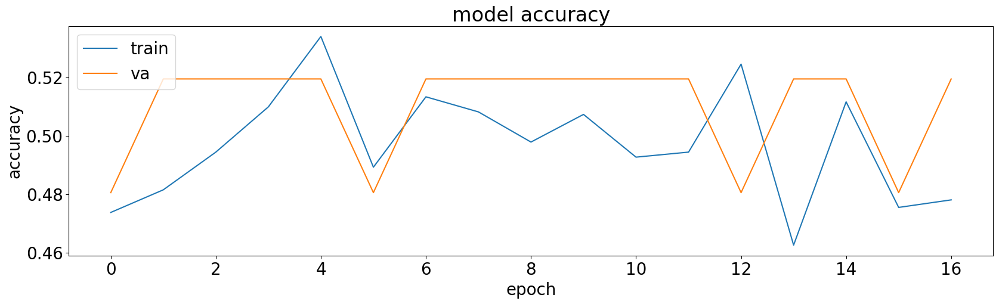

8/8 [==============================] - 2s 210ms/step


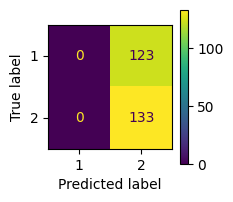

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 444ms/step
| 54        | 0.4214    | 6.064     | 0.08098   | 1.93      | 14.64     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

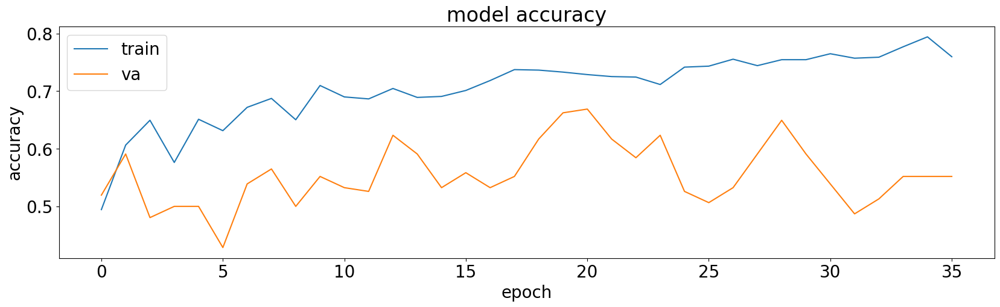

8/8 [==============================] - 3s 297ms/step


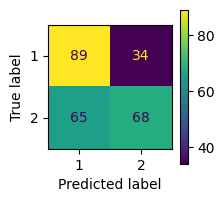

              precision    recall  f1-score   support

           1       0.58      0.72      0.64       123
           2       0.67      0.51      0.58       133

    accuracy                           0.61       256
   macro avg       0.62      0.62      0.61       256
weighted avg       0.62      0.61      0.61       256

5/5 [==============================] - 2s 434ms/step
| 55        | 0.665     | 7.093     | 0.003217  | 0.3048    | 19.49     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


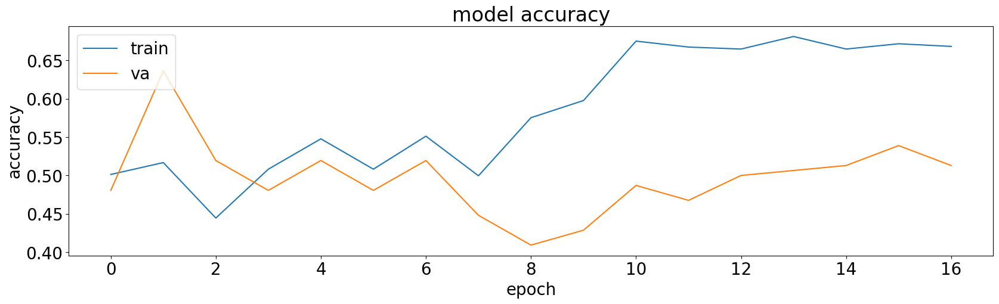

8/8 [==============================] - 2s 212ms/step


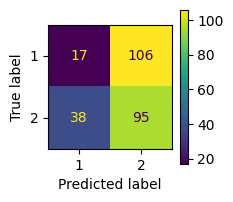

              precision    recall  f1-score   support

           1       0.31      0.14      0.19       123
           2       0.47      0.71      0.57       133

    accuracy                           0.44       256
   macro avg       0.39      0.43      0.38       256
weighted avg       0.39      0.44      0.39       256

5/5 [==============================] - 3s 615ms/step
| 56        | 0.6318    | 8.986     | 0.03319   | 1.634     | 2.803     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


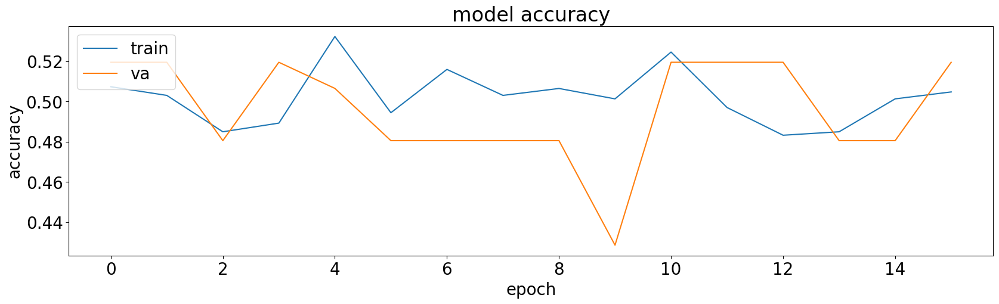

8/8 [==============================] - 3s 288ms/step


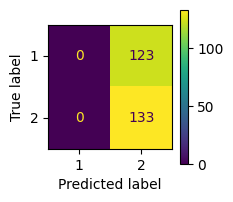

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 480ms/step
| 57        | 0.4214    | 8.944     | 0.02777   | 1.618     | 10.04     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


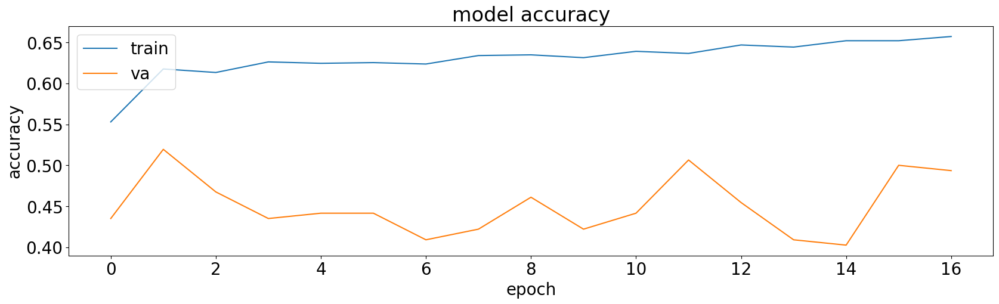

8/8 [==============================] - 1s 21ms/step


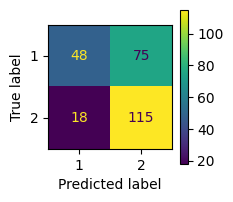

              precision    recall  f1-score   support

           1       0.73      0.39      0.51       123
           2       0.61      0.86      0.71       133

    accuracy                           0.64       256
   macro avg       0.67      0.63      0.61       256
weighted avg       0.66      0.64      0.61       256

5/5 [==============================] - 3s 521ms/step
| 58        | 0.5124    | 6.975     | 0.06394   | 0.801     | 15.53     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


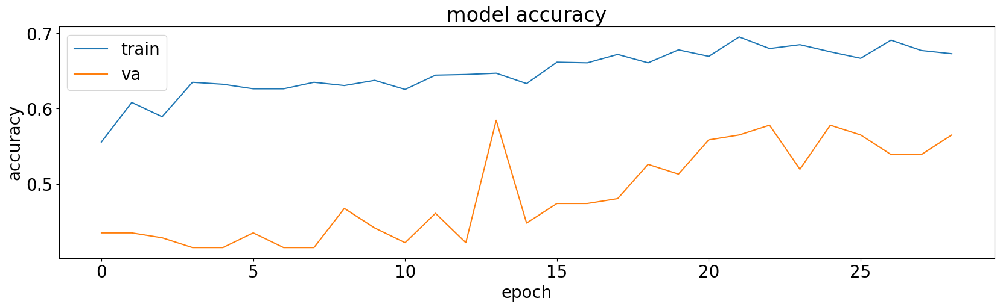

8/8 [==============================] - 1s 13ms/step


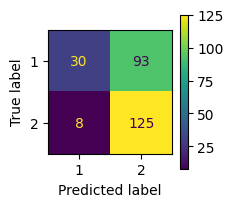

              precision    recall  f1-score   support

           1       0.79      0.24      0.37       123
           2       0.57      0.94      0.71       133

    accuracy                           0.61       256
   macro avg       0.68      0.59      0.54       256
weighted avg       0.68      0.61      0.55       256

5/5 [==============================] - 2s 352ms/step
| 59        | 0.5545    | 6.918     | 0.06799   | 1.103     | 7.685     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


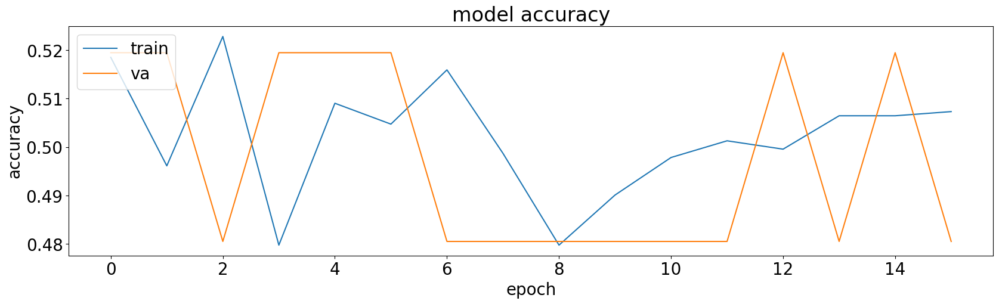

8/8 [==============================] - 3s 297ms/step


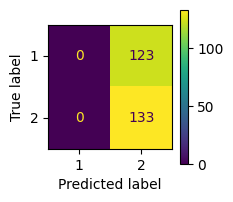

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 417ms/step
| 60        | 0.4214    | 7.192     | 0.02022   | 0.1057    | 8.209     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


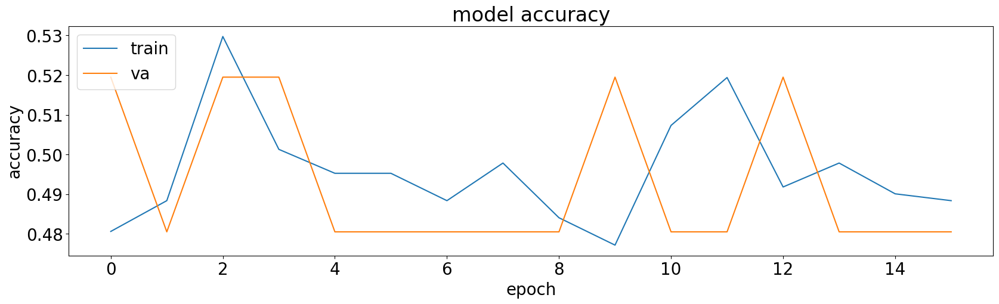

8/8 [==============================] - 3s 296ms/step


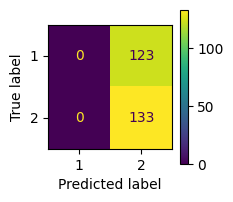

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 444ms/step
| 61        | 0.4214    | 6.028     | 0.05547   | 0.324     | 10.6      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


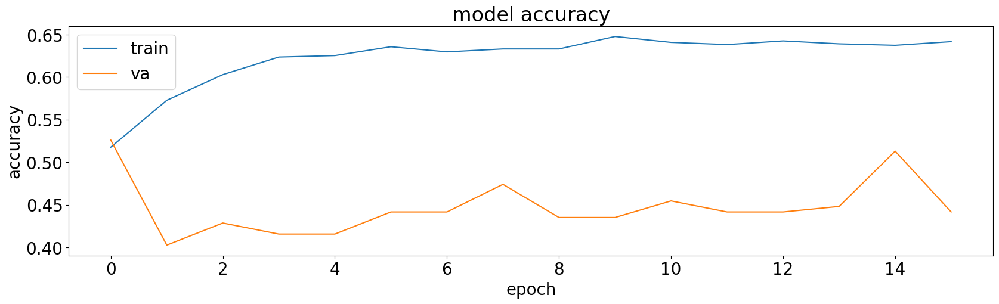

8/8 [==============================] - 3s 297ms/step


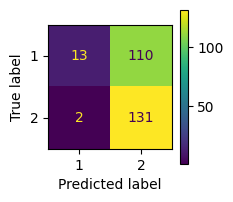

              precision    recall  f1-score   support

           1       0.87      0.11      0.19       123
           2       0.54      0.98      0.70       133

    accuracy                           0.56       256
   macro avg       0.71      0.55      0.44       256
weighted avg       0.70      0.56      0.45       256

5/5 [==============================] - 2s 290ms/step
| 62        | 0.4626    | 6.997     | 0.04899   | 0.8337    | 16.77     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


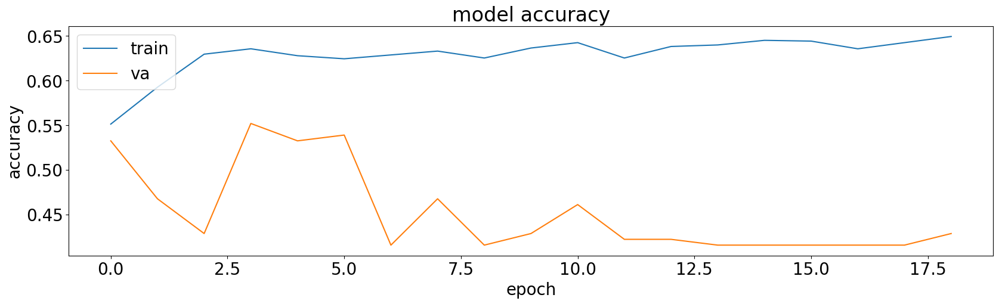

8/8 [==============================] - 2s 229ms/step


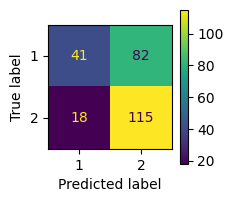

              precision    recall  f1-score   support

           1       0.69      0.33      0.45       123
           2       0.58      0.86      0.70       133

    accuracy                           0.61       256
   macro avg       0.64      0.60      0.57       256
weighted avg       0.64      0.61      0.58       256

5/5 [==============================] - 2s 443ms/step
| 63        | 0.5411    | 6.702     | 0.04525   | 1.1       | 19.09     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

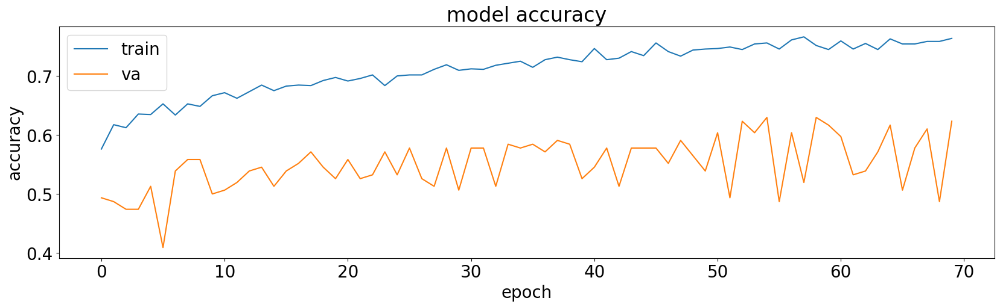

8/8 [==============================] - 2s 219ms/step


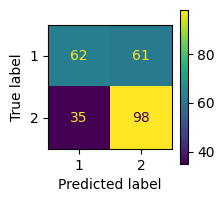

              precision    recall  f1-score   support

           1       0.64      0.50      0.56       123
           2       0.62      0.74      0.67       133

    accuracy                           0.62       256
   macro avg       0.63      0.62      0.62       256
weighted avg       0.63      0.62      0.62       256

5/5 [==============================] - 3s 483ms/step
| 64        | 0.6264    | 6.354     | 0.0555    | 0.9829    | 4.627     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

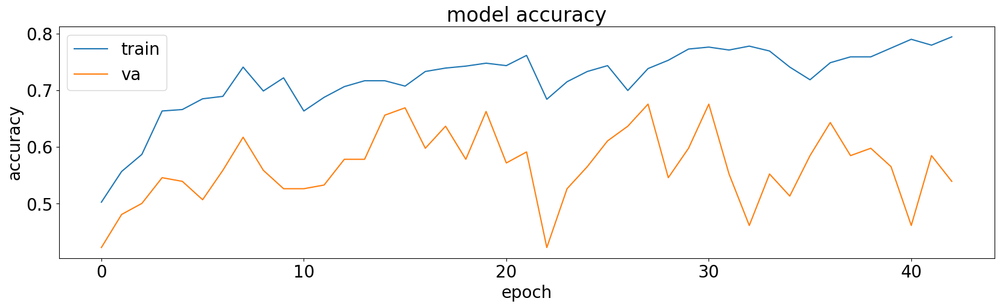

8/8 [==============================] - 3s 300ms/step


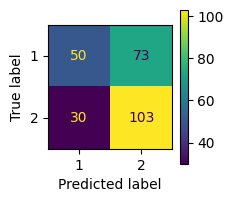

              precision    recall  f1-score   support

           1       0.62      0.41      0.49       123
           2       0.59      0.77      0.67       133

    accuracy                           0.60       256
   macro avg       0.61      0.59      0.58       256
weighted avg       0.60      0.60      0.58       256

5/5 [==============================] - 2s 439ms/step
| 65        | 0.6705    | 6.788     | 0.003162  | 0.3349    | 13.55     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


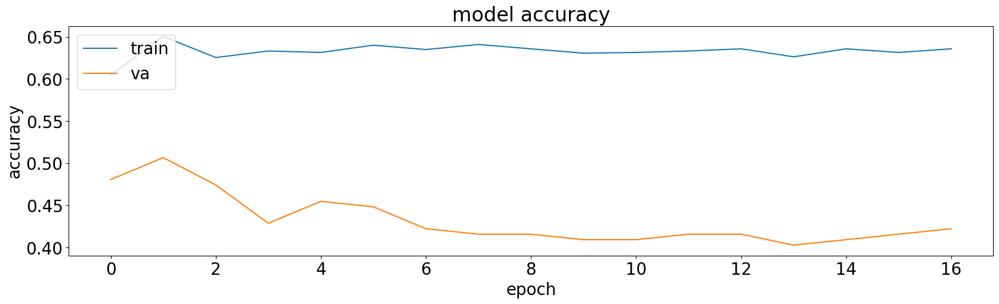

8/8 [==============================] - 3s 279ms/step


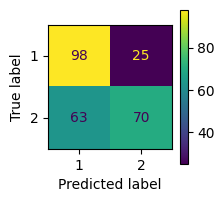

              precision    recall  f1-score   support

           1       0.61      0.80      0.69       123
           2       0.74      0.53      0.61       133

    accuracy                           0.66       256
   macro avg       0.67      0.66      0.65       256
weighted avg       0.68      0.66      0.65       256

5/5 [==============================] - 3s 464ms/step
| 66        | 0.5022    | 6.588     | 0.04064   | 1.031     | 3.262     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


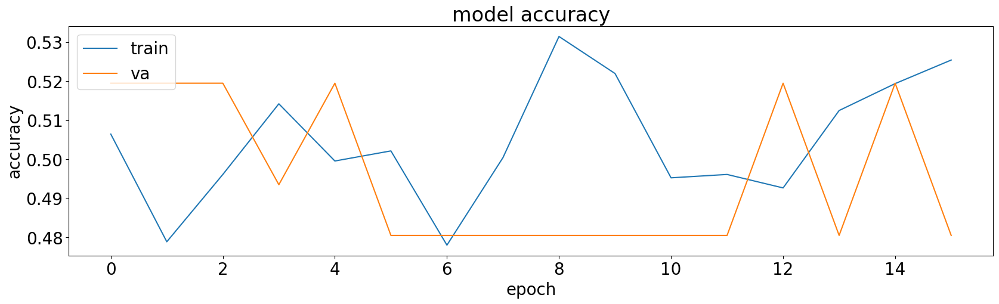

8/8 [==============================] - 2s 227ms/step


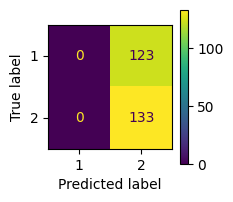

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 518ms/step
| 67        | 0.4214    | 6.542     | 0.02791   | 1.607     | 13.66     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


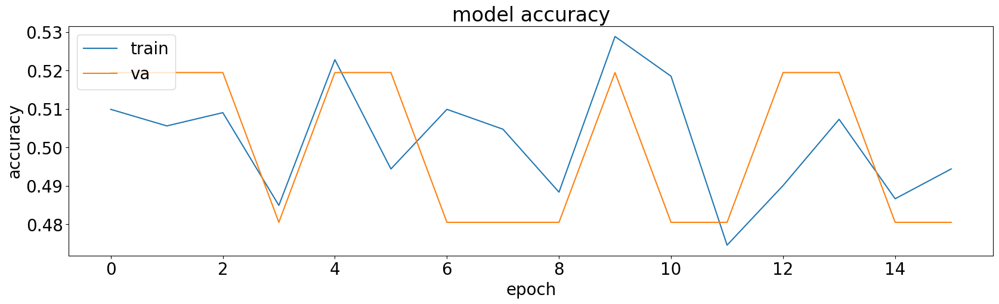

8/8 [==============================] - 2s 235ms/step


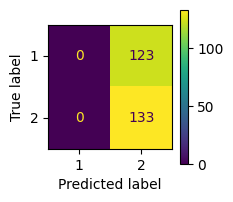

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 494ms/step
| 68        | 0.4214    | 6.401     | 0.05128   | 1.778     | 12.21     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


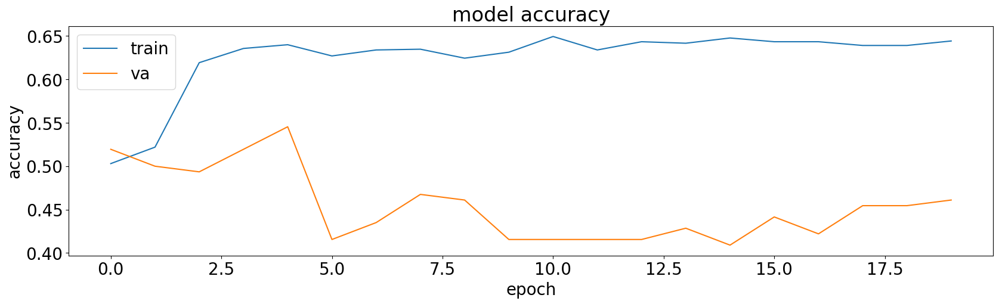

8/8 [==============================] - 1s 22ms/step


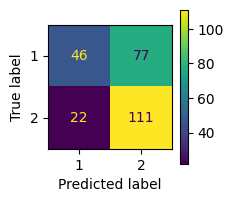

              precision    recall  f1-score   support

           1       0.68      0.37      0.48       123
           2       0.59      0.83      0.69       133

    accuracy                           0.61       256
   macro avg       0.63      0.60      0.59       256
weighted avg       0.63      0.61      0.59       256

5/5 [==============================] - 1s 23ms/step
| 69        | 0.5398    | 6.455     | 0.02122   | 1.345     | 17.75     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


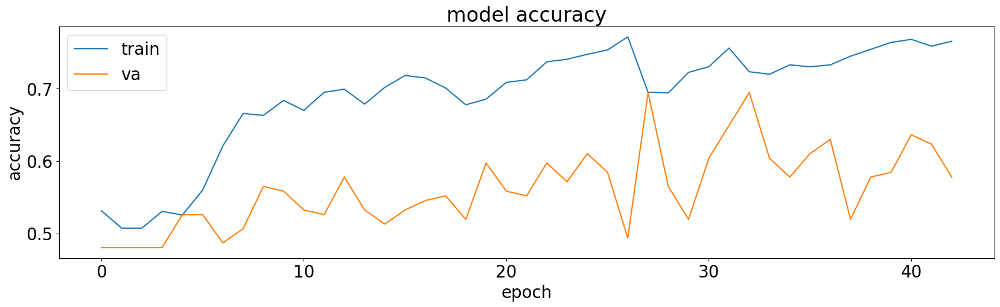

8/8 [==============================] - 2s 218ms/step


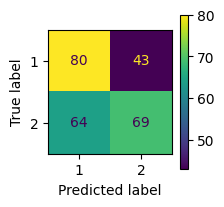

              precision    recall  f1-score   support

           1       0.56      0.65      0.60       123
           2       0.62      0.52      0.56       133

    accuracy                           0.58       256
   macro avg       0.59      0.58      0.58       256
weighted avg       0.59      0.58      0.58       256

5/5 [==============================] - 1s 12ms/step
| 70        | 0.6929    | 8.454     | 0.01719   | 0.03007   | 4.898     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

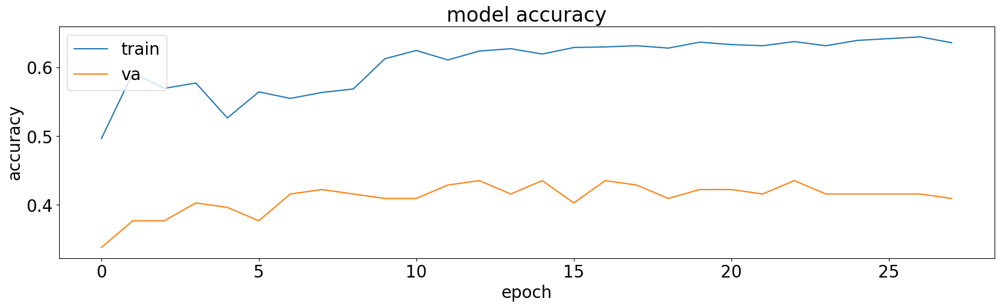

8/8 [==============================] - 2s 217ms/step


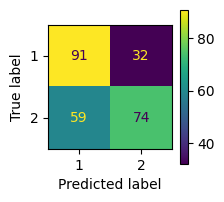

              precision    recall  f1-score   support

           1       0.61      0.74      0.67       123
           2       0.70      0.56      0.62       133

    accuracy                           0.64       256
   macro avg       0.65      0.65      0.64       256
weighted avg       0.65      0.64      0.64       256

5/5 [==============================] - 3s 514ms/step
| 71        | 0.4341    | 8.958     | 0.07112   | 1.165     | 15.43     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


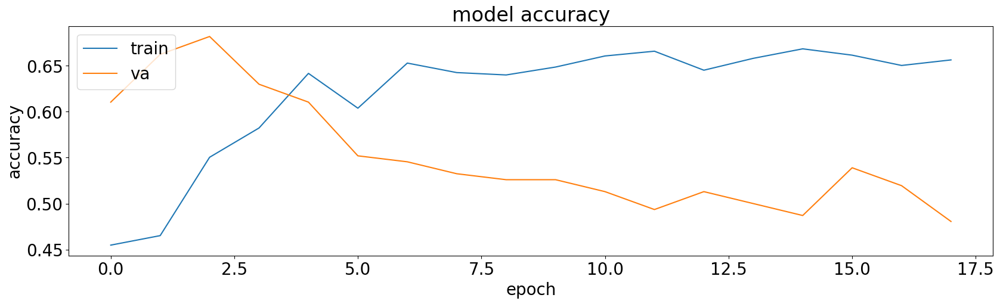

8/8 [==============================] - 3s 398ms/step


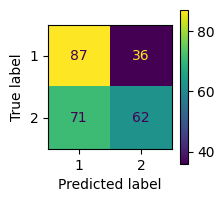

              precision    recall  f1-score   support

           1       0.55      0.71      0.62       123
           2       0.63      0.47      0.54       133

    accuracy                           0.58       256
   macro avg       0.59      0.59      0.58       256
weighted avg       0.59      0.58      0.58       256

5/5 [==============================] - 3s 499ms/step
| 72        | 0.6751    | 8.697     | 0.04577   | 0.7984    | 7.608     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


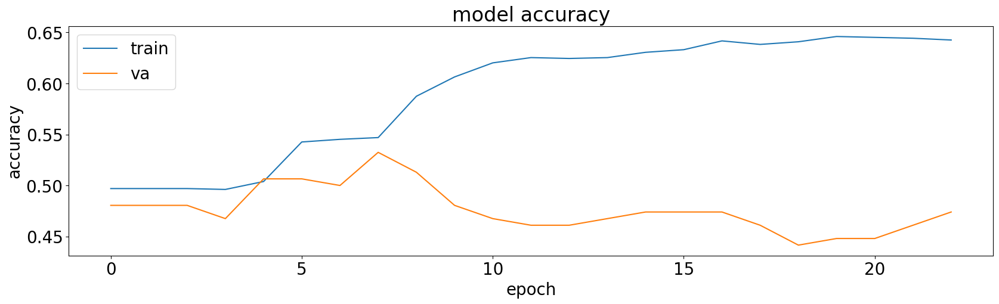

8/8 [==============================] - 3s 306ms/step


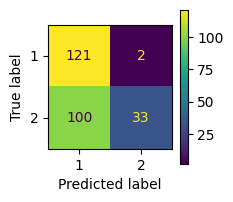

              precision    recall  f1-score   support

           1       0.55      0.98      0.70       123
           2       0.94      0.25      0.39       133

    accuracy                           0.60       256
   macro avg       0.75      0.62      0.55       256
weighted avg       0.75      0.60      0.54       256

5/5 [==============================] - 1s 17ms/step
| 73        | 0.5091    | 8.105     | 0.03904   | 0.5367    | 10.81     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


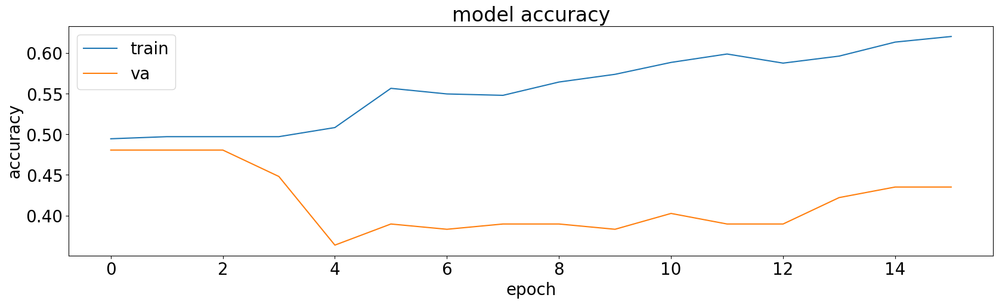

8/8 [==============================] - 3s 310ms/step


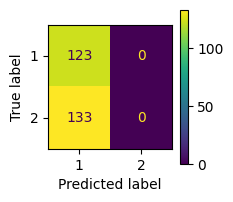

              precision    recall  f1-score   support

           1       0.48      1.00      0.65       123
           2       0.00      0.00      0.00       133

    accuracy                           0.48       256
   macro avg       0.24      0.50      0.32       256
weighted avg       0.23      0.48      0.31       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 505ms/step
| 74        | 0.3949    | 8.983     | 0.02633   | 1.237     | 8.657     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


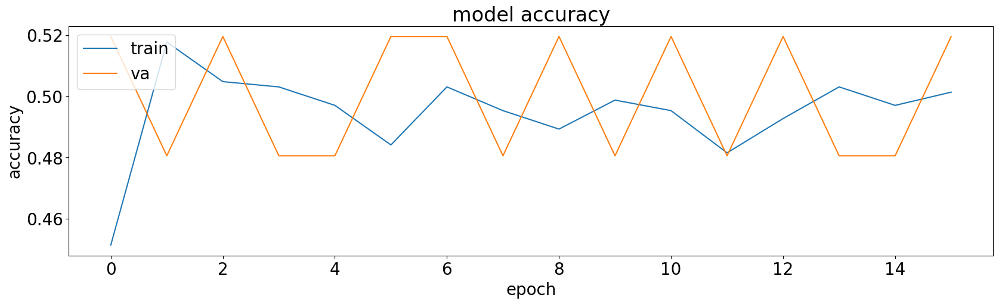

8/8 [==============================] - 1s 12ms/step


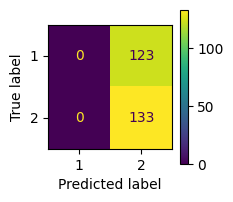

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 349ms/step
| 75        | 0.4214    | 8.553     | 0.07851   | 1.804     | 3.681     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


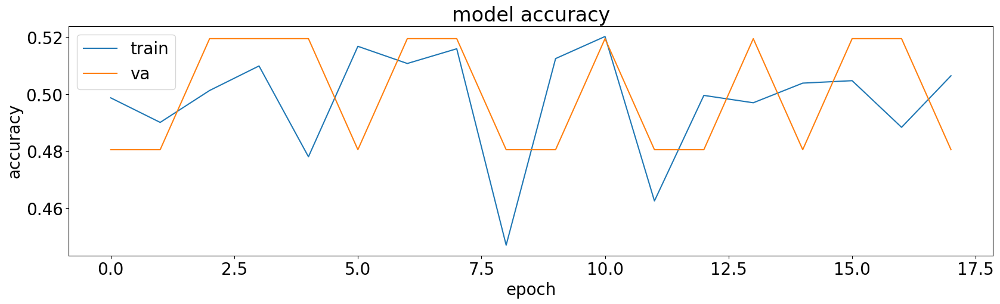

8/8 [==============================] - 3s 387ms/step


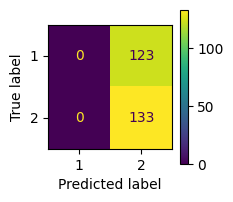

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 337ms/step
| 76        | 0.4214    | 7.184     | 0.06522   | 0.3137    | 9.512     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


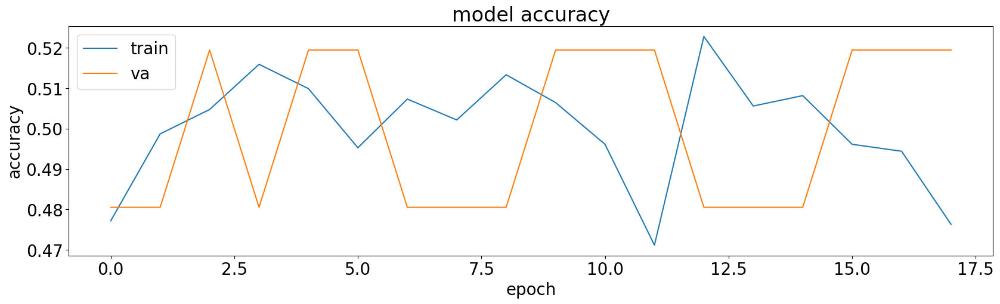

8/8 [==============================] - 2s 211ms/step


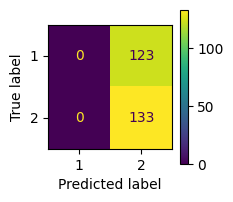

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 428ms/step
| 77        | 0.4214    | 7.618     | 0.03982   | 1.874     | 9.59      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


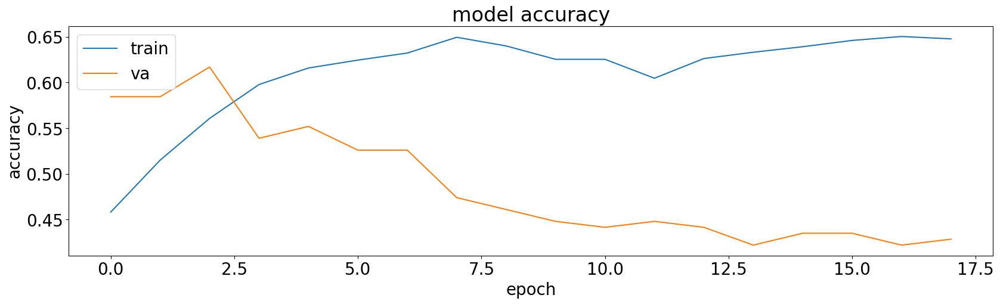

8/8 [==============================] - 2s 230ms/step


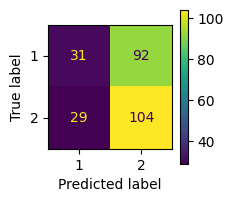

              precision    recall  f1-score   support

           1       0.52      0.25      0.34       123
           2       0.53      0.78      0.63       133

    accuracy                           0.53       256
   macro avg       0.52      0.52      0.49       256
weighted avg       0.52      0.53      0.49       256

5/5 [==============================] - 2s 441ms/step
| 78        | 0.6125    | 7.465     | 0.007355  | 0.6593    | 13.52     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


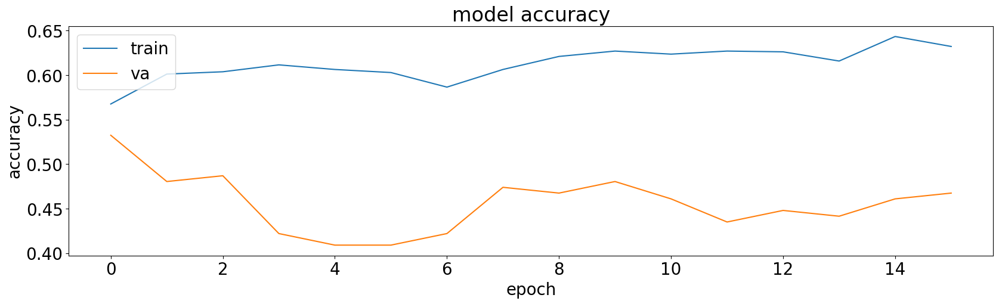

8/8 [==============================] - 2s 221ms/step


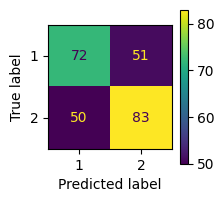

              precision    recall  f1-score   support

           1       0.59      0.59      0.59       123
           2       0.62      0.62      0.62       133

    accuracy                           0.61       256
   macro avg       0.60      0.60      0.60       256
weighted avg       0.61      0.61      0.61       256

5/5 [==============================] - 3s 518ms/step
| 79        | 0.5323    | 7.217     | 0.002383  | 0.8163    | 16.18     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


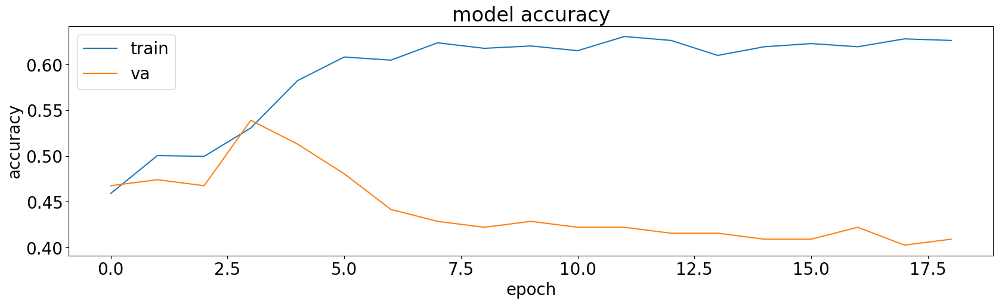

8/8 [==============================] - 3s 296ms/step


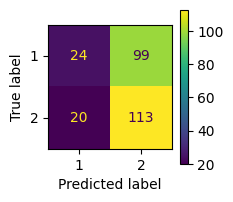

              precision    recall  f1-score   support

           1       0.55      0.20      0.29       123
           2       0.53      0.85      0.66       133

    accuracy                           0.54       256
   macro avg       0.54      0.52      0.47       256
weighted avg       0.54      0.54      0.48       256

5/5 [==============================] - 3s 511ms/step
| 80        | 0.5147    | 7.965     | 0.02256   | 1.405     | 18.33     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


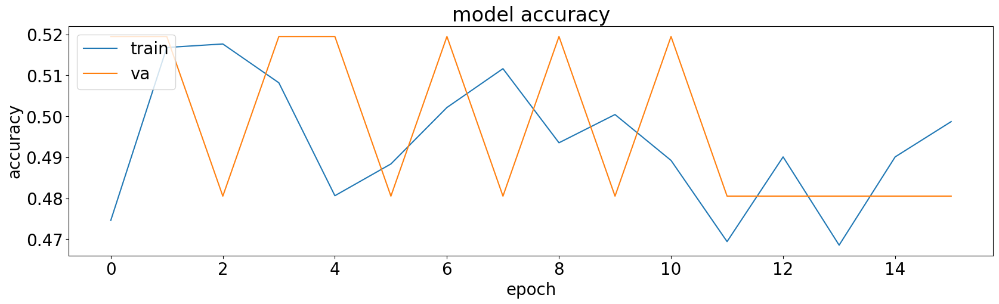

8/8 [==============================] - 3s 386ms/step


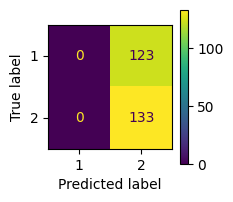

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 439ms/step
| 81        | 0.4214    | 6.904     | 0.0636    | 1.786     | 11.07     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


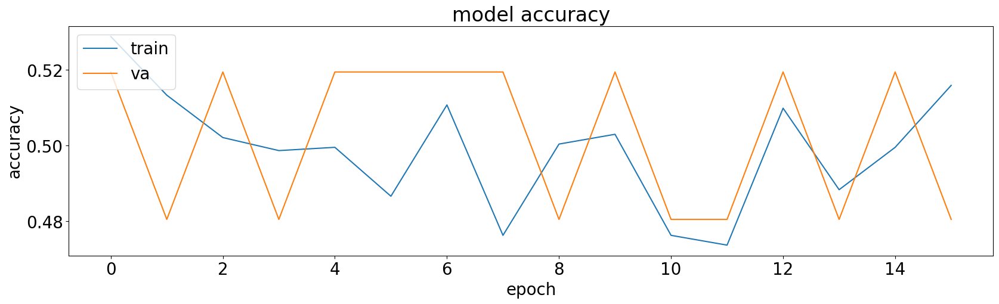

8/8 [==============================] - 1s 20ms/step


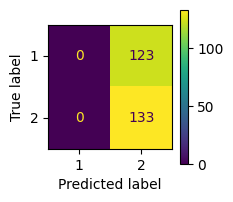

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 3s 523ms/step
| 82        | 0.4214    | 8.221     | 0.0984    | 0.3208    | 15.34     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


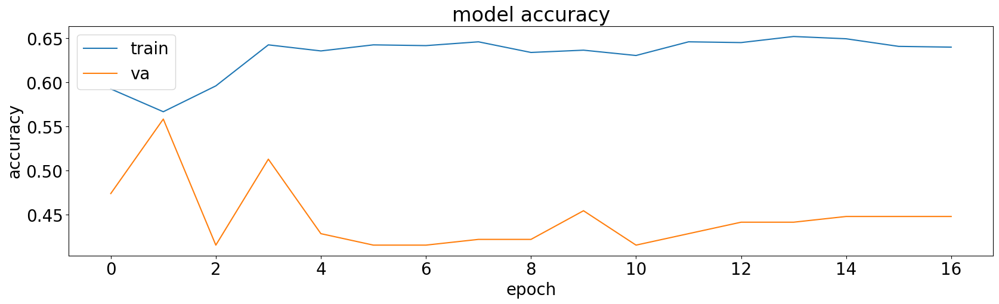

8/8 [==============================] - 2s 116ms/step


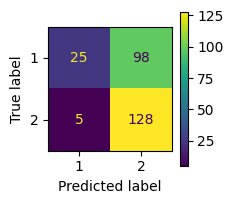

              precision    recall  f1-score   support

           1       0.83      0.20      0.33       123
           2       0.57      0.96      0.71       133

    accuracy                           0.60       256
   macro avg       0.70      0.58      0.52       256
weighted avg       0.69      0.60      0.53       256

5/5 [==============================] - 2s 296ms/step
| 83        | 0.5293    | 7.079     | 0.05119   | 1.45      | 11.38     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

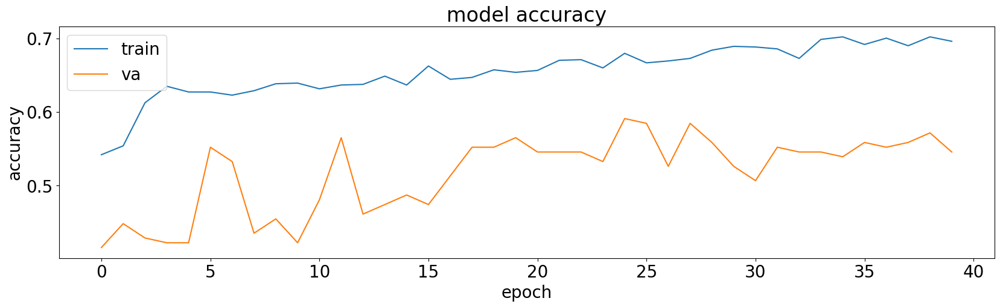

8/8 [==============================] - 2s 197ms/step


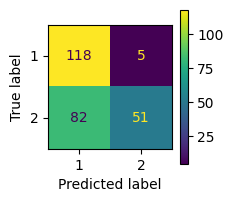

              precision    recall  f1-score   support

           1       0.59      0.96      0.73       123
           2       0.91      0.38      0.54       133

    accuracy                           0.66       256
   macro avg       0.75      0.67      0.64       256
weighted avg       0.76      0.66      0.63       256

5/5 [==============================] - 2s 444ms/step
| 84        | 0.5767    | 7.457     | 0.06915   | 1.295     | 16.42     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


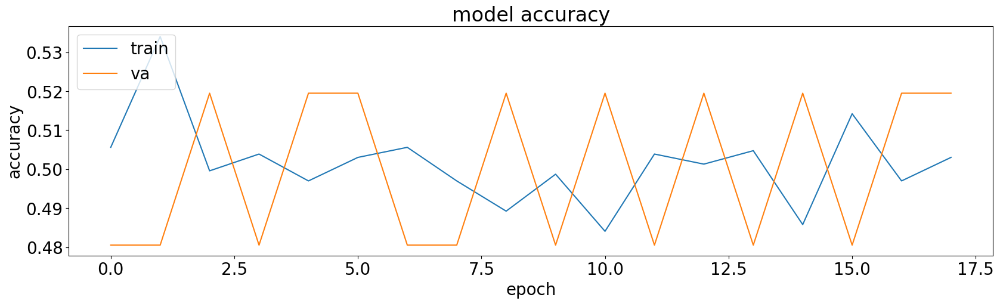

8/8 [==============================] - 2s 220ms/step


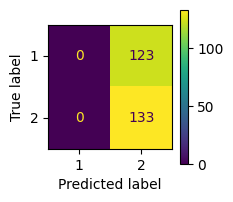

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 440ms/step
| 85        | 0.4214    | 8.792     | 0.09134   | 1.51      | 14.41     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


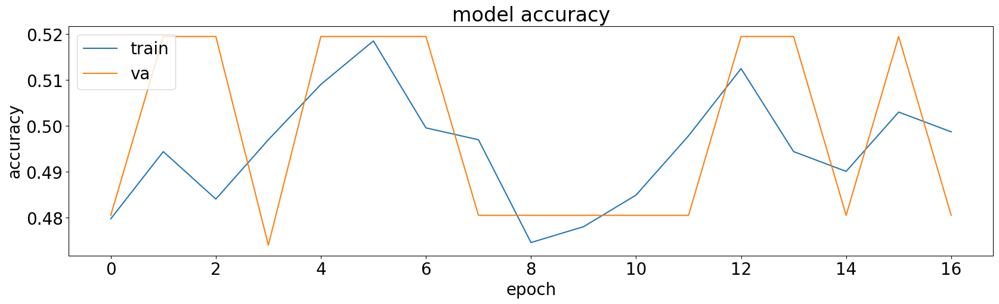

8/8 [==============================] - 3s 299ms/step


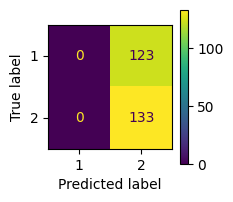

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 464ms/step
| 86        | 0.4214    | 7.18      | 0.0945    | 1.53      | 16.15     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

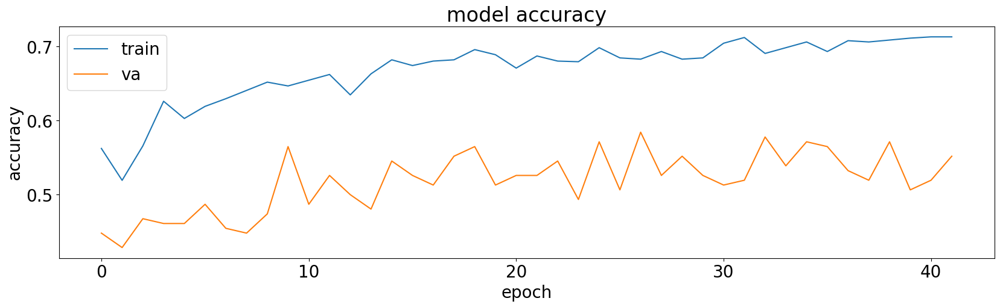

8/8 [==============================] - 1s 13ms/step


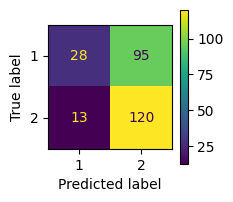

              precision    recall  f1-score   support

           1       0.68      0.23      0.34       123
           2       0.56      0.90      0.69       133

    accuracy                           0.58       256
   macro avg       0.62      0.56      0.52       256
weighted avg       0.62      0.58      0.52       256

5/5 [==============================] - 1s 13ms/step
| 87        | 0.5427    | 7.05      | 0.09435   | 0.7587    | 7.209     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


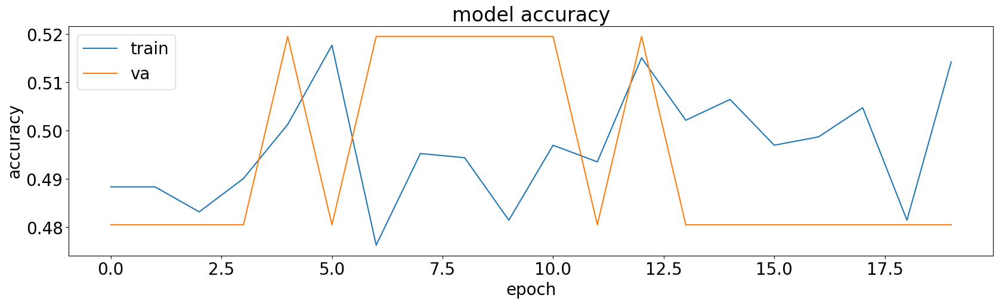

8/8 [==============================] - 2s 213ms/step


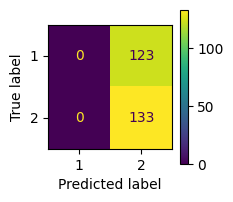

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 296ms/step
| 88        | 0.4214    | 7.296     | 0.06821   | 1.863     | 14.16     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


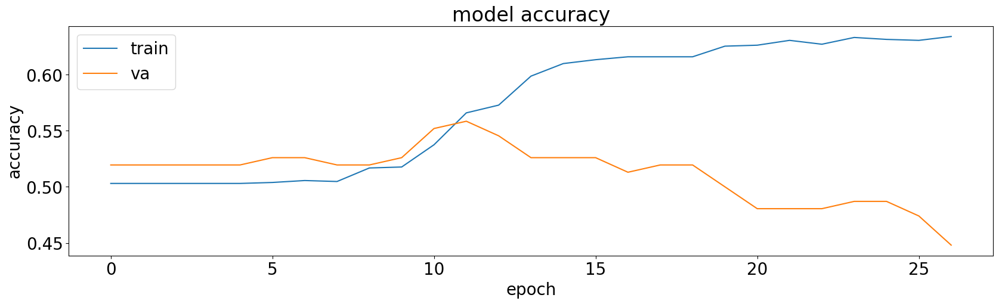

8/8 [==============================] - 3s 390ms/step


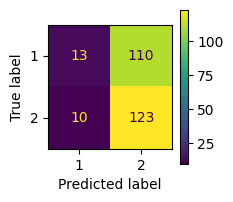

              precision    recall  f1-score   support

           1       0.57      0.11      0.18       123
           2       0.53      0.92      0.67       133

    accuracy                           0.53       256
   macro avg       0.55      0.52      0.43       256
weighted avg       0.55      0.53      0.43       256

5/5 [==============================] - 2s 308ms/step
| 89        | 0.5021    | 7.935     | 0.0134    | 1.359     | 6.623     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


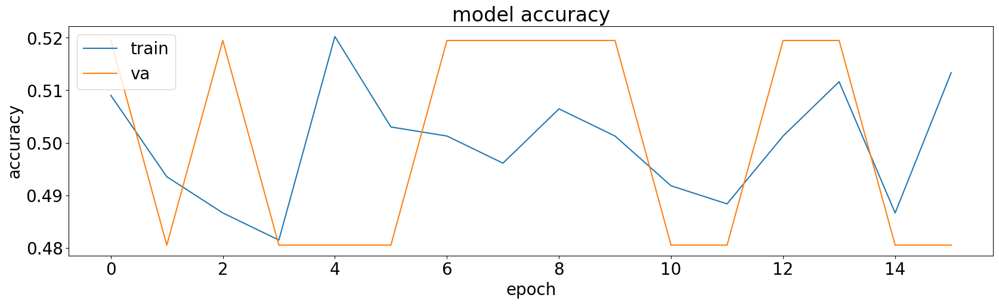

8/8 [==============================] - 2s 218ms/step


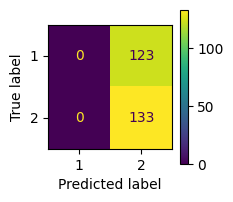

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 419ms/step
| 90        | 0.4214    | 7.264     | 0.04239   | 1.65      | 8.443     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


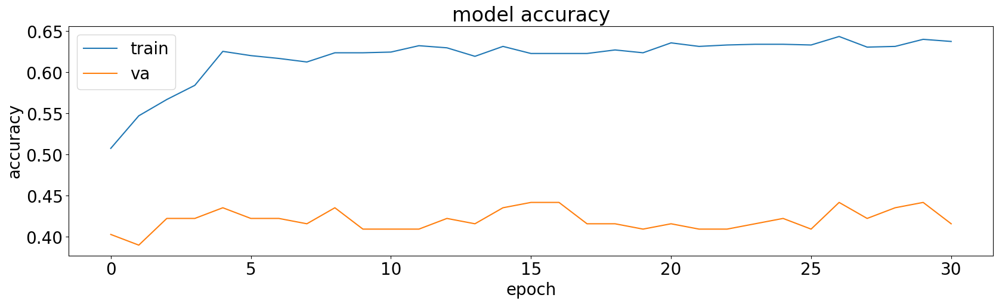

8/8 [==============================] - 3s 299ms/step


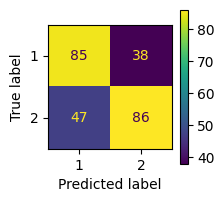

              precision    recall  f1-score   support

           1       0.64      0.69      0.67       123
           2       0.69      0.65      0.67       133

    accuracy                           0.67       256
   macro avg       0.67      0.67      0.67       256
weighted avg       0.67      0.67      0.67       256

5/5 [==============================] - 2s 296ms/step
| 91        | 0.4411    | 8.884     | 0.06852   | 1.19      | 14.49     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


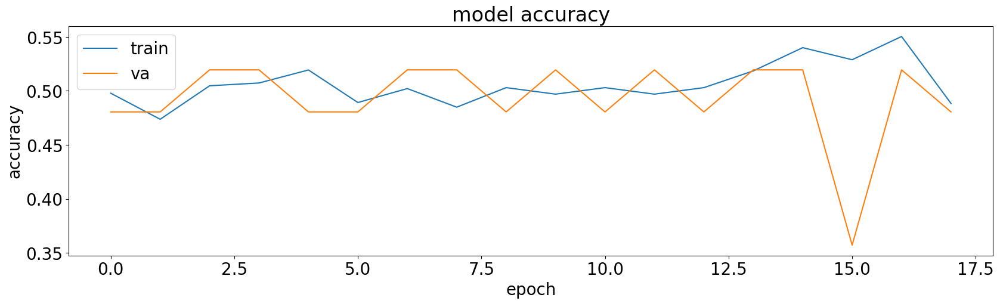

8/8 [==============================] - 1s 11ms/step


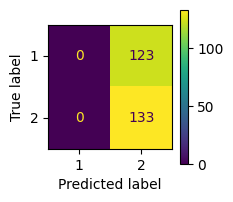

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 1s 12ms/step
| 92        | 0.4214    | 8.971     | 0.06476   | 0.1756    | 3.271     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


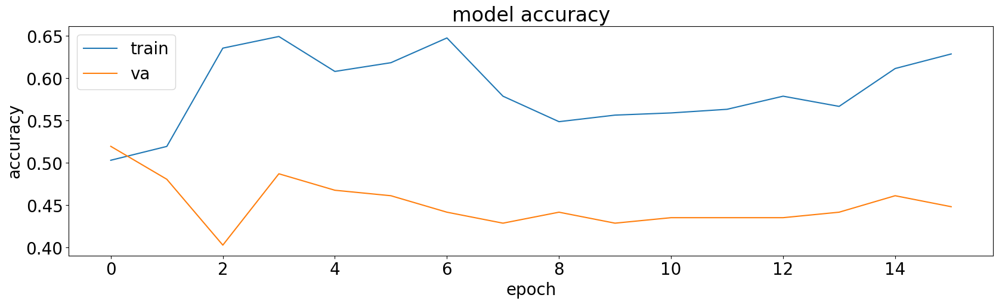

8/8 [==============================] - 2s 225ms/step


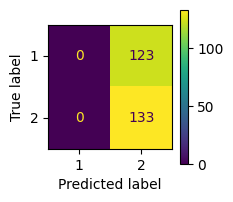

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 511ms/step
| 93        | 0.4214    | 7.286     | 0.01837   | 0.8339    | 17.32     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


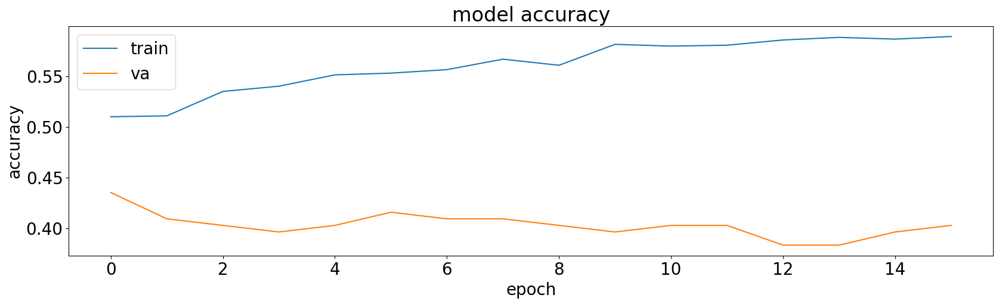

8/8 [==============================] - 2s 120ms/step


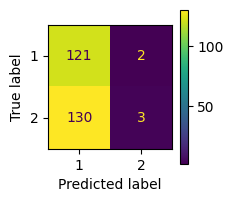

              precision    recall  f1-score   support

           1       0.48      0.98      0.65       123
           2       0.60      0.02      0.04       133

    accuracy                           0.48       256
   macro avg       0.54      0.50      0.35       256
weighted avg       0.54      0.48      0.33       256

5/5 [==============================] - 2s 286ms/step
| 94        | 0.3632    | 8.067     | 0.01267   | 1.087     | 14.59     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


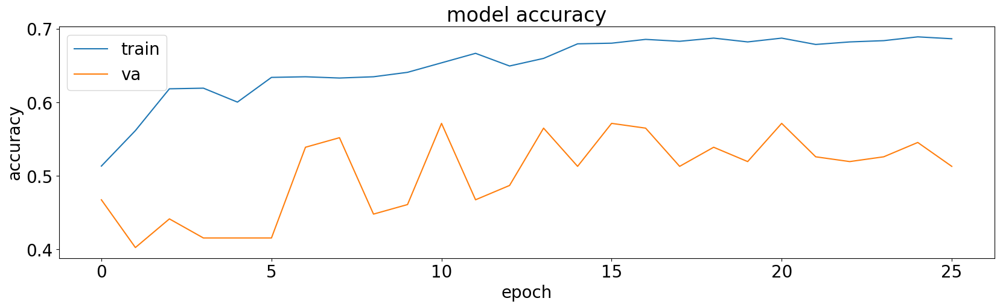

8/8 [==============================] - 2s 146ms/step


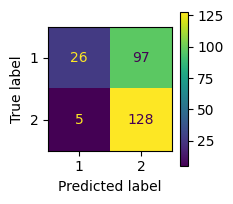

              precision    recall  f1-score   support

           1       0.84      0.21      0.34       123
           2       0.57      0.96      0.72       133

    accuracy                           0.60       256
   macro avg       0.70      0.59      0.53       256
weighted avg       0.70      0.60      0.53       256

5/5 [==============================] - 2s 295ms/step
| 95        | 0.5317    | 7.14      | 0.08499   | 0.8219    | 8.711     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


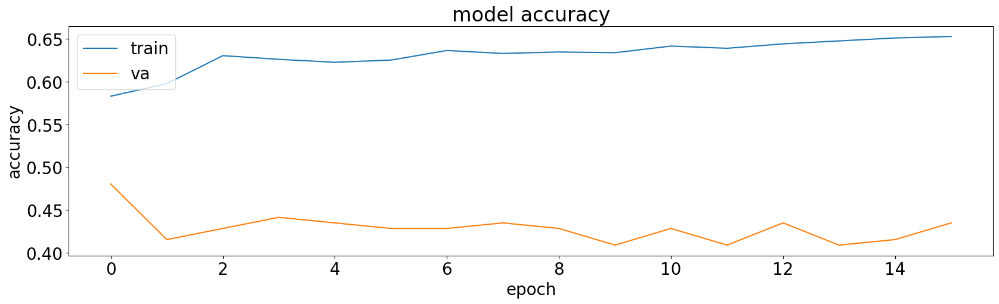

8/8 [==============================] - 2s 216ms/step


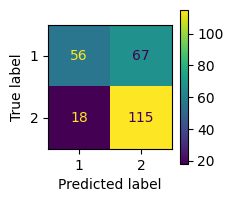

              precision    recall  f1-score   support

           1       0.76      0.46      0.57       123
           2       0.63      0.86      0.73       133

    accuracy                           0.67       256
   macro avg       0.69      0.66      0.65       256
weighted avg       0.69      0.67      0.65       256

5/5 [==============================] - 3s 411ms/step
| 96        | 0.4777    | 8.338     | 0.0904    | 1.025     | 7.314     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


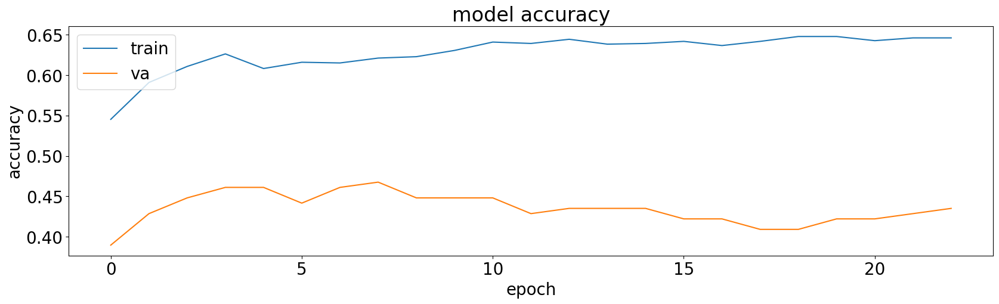

8/8 [==============================] - 2s 245ms/step


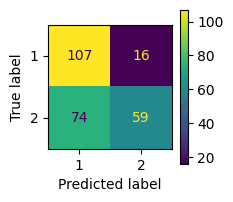

              precision    recall  f1-score   support

           1       0.59      0.87      0.70       123
           2       0.79      0.44      0.57       133

    accuracy                           0.65       256
   macro avg       0.69      0.66      0.64       256
weighted avg       0.69      0.65      0.63       256

5/5 [==============================] - 3s 607ms/step
| 97        | 0.4646    | 7.991     | 0.04633   | 0.7769    | 3.459     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


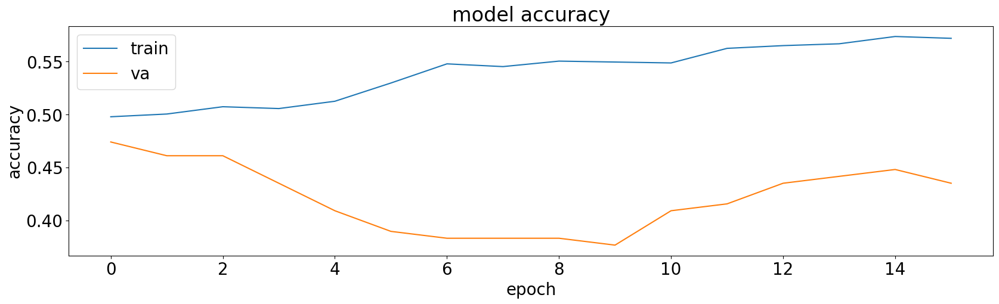

8/8 [==============================] - 3s 303ms/step


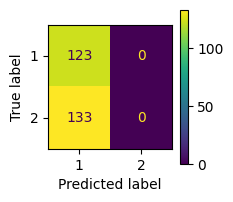

              precision    recall  f1-score   support

           1       0.48      1.00      0.65       123
           2       0.00      0.00      0.00       133

    accuracy                           0.48       256
   macro avg       0.24      0.50      0.32       256
weighted avg       0.23      0.48      0.31       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 12ms/step
| 98        | 0.3904    | 8.766     | 0.03125   | 1.081     | 4.088     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


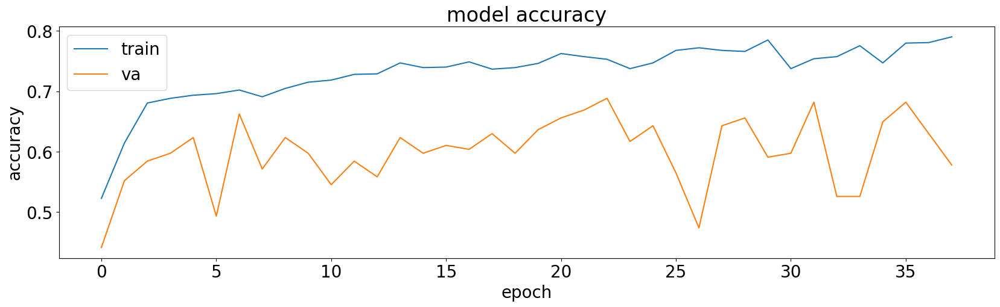

8/8 [==============================] - 1s 12ms/step


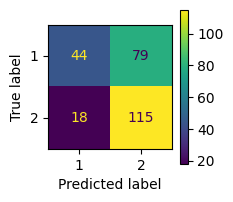

              precision    recall  f1-score   support

           1       0.71      0.36      0.48       123
           2       0.59      0.86      0.70       133

    accuracy                           0.62       256
   macro avg       0.65      0.61      0.59       256
weighted avg       0.65      0.62      0.59       256

5/5 [==============================] - 1s 12ms/step
| 99        | 0.6803    | 6.86      | 0.01128   | 1.707     | 4.541     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

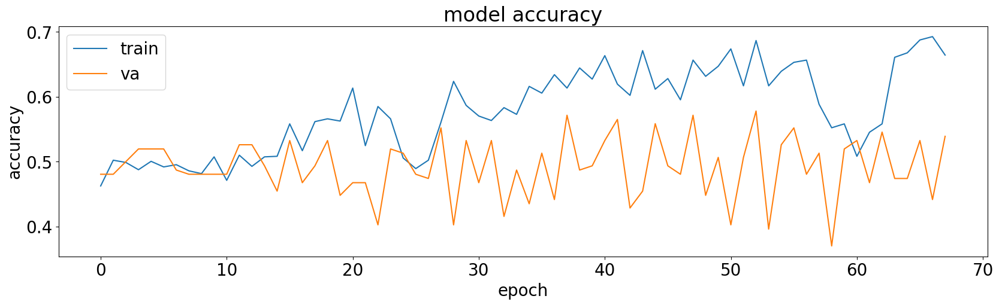

8/8 [==============================] - 3s 276ms/step


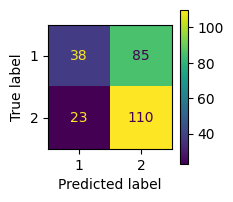

              precision    recall  f1-score   support

           1       0.62      0.31      0.41       123
           2       0.56      0.83      0.67       133

    accuracy                           0.58       256
   macro avg       0.59      0.57      0.54       256
weighted avg       0.59      0.58      0.55       256

5/5 [==============================] - 2s 323ms/step
| 100       | 0.5536    | 8.159     | 0.02942   | 0.492     | 5.163     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


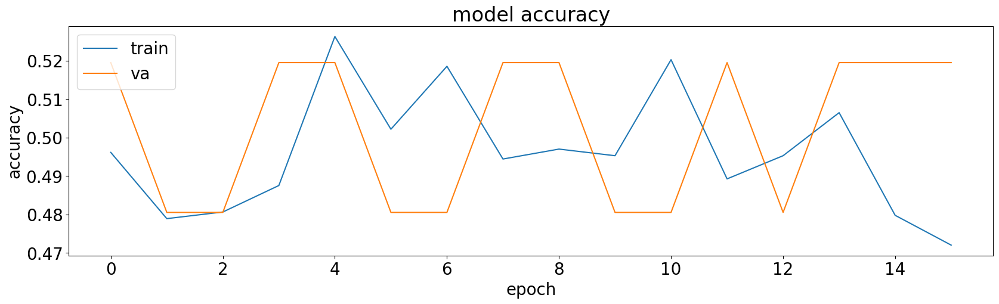

8/8 [==============================] - 3s 304ms/step


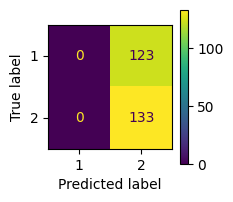

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 616ms/step
| 101       | 0.4214    | 8.818     | 0.09722   | 0.4964    | 4.492     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

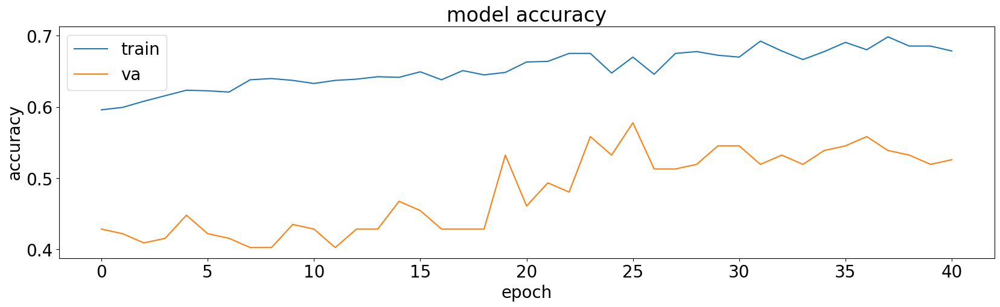

8/8 [==============================] - 3s 299ms/step


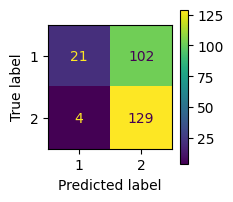

              precision    recall  f1-score   support

           1       0.84      0.17      0.28       123
           2       0.56      0.97      0.71       133

    accuracy                           0.59       256
   macro avg       0.70      0.57      0.50       256
weighted avg       0.69      0.59      0.50       256

5/5 [==============================] - 2s 437ms/step
| 102       | 0.5372    | 7.682     | 0.08177   | 1.414     | 4.876     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


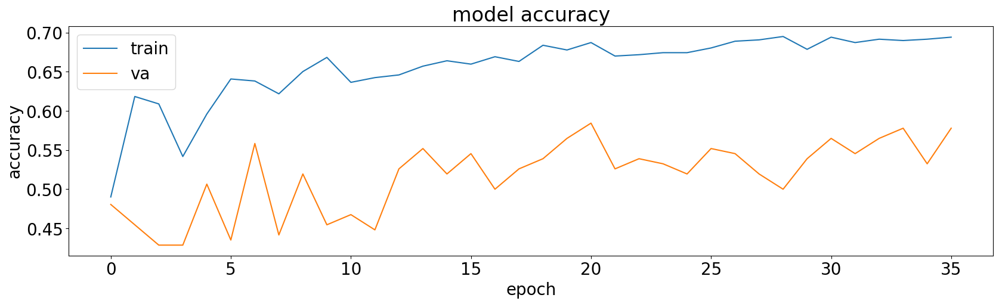

8/8 [==============================] - 1s 22ms/step


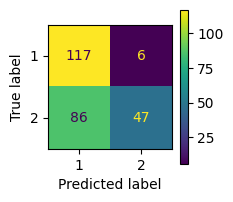

              precision    recall  f1-score   support

           1       0.58      0.95      0.72       123
           2       0.89      0.35      0.51       133

    accuracy                           0.64       256
   macro avg       0.73      0.65      0.61       256
weighted avg       0.74      0.64      0.61       256

5/5 [==============================] - 3s 525ms/step
| 103       | 0.5692    | 7.43      | 0.08173   | 1.26      | 18.41     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


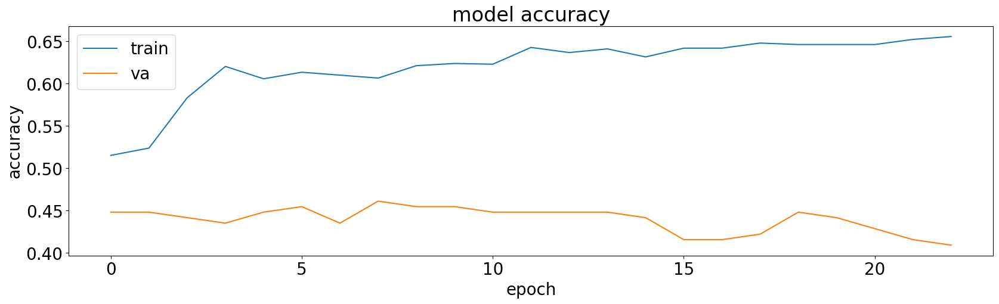

8/8 [==============================] - 3s 317ms/step


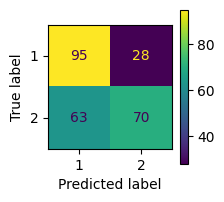

              precision    recall  f1-score   support

           1       0.60      0.77      0.68       123
           2       0.71      0.53      0.61       133

    accuracy                           0.64       256
   macro avg       0.66      0.65      0.64       256
weighted avg       0.66      0.64      0.64       256

5/5 [==============================] - 3s 648ms/step
| 104       | 0.4597    | 8.16      | 0.0577    | 1.318     | 19.84     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

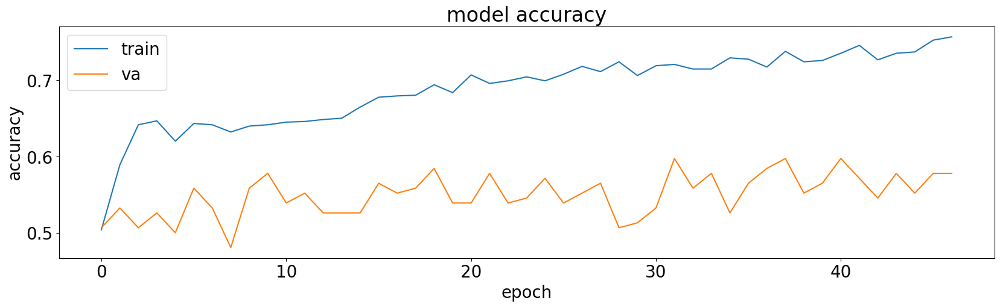

8/8 [==============================] - 3s 298ms/step


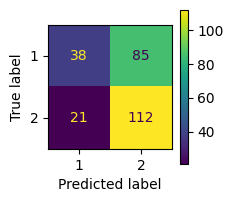

              precision    recall  f1-score   support

           1       0.64      0.31      0.42       123
           2       0.57      0.84      0.68       133

    accuracy                           0.59       256
   macro avg       0.61      0.58      0.55       256
weighted avg       0.60      0.59      0.55       256

5/5 [==============================] - 2s 441ms/step
| 105       | 0.5753    | 6.477     | 0.04837   | 1.013     | 4.18      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


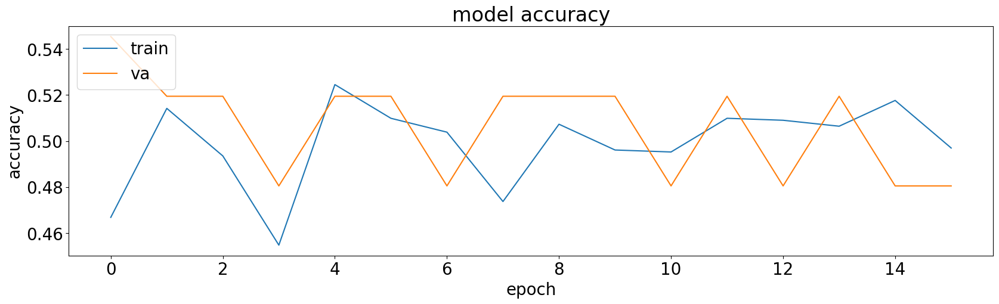

8/8 [==============================] - 1s 20ms/step


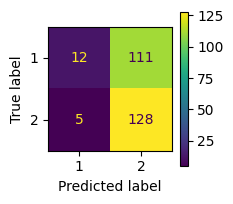

              precision    recall  f1-score   support

           1       0.71      0.10      0.17       123
           2       0.54      0.96      0.69       133

    accuracy                           0.55       256
   macro avg       0.62      0.53      0.43       256
weighted avg       0.62      0.55      0.44       256

5/5 [==============================] - 1s 20ms/step
| 106       | 0.4996    | 8.93      | 0.05435   | 1.969     | 16.25     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

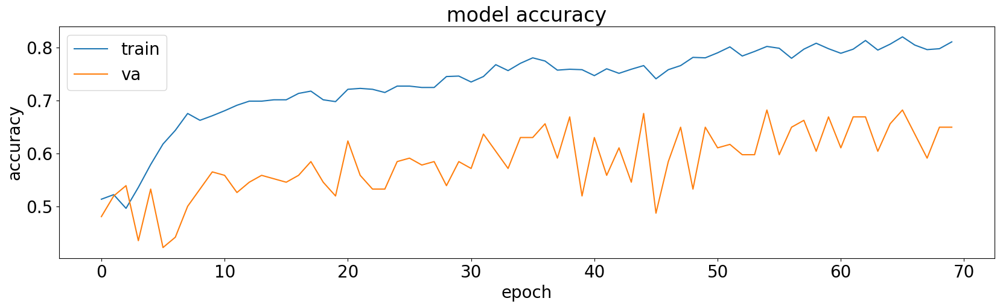

8/8 [==============================] - 2s 128ms/step


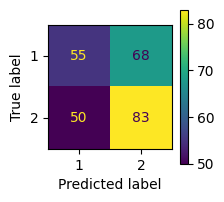

              precision    recall  f1-score   support

           1       0.52      0.45      0.48       123
           2       0.55      0.62      0.58       133

    accuracy                           0.54       256
   macro avg       0.54      0.54      0.53       256
weighted avg       0.54      0.54      0.54       256

5/5 [==============================] - 3s 474ms/step
| 107       | 0.6807    | 7.677     | 0.02078   | 1.607     | 3.464     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


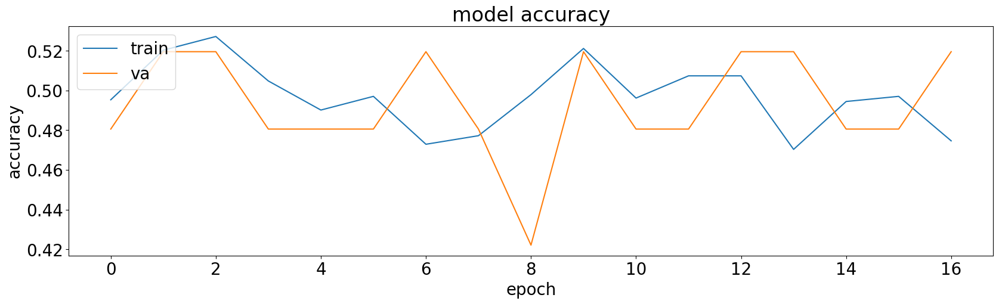

8/8 [==============================] - 3s 301ms/step


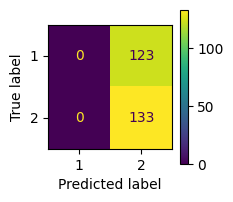

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 308ms/step
| 108       | 0.4214    | 8.393     | 0.01914   | 0.4338    | 19.03     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

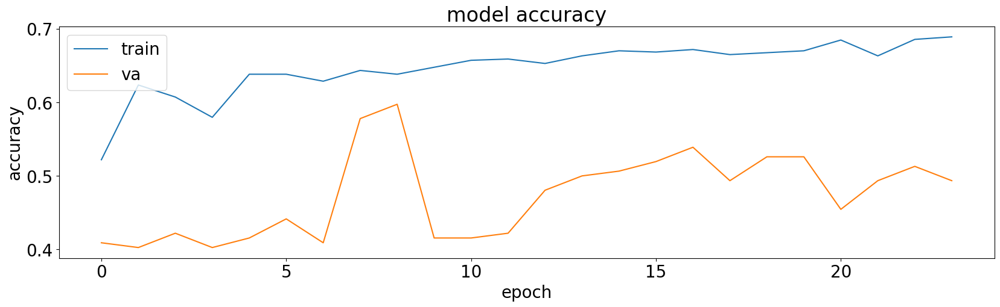

8/8 [==============================] - 3s 285ms/step


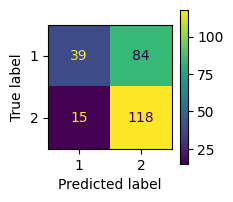

              precision    recall  f1-score   support

           1       0.72      0.32      0.44       123
           2       0.58      0.89      0.70       133

    accuracy                           0.61       256
   macro avg       0.65      0.60      0.57       256
weighted avg       0.65      0.61      0.58       256

5/5 [==============================] - 3s 416ms/step
| 109       | 0.5842    | 6.545     | 0.08952   | 1.009     | 19.75     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


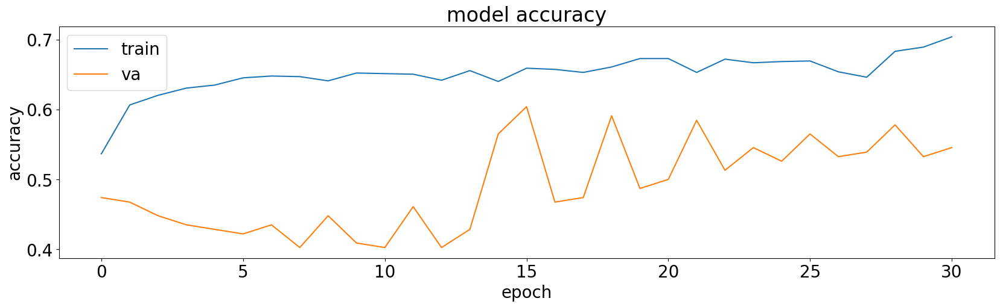

8/8 [==============================] - 2s 208ms/step


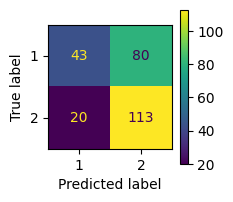

              precision    recall  f1-score   support

           1       0.68      0.35      0.46       123
           2       0.59      0.85      0.69       133

    accuracy                           0.61       256
   macro avg       0.63      0.60      0.58       256
weighted avg       0.63      0.61      0.58       256

5/5 [==============================] - 2s 308ms/step
| 110       | 0.5943    | 8.037     | 0.08307   | 0.6555    | 8.834     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


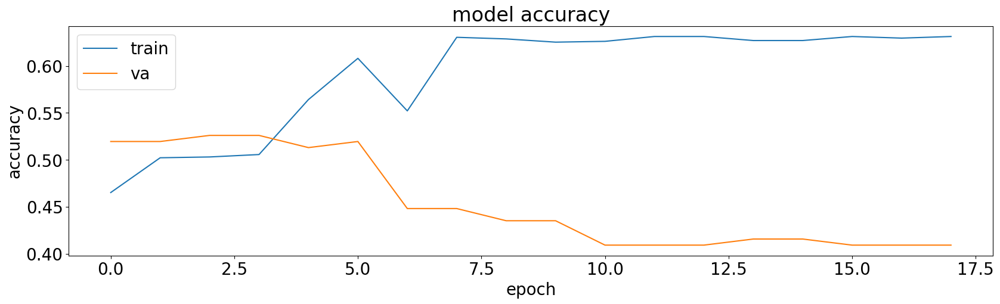

8/8 [==============================] - 3s 296ms/step


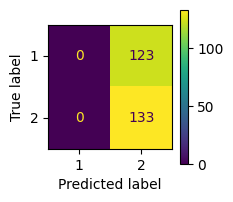

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 479ms/step
| 111       | 0.4331    | 8.398     | 0.02793   | 1.397     | 9.99      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


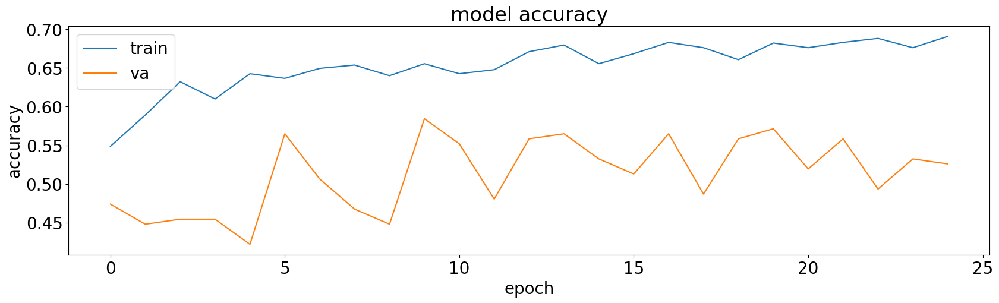

8/8 [==============================] - 2s 227ms/step


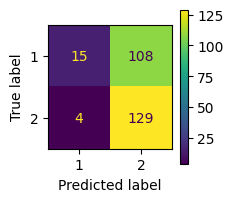

              precision    recall  f1-score   support

           1       0.79      0.12      0.21       123
           2       0.54      0.97      0.70       133

    accuracy                           0.56       256
   macro avg       0.67      0.55      0.45       256
weighted avg       0.66      0.56      0.46       256

5/5 [==============================] - 2s 420ms/step
| 112       | 0.5356    | 7.21      | 0.09873   | 1.363     | 18.35     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


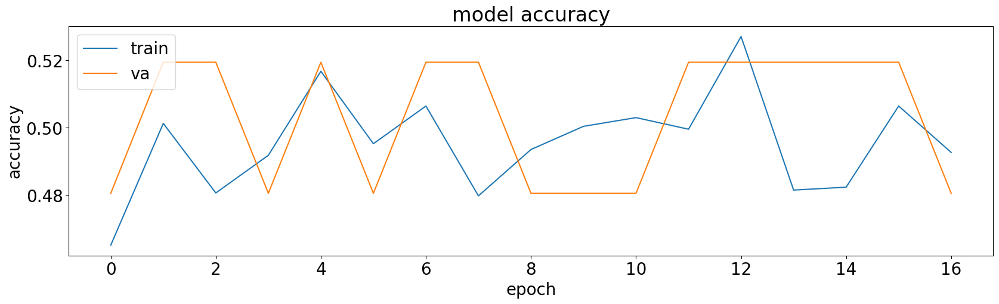

8/8 [==============================] - 1s 12ms/step


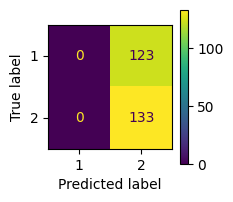

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 3s 531ms/step
| 113       | 0.4214    | 7.93      | 0.06148   | 1.729     | 5.728     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


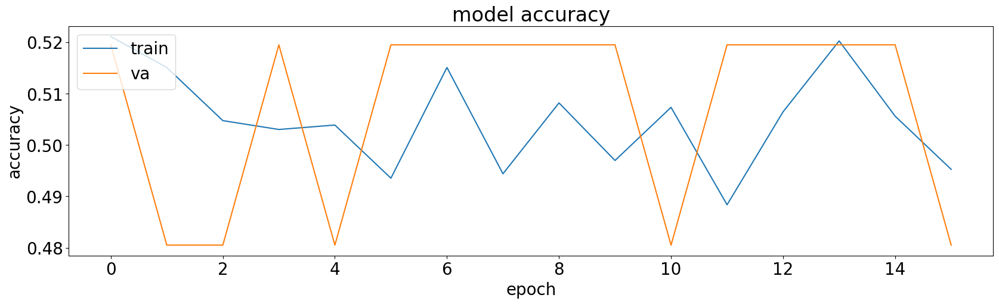

8/8 [==============================] - 2s 224ms/step


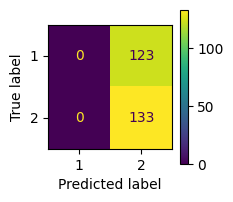

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 442ms/step
| 114       | 0.4214    | 7.62      | 0.0328    | 1.674     | 19.81     |


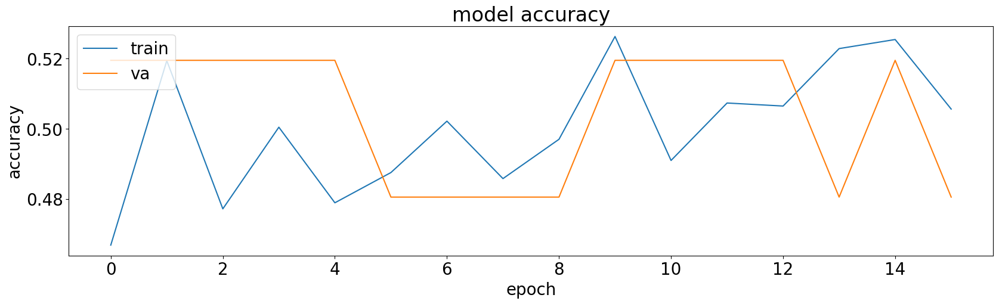

8/8 [==============================] - 2s 205ms/step


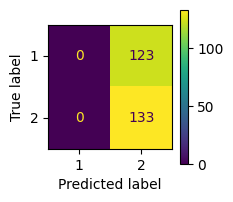

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 436ms/step
| 115       | 0.4214    | 8.399     | 0.03898   | 1.567     | 14.85     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


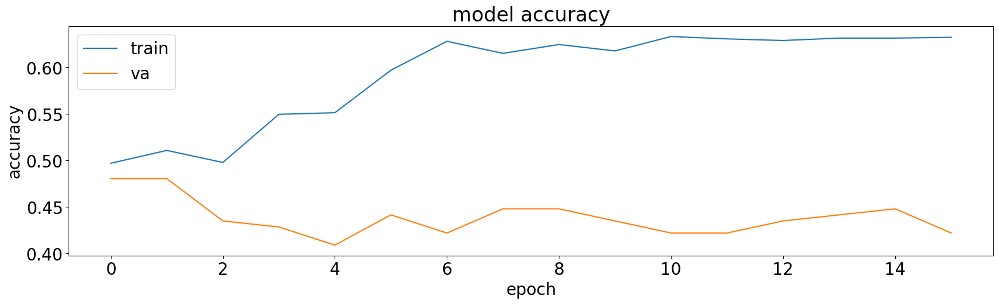

8/8 [==============================] - 1s 22ms/step


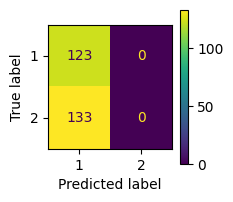

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.48      1.00      0.65       123
           2       0.00      0.00      0.00       133

    accuracy                           0.48       256
   macro avg       0.24      0.50      0.32       256
weighted avg       0.23      0.48      0.31       256

5/5 [==============================] - 3s 522ms/step
| 116       | 0.3949    | 8.997     | 0.0589    | 0.9503    | 17.94     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


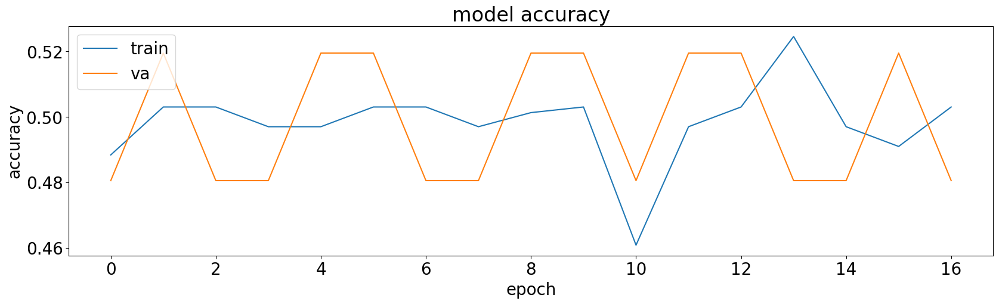

8/8 [==============================] - 1s 18ms/step


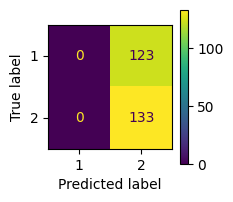

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 1s 17ms/step
| 117       | 0.4214    | 8.979     | 0.02738   | 0.08816   | 11.84     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

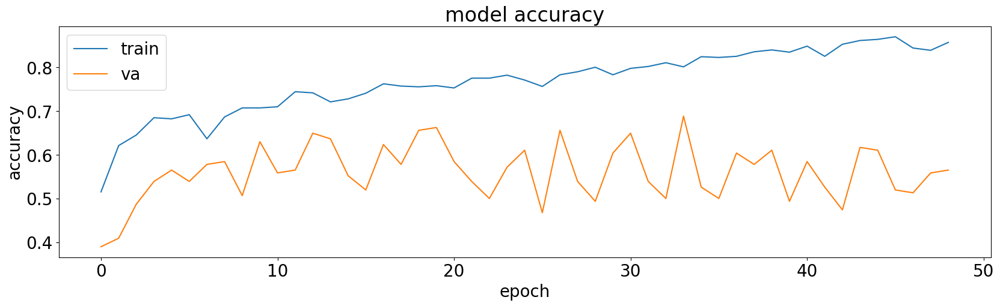

8/8 [==============================] - 2s 225ms/step


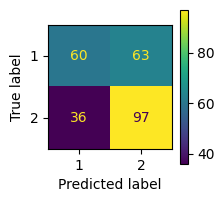

              precision    recall  f1-score   support

           1       0.62      0.49      0.55       123
           2       0.61      0.73      0.66       133

    accuracy                           0.61       256
   macro avg       0.62      0.61      0.61       256
weighted avg       0.62      0.61      0.61       256

5/5 [==============================] - 3s 571ms/step
| 118       | 0.6881    | 7.71      | 0.004448  | 1.677     | 11.73     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


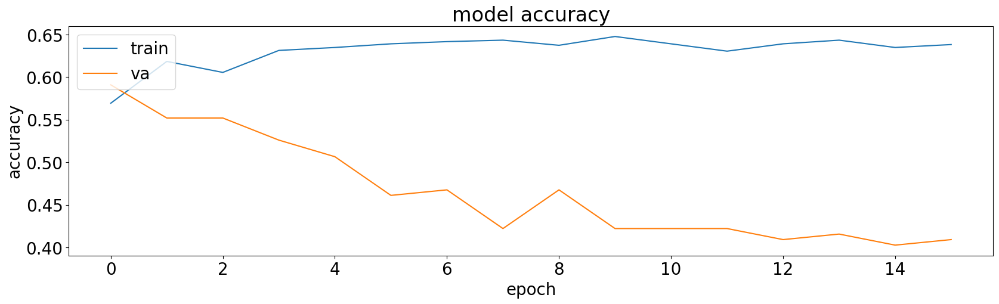

8/8 [==============================] - 1s 12ms/step


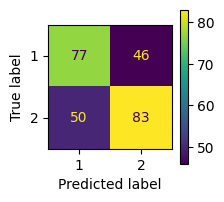

              precision    recall  f1-score   support

           1       0.61      0.63      0.62       123
           2       0.64      0.62      0.63       133

    accuracy                           0.62       256
   macro avg       0.62      0.63      0.62       256
weighted avg       0.63      0.62      0.63       256

5/5 [==============================] - 3s 492ms/step
| 119       | 0.5894    | 6.384     | 0.01602   | 1.287     | 5.43      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


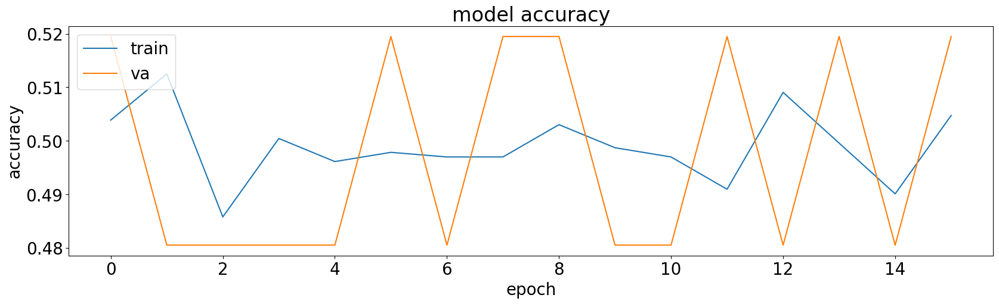

8/8 [==============================] - 2s 215ms/step


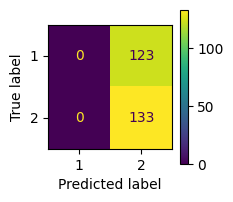

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 642ms/step
| 120       | 0.4214    | 8.86      | 0.07685   | 1.999     | 8.055     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

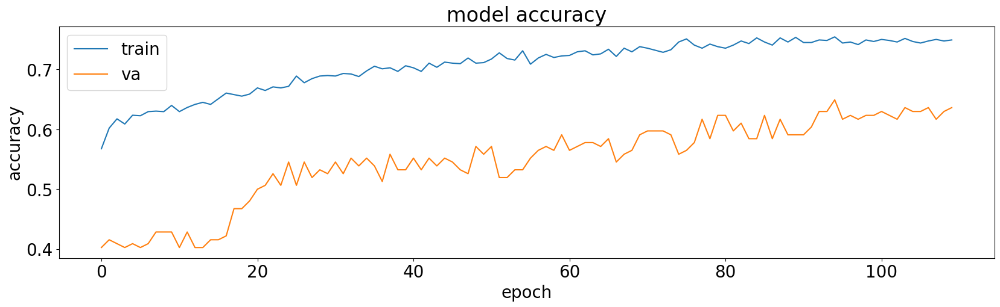

8/8 [==============================] - 1s 12ms/step


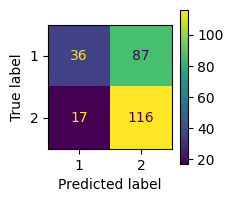

              precision    recall  f1-score   support

           1       0.68      0.29      0.41       123
           2       0.57      0.87      0.69       133

    accuracy                           0.59       256
   macro avg       0.63      0.58      0.55       256
weighted avg       0.62      0.59      0.56       256

5/5 [==============================] - 1s 12ms/step
| 121       | 0.6319    | 6.138     | 0.02504   | 0.6902    | 3.554     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


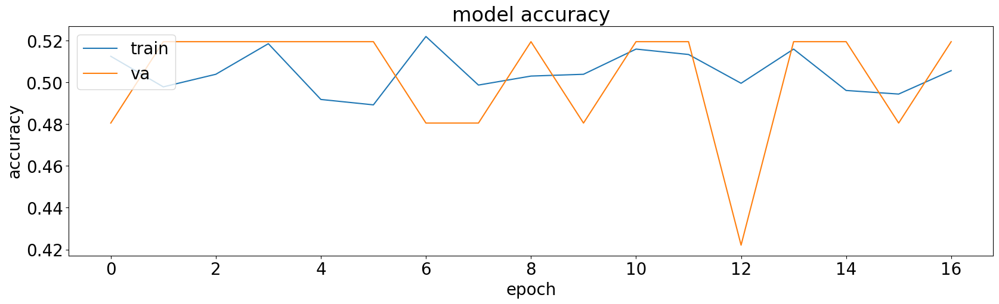

8/8 [==============================] - 1s 20ms/step


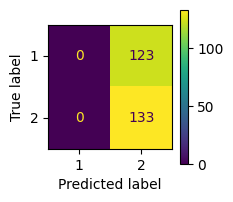

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 1s 20ms/step
| 122       | 0.4214    | 6.605     | 0.02283   | 1.629     | 15.37     |


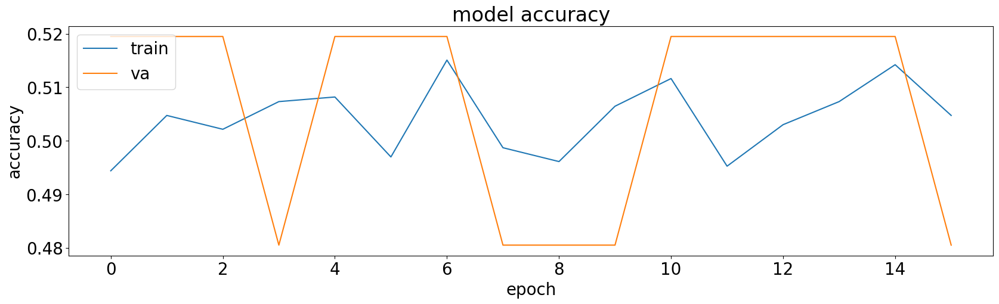

8/8 [==============================] - 3s 257ms/step


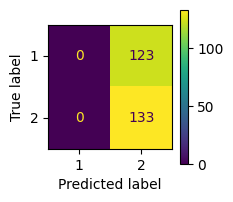

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 448ms/step
| 123       | 0.4214    | 7.582     | 0.081     | 1.58      | 13.58     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


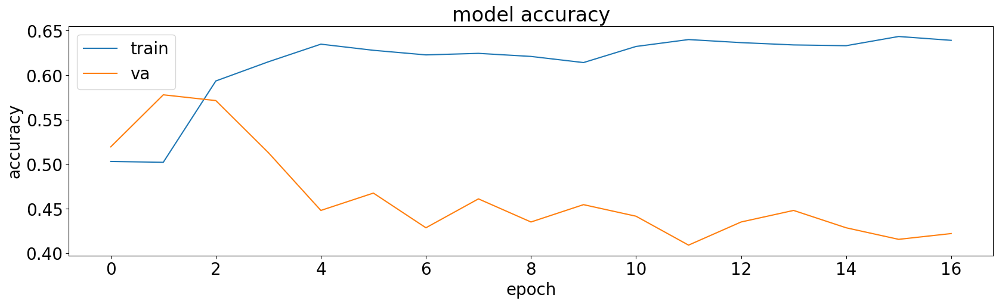

8/8 [==============================] - 2s 215ms/step


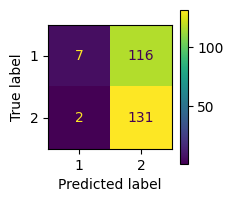

              precision    recall  f1-score   support

           1       0.78      0.06      0.11       123
           2       0.53      0.98      0.69       133

    accuracy                           0.54       256
   macro avg       0.65      0.52      0.40       256
weighted avg       0.65      0.54      0.41       256

5/5 [==============================] - 3s 306ms/step
| 124       | 0.5338    | 8.741     | 0.07213   | 1.064     | 10.31     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


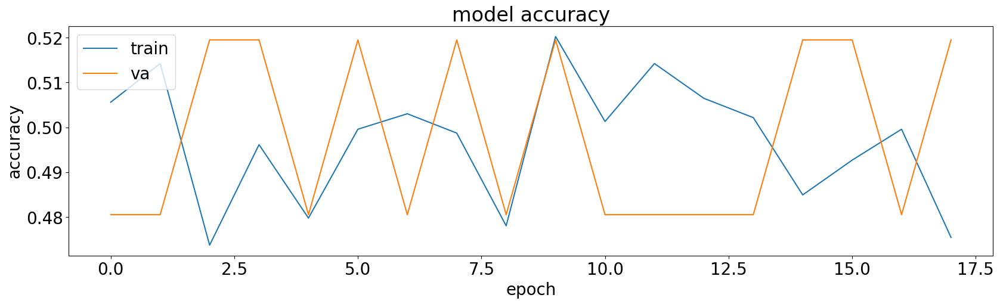

8/8 [==============================] - 2s 258ms/step


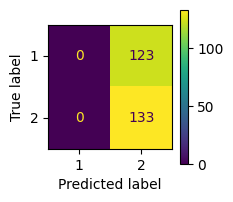

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 448ms/step
| 125       | 0.4214    | 6.207     | 0.09757   | 1.875     | 7.001     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


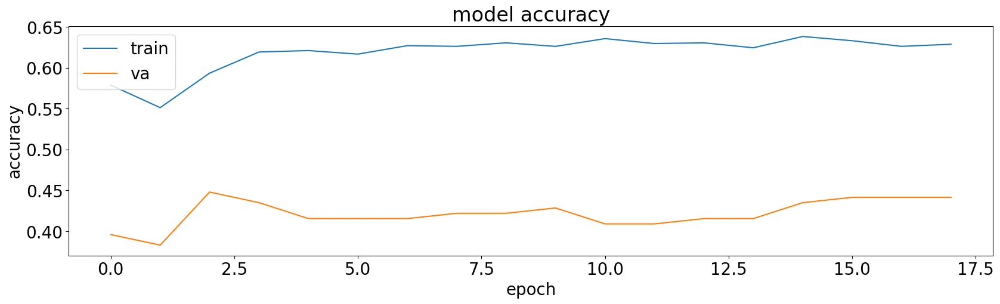

8/8 [==============================] - 3s 302ms/step


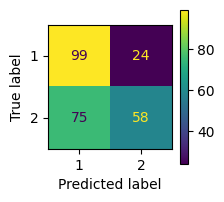

              precision    recall  f1-score   support

           1       0.57      0.80      0.67       123
           2       0.71      0.44      0.54       133

    accuracy                           0.61       256
   macro avg       0.64      0.62      0.60       256
weighted avg       0.64      0.61      0.60       256

5/5 [==============================] - 2s 439ms/step
| 126       | 0.4461    | 8.582     | 0.03189   | 1.356     | 18.08     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

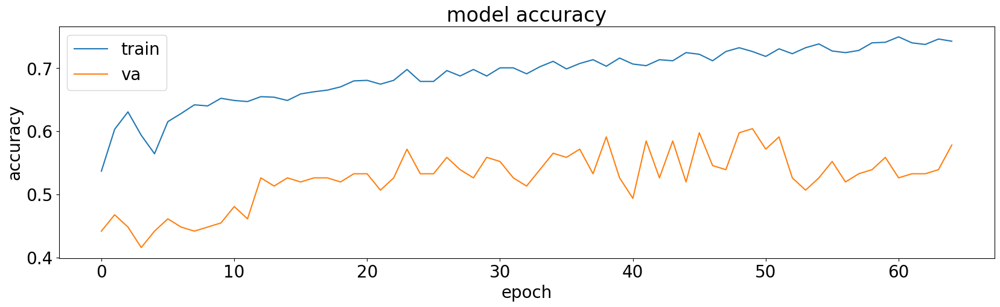

8/8 [==============================] - 2s 218ms/step


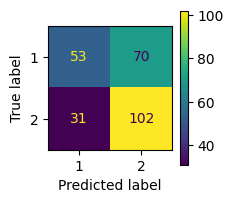

              precision    recall  f1-score   support

           1       0.63      0.43      0.51       123
           2       0.59      0.77      0.67       133

    accuracy                           0.61       256
   macro avg       0.61      0.60      0.59       256
weighted avg       0.61      0.61      0.59       256

5/5 [==============================] - 3s 520ms/step
| 127       | 0.5886    | 6.607     | 0.08036   | 0.8716    | 7.682     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


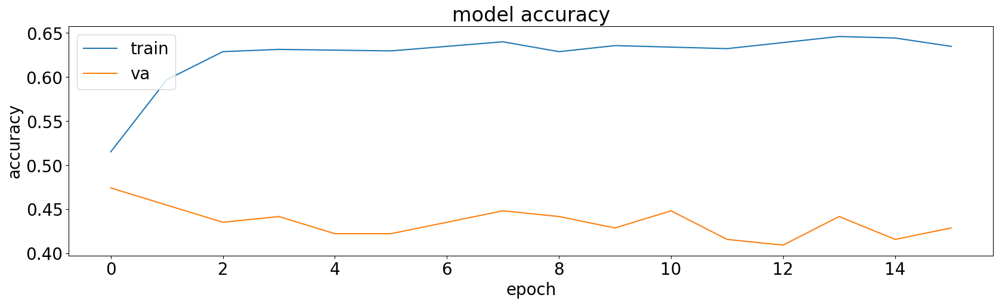

8/8 [==============================] - 1s 15ms/step


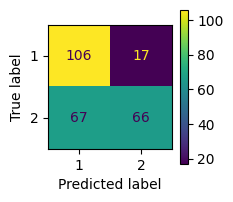

              precision    recall  f1-score   support

           1       0.61      0.86      0.72       123
           2       0.80      0.50      0.61       133

    accuracy                           0.67       256
   macro avg       0.70      0.68      0.66       256
weighted avg       0.71      0.67      0.66       256

5/5 [==============================] - 3s 425ms/step
| 128       | 0.469     | 7.812     | 0.06932   | 1.304     | 9.472     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


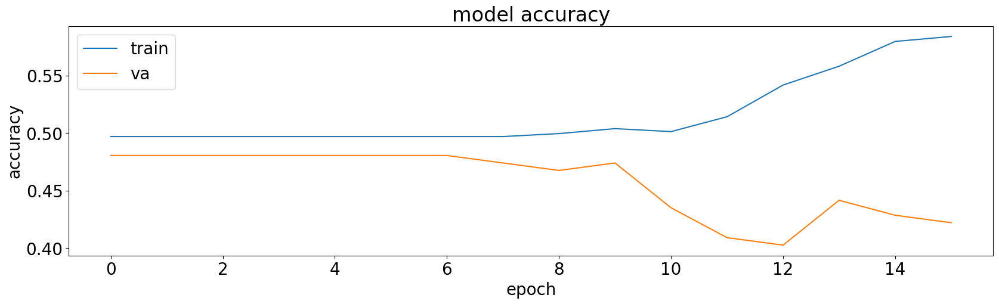

8/8 [==============================] - 1s 23ms/step


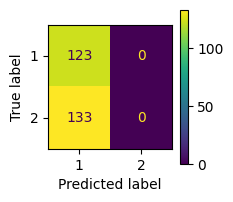

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.48      1.00      0.65       123
           2       0.00      0.00      0.00       133

    accuracy                           0.48       256
   macro avg       0.24      0.50      0.32       256
weighted avg       0.23      0.48      0.31       256

5/5 [==============================] - 1s 23ms/step
| 129       | 0.3949    | 6.564     | 0.01067   | 1.155     | 18.23     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


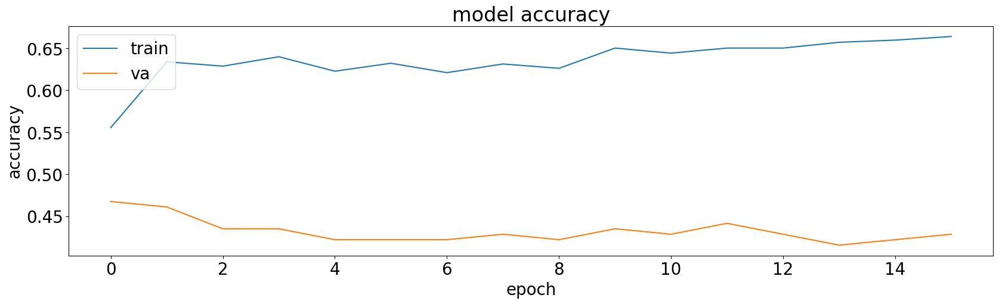

8/8 [==============================] - 2s 257ms/step


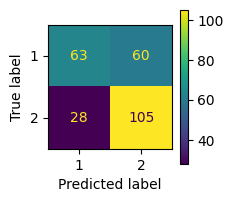

              precision    recall  f1-score   support

           1       0.69      0.51      0.59       123
           2       0.64      0.79      0.70       133

    accuracy                           0.66       256
   macro avg       0.66      0.65      0.65       256
weighted avg       0.66      0.66      0.65       256

5/5 [==============================] - 3s 582ms/step
| 130       | 0.4659    | 6.827     | 0.0399    | 1.136     | 4.153     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


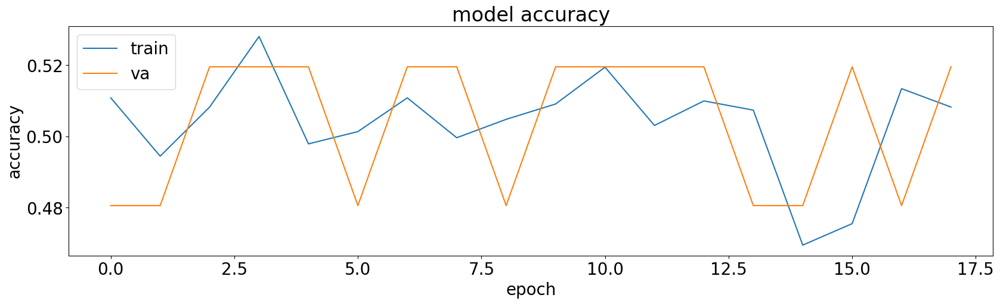

8/8 [==============================] - 2s 124ms/step


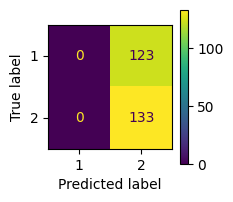

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 481ms/step
| 131       | 0.4214    | 7.006     | 0.03855   | 0.4076    | 12.96     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


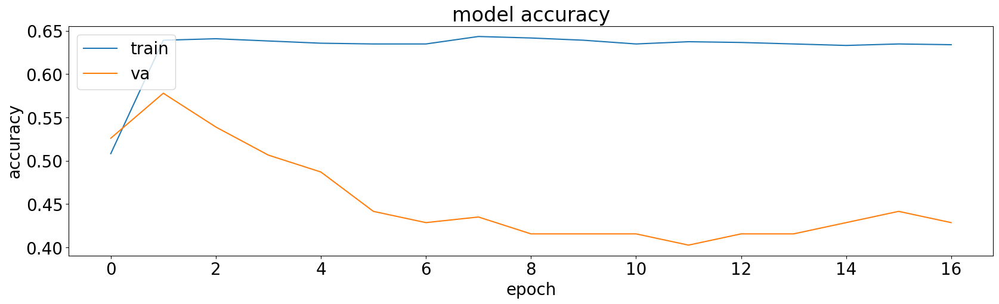

8/8 [==============================] - 2s 208ms/step


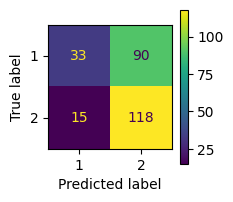

              precision    recall  f1-score   support

           1       0.69      0.27      0.39       123
           2       0.57      0.89      0.69       133

    accuracy                           0.59       256
   macro avg       0.63      0.58      0.54       256
weighted avg       0.63      0.59      0.55       256

5/5 [==============================] - 3s 461ms/step
| 132       | 0.5633    | 8.288     | 0.06617   | 0.598     | 14.35     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


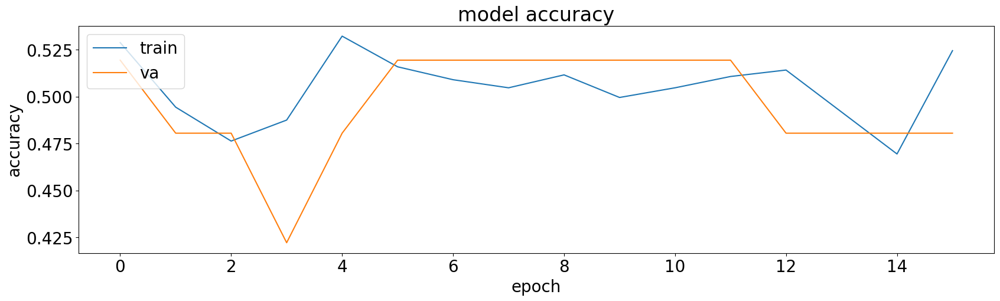

8/8 [==============================] - 3s 307ms/step


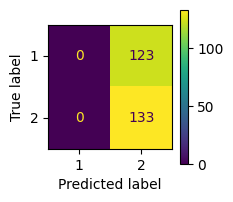

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 513ms/step
| 133       | 0.4214    | 8.236     | 0.01268   | 0.02158   | 12.61     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


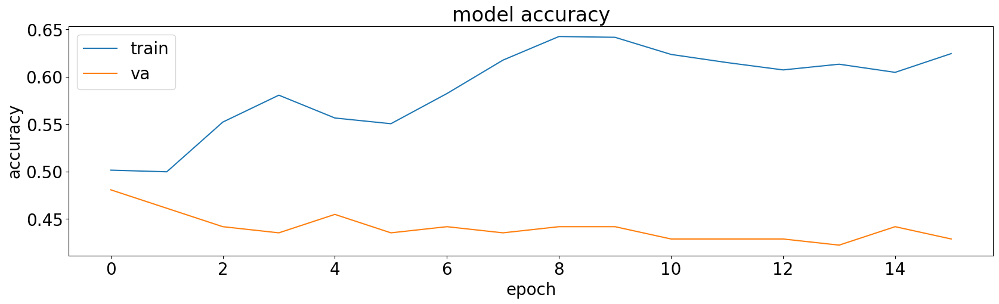

8/8 [==============================] - 1s 25ms/step


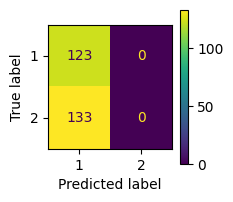

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.48      1.00      0.65       123
           2       0.00      0.00      0.00       133

    accuracy                           0.48       256
   macro avg       0.24      0.50      0.32       256
weighted avg       0.23      0.48      0.31       256

5/5 [==============================] - 3s 527ms/step
| 134       | 0.3949    | 8.866     | 0.0637    | 0.9165    | 16.68     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


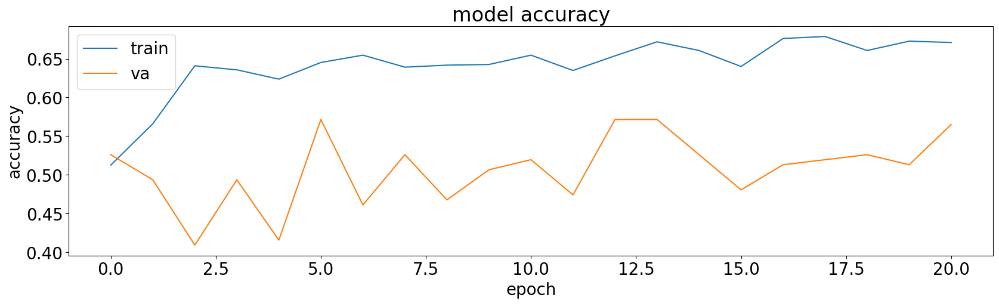

8/8 [==============================] - 3s 313ms/step


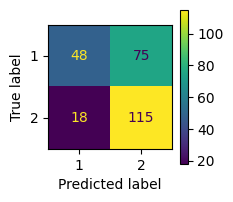

              precision    recall  f1-score   support

           1       0.73      0.39      0.51       123
           2       0.61      0.86      0.71       133

    accuracy                           0.64       256
   macro avg       0.67      0.63      0.61       256
weighted avg       0.66      0.64      0.61       256

5/5 [==============================] - 3s 515ms/step
| 135       | 0.5641    | 7.133     | 0.08998   | 0.7856    | 15.49     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


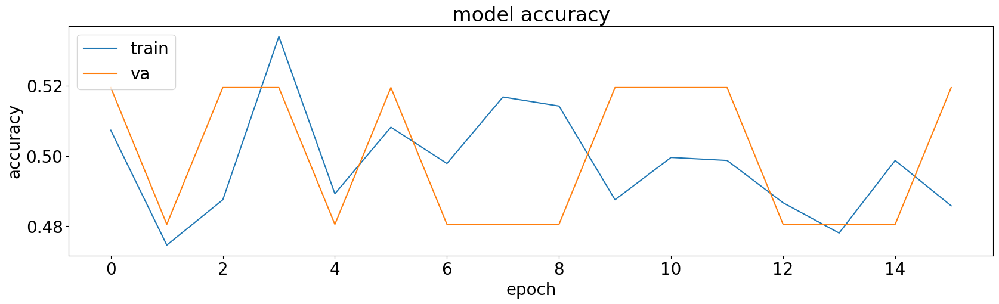

8/8 [==============================] - 3s 303ms/step


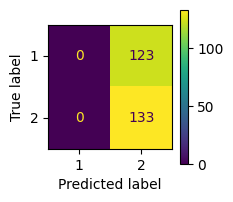

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 438ms/step
| 136       | 0.4214    | 6.715     | 0.09537   | 1.941     | 11.7      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


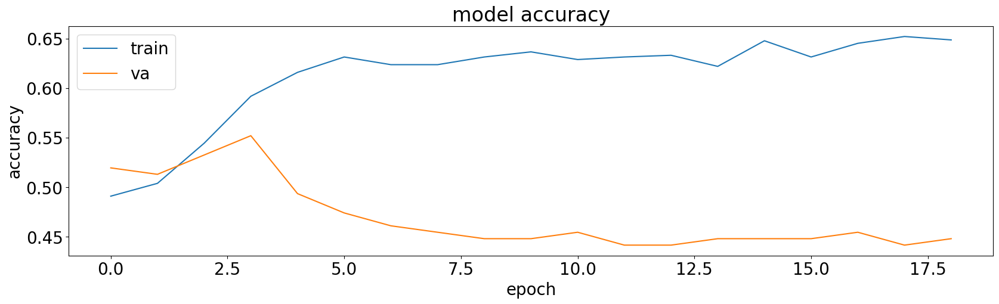

8/8 [==============================] - 2s 255ms/step


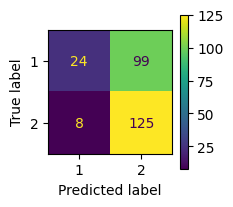

              precision    recall  f1-score   support

           1       0.75      0.20      0.31       123
           2       0.56      0.94      0.70       133

    accuracy                           0.58       256
   macro avg       0.65      0.57      0.50       256
weighted avg       0.65      0.58      0.51       256

5/5 [==============================] - 3s 608ms/step
| 137       | 0.5086    | 7.627     | 0.06307   | 0.996     | 5.288     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


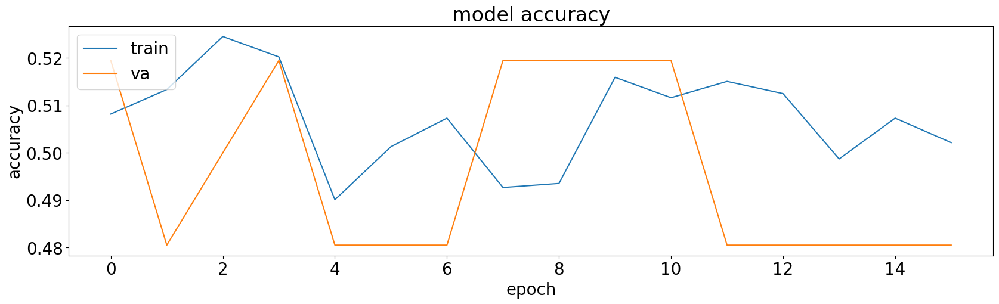

8/8 [==============================] - 3s 313ms/step


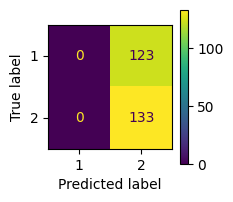

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 514ms/step
| 138       | 0.4214    | 6.33      | 0.04923   | 1.815     | 7.202     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


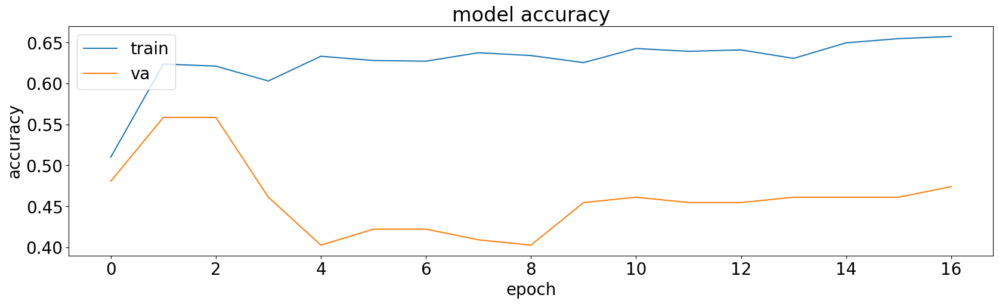

8/8 [==============================] - 2s 210ms/step


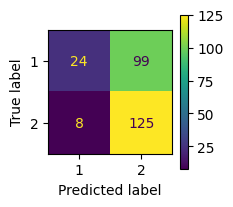

              precision    recall  f1-score   support

           1       0.75      0.20      0.31       123
           2       0.56      0.94      0.70       133

    accuracy                           0.58       256
   macro avg       0.65      0.57      0.50       256
weighted avg       0.65      0.58      0.51       256

5/5 [==============================] - 3s 616ms/step
| 139       | 0.5266    | 8.163     | 0.09178   | 1.283     | 6.083     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


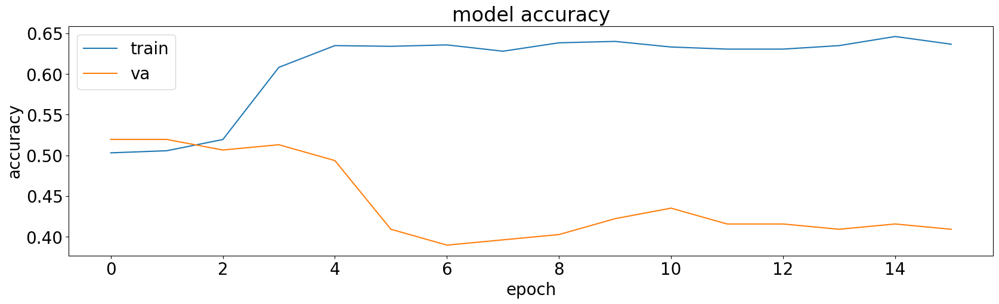

8/8 [==============================] - 2s 218ms/step


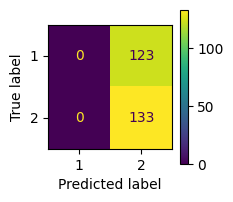

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 472ms/step
| 140       | 0.4214    | 8.115     | 0.04942   | 0.9855    | 5.561     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


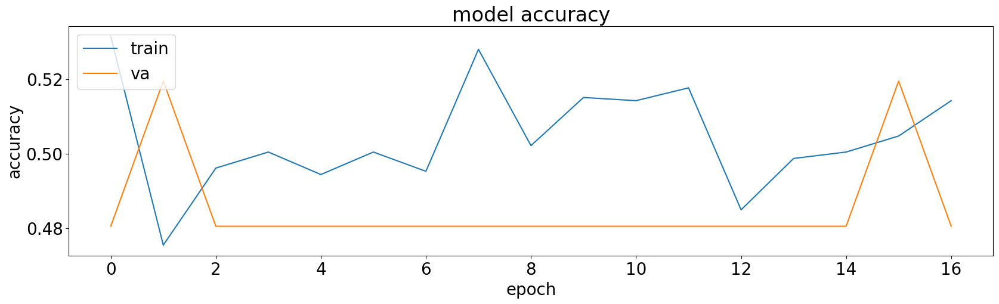

8/8 [==============================] - 1s 15ms/step


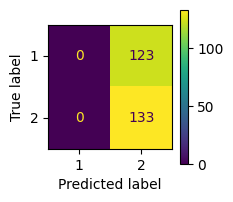

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 3s 513ms/step
| 141       | 0.4214    | 7.267     | 0.07229   | 1.68      | 9.489     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


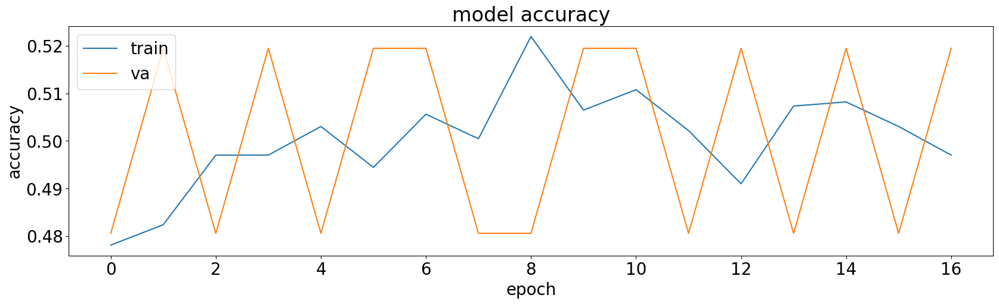

8/8 [==============================] - 2s 250ms/step


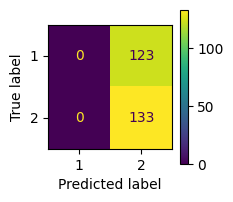

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 453ms/step
| 142       | 0.4214    | 8.777     | 0.07233   | 0.3302    | 13.93     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


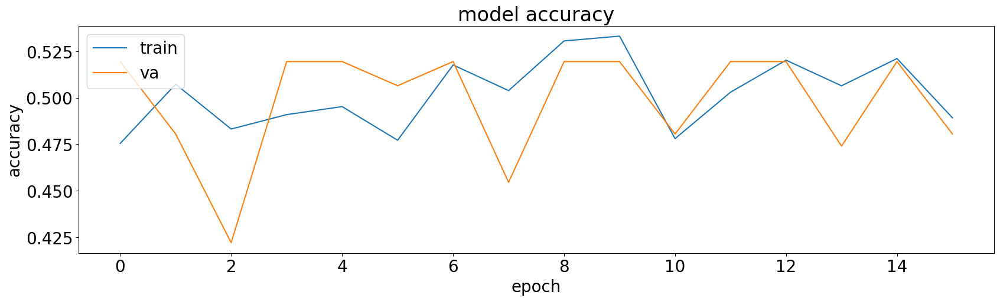

8/8 [==============================] - 3s 260ms/step


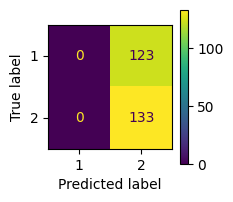

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 289ms/step
| 143       | 0.4214    | 7.482     | 0.05147   | 0.3815    | 14.02     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


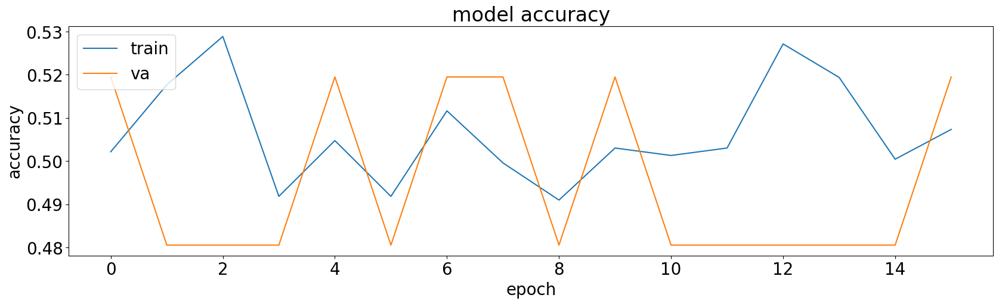

8/8 [==============================] - 2s 221ms/step


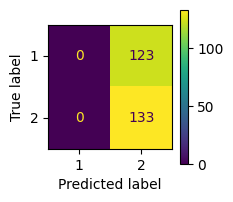

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 673ms/step
| 144       | 0.4214    | 6.584     | 0.08762   | 0.01054   | 4.16      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


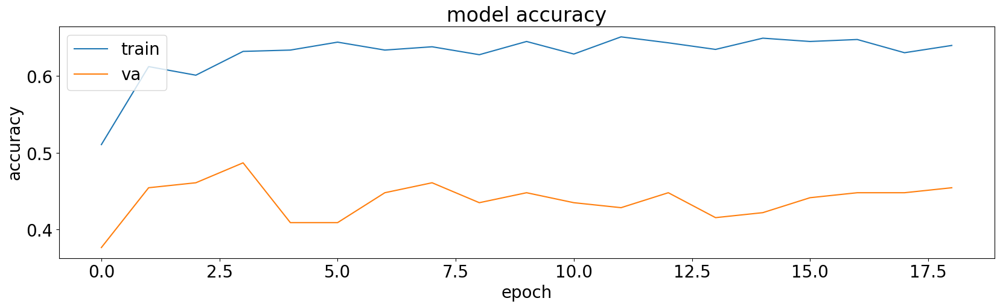

8/8 [==============================] - 3s 305ms/step


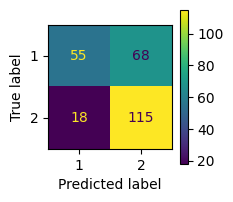

              precision    recall  f1-score   support

           1       0.75      0.45      0.56       123
           2       0.63      0.86      0.73       133

    accuracy                           0.66       256
   macro avg       0.69      0.66      0.64       256
weighted avg       0.69      0.66      0.65       256

5/5 [==============================] - 2s 289ms/step
| 145       | 0.4821    | 7.493     | 0.02609   | 1.245     | 16.86     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


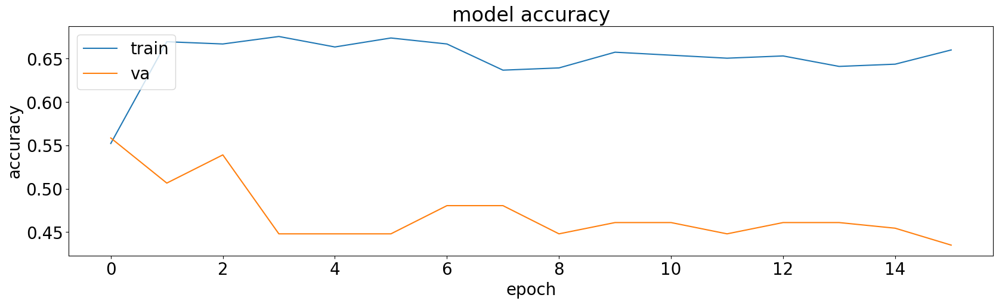

8/8 [==============================] - 3s 281ms/step


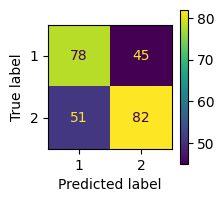

              precision    recall  f1-score   support

           1       0.60      0.63      0.62       123
           2       0.65      0.62      0.63       133

    accuracy                           0.62       256
   macro avg       0.63      0.63      0.62       256
weighted avg       0.63      0.62      0.63       256

5/5 [==============================] - 3s 635ms/step
| 146       | 0.5575    | 6.716     | 0.03131   | 0.9592    | 4.317     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


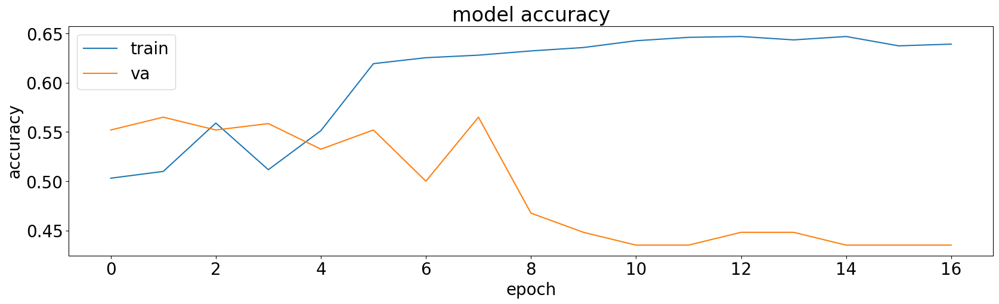

8/8 [==============================] - 3s 313ms/step


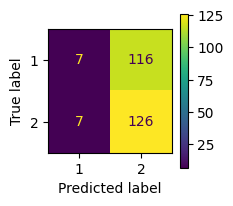

              precision    recall  f1-score   support

           1       0.50      0.06      0.10       123
           2       0.52      0.95      0.67       133

    accuracy                           0.52       256
   macro avg       0.51      0.50      0.39       256
weighted avg       0.51      0.52      0.40       256

5/5 [==============================] - 2s 417ms/step
| 147       | 0.4979    | 7.065     | 0.0115    | 0.7143    | 18.54     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


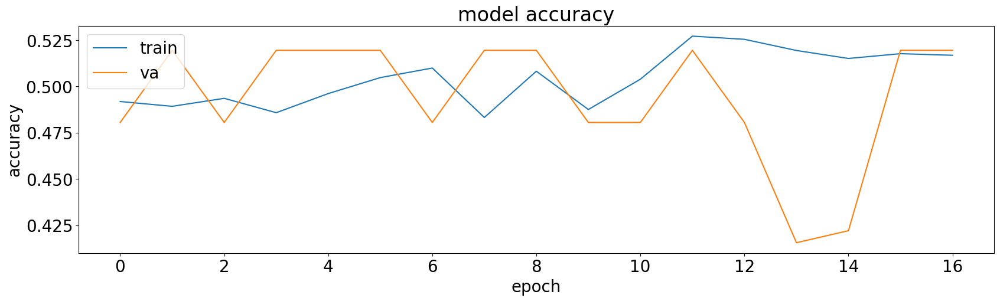

8/8 [==============================] - 3s 285ms/step


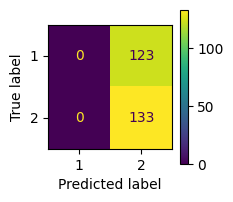

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 496ms/step
| 148       | 0.4214    | 6.738     | 0.02107   | 1.597     | 17.42     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

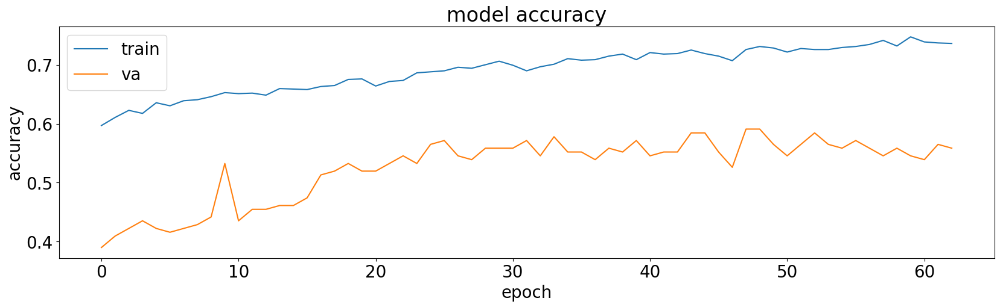

8/8 [==============================] - 2s 217ms/step


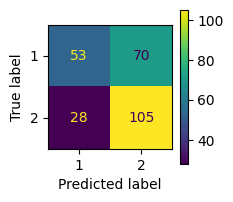

              precision    recall  f1-score   support

           1       0.65      0.43      0.52       123
           2       0.60      0.79      0.68       133

    accuracy                           0.62       256
   macro avg       0.63      0.61      0.60       256
weighted avg       0.63      0.62      0.60       256

5/5 [==============================] - 2s 440ms/step
| 149       | 0.5782    | 6.473     | 0.04654   | 0.8875    | 3.005     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


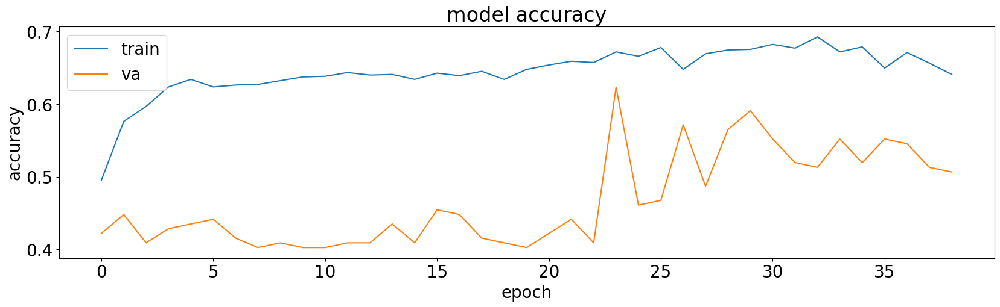

8/8 [==============================] - 2s 256ms/step


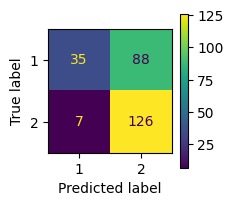

              precision    recall  f1-score   support

           1       0.83      0.28      0.42       123
           2       0.59      0.95      0.73       133

    accuracy                           0.63       256
   macro avg       0.71      0.62      0.58       256
weighted avg       0.71      0.63      0.58       256

5/5 [==============================] - 2s 306ms/step
| 150       | 0.6081    | 7.93      | 0.08011   | 0.578     | 9.813     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


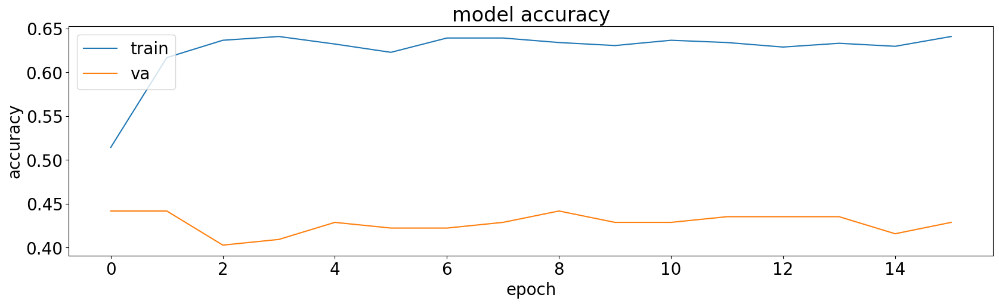

8/8 [==============================] - 3s 388ms/step


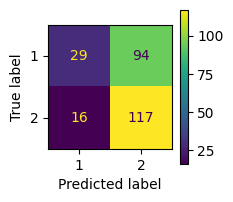

              precision    recall  f1-score   support

           1       0.64      0.24      0.35       123
           2       0.55      0.88      0.68       133

    accuracy                           0.57       256
   macro avg       0.60      0.56      0.51       256
weighted avg       0.60      0.57      0.52       256

5/5 [==============================] - 3s 425ms/step
| 151       | 0.4133    | 7.258     | 0.03261   | 1.326     | 12.15     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


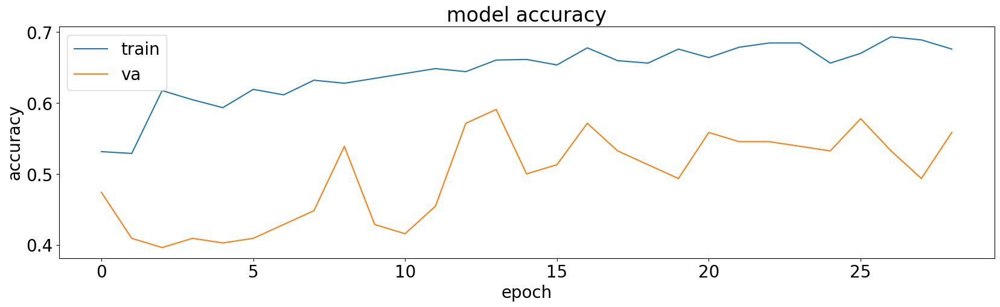

8/8 [==============================] - 3s 302ms/step


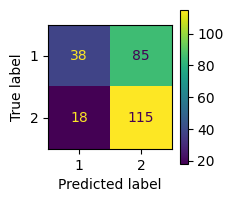

              precision    recall  f1-score   support

           1       0.68      0.31      0.42       123
           2       0.57      0.86      0.69       133

    accuracy                           0.60       256
   macro avg       0.63      0.59      0.56       256
weighted avg       0.62      0.60      0.56       256

5/5 [==============================] - 3s 542ms/step
| 152       | 0.5797    | 7.251     | 0.088     | 0.5608    | 13.67     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

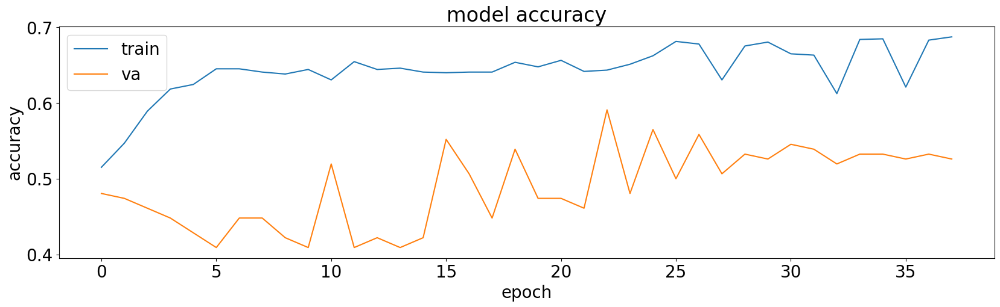

8/8 [==============================] - 3s 303ms/step


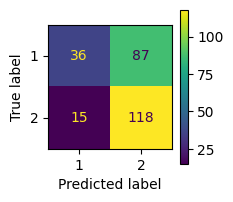

              precision    recall  f1-score   support

           1       0.71      0.29      0.41       123
           2       0.58      0.89      0.70       133

    accuracy                           0.60       256
   macro avg       0.64      0.59      0.56       256
weighted avg       0.64      0.60      0.56       256

5/5 [==============================] - 2s 412ms/step
| 153       | 0.5734    | 7.941     | 0.08721   | 1.103     | 16.23     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


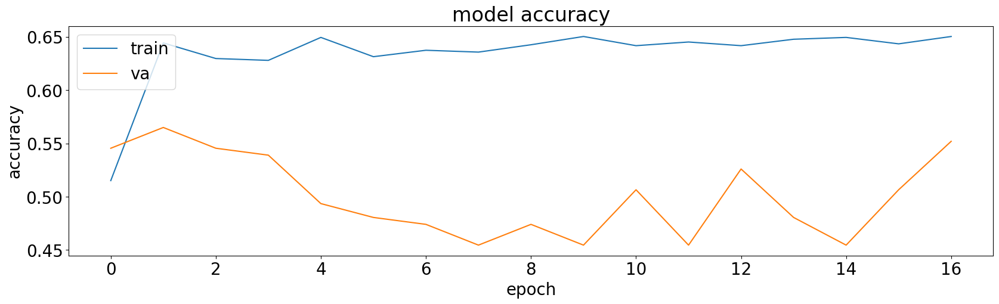

8/8 [==============================] - 1s 13ms/step


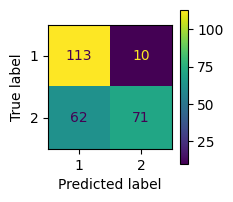

              precision    recall  f1-score   support

           1       0.65      0.92      0.76       123
           2       0.88      0.53      0.66       133

    accuracy                           0.72       256
   macro avg       0.76      0.73      0.71       256
weighted avg       0.77      0.72      0.71       256

5/5 [==============================] - 1s 12ms/step
| 154       | 0.5608    | 6.547     | 0.04699   | 0.9663    | 6.612     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


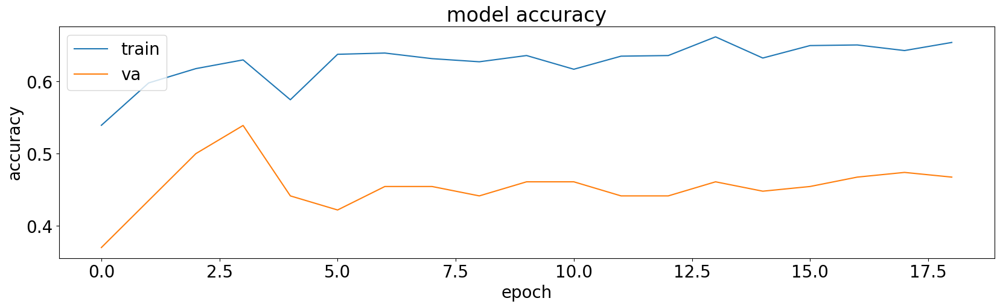

8/8 [==============================] - 3s 312ms/step


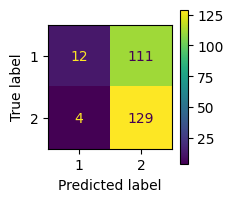

              precision    recall  f1-score   support

           1       0.75      0.10      0.17       123
           2       0.54      0.97      0.69       133

    accuracy                           0.55       256
   macro avg       0.64      0.53      0.43       256
weighted avg       0.64      0.55      0.44       256

5/5 [==============================] - 3s 516ms/step
| 155       | 0.4821    | 6.534     | 0.0602    | 0.8696    | 12.31     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


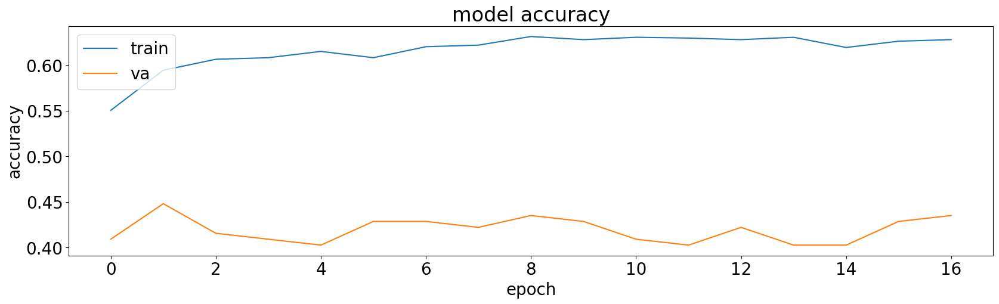

8/8 [==============================] - 2s 209ms/step


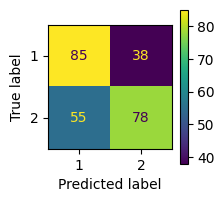

              precision    recall  f1-score   support

           1       0.61      0.69      0.65       123
           2       0.67      0.59      0.63       133

    accuracy                           0.64       256
   macro avg       0.64      0.64      0.64       256
weighted avg       0.64      0.64      0.64       256

5/5 [==============================] - 2s 438ms/step
| 156       | 0.4475    | 6.286     | 0.0105    | 0.6278    | 18.58     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


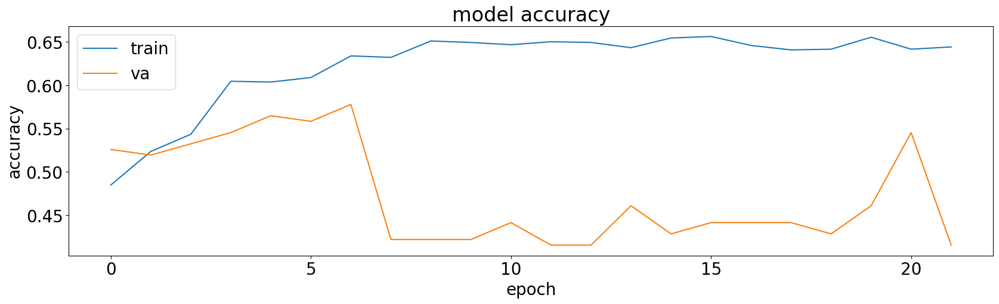

8/8 [==============================] - 3s 311ms/step


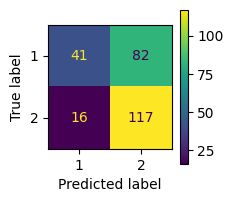

              precision    recall  f1-score   support

           1       0.72      0.33      0.46       123
           2       0.59      0.88      0.70       133

    accuracy                           0.62       256
   macro avg       0.65      0.61      0.58       256
weighted avg       0.65      0.62      0.59       256

5/5 [==============================] - 3s 523ms/step
| 157       | 0.5633    | 8.652     | 0.09238   | 1.058     | 18.33     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

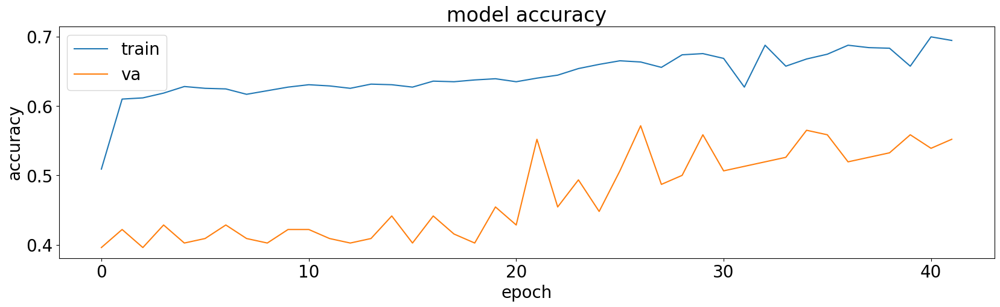

8/8 [==============================] - 2s 175ms/step


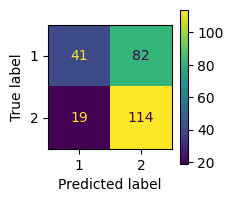

              precision    recall  f1-score   support

           1       0.68      0.33      0.45       123
           2       0.58      0.86      0.69       133

    accuracy                           0.61       256
   macro avg       0.63      0.60      0.57       256
weighted avg       0.63      0.61      0.58       256

5/5 [==============================] - 3s 490ms/step
| 158       | 0.5641    | 7.719     | 0.0887    | 0.9033    | 10.34     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


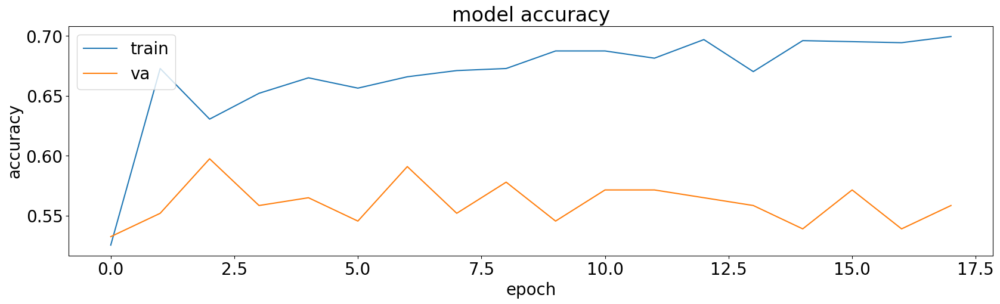

8/8 [==============================] - 3s 349ms/step


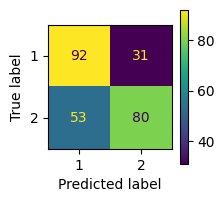

              precision    recall  f1-score   support

           1       0.63      0.75      0.69       123
           2       0.72      0.60      0.66       133

    accuracy                           0.67       256
   macro avg       0.68      0.67      0.67       256
weighted avg       0.68      0.67      0.67       256

5/5 [==============================] - 3s 451ms/step
| 159       | 0.5974    | 6.391     | 0.06983   | 0.6244    | 2.311     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


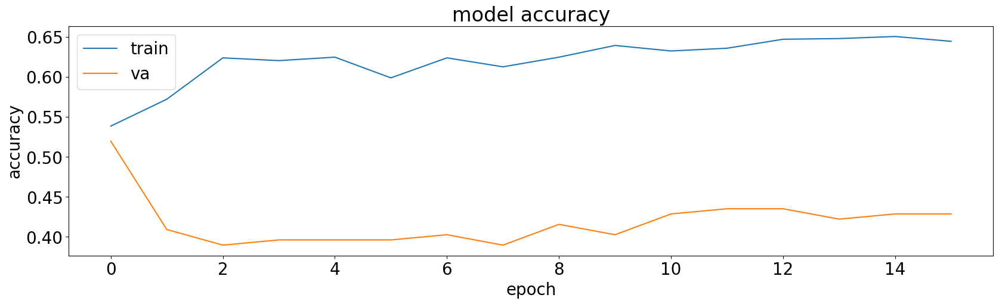

8/8 [==============================] - 3s 387ms/step


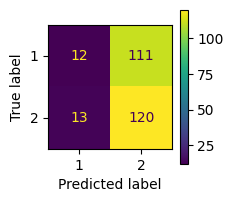

              precision    recall  f1-score   support

           1       0.48      0.10      0.16       123
           2       0.52      0.90      0.66       133

    accuracy                           0.52       256
   macro avg       0.50      0.50      0.41       256
weighted avg       0.50      0.52      0.42       256

5/5 [==============================] - 3s 495ms/step
| 160       | 0.4707    | 8.315     | 0.05191   | 1.157     | 8.585     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


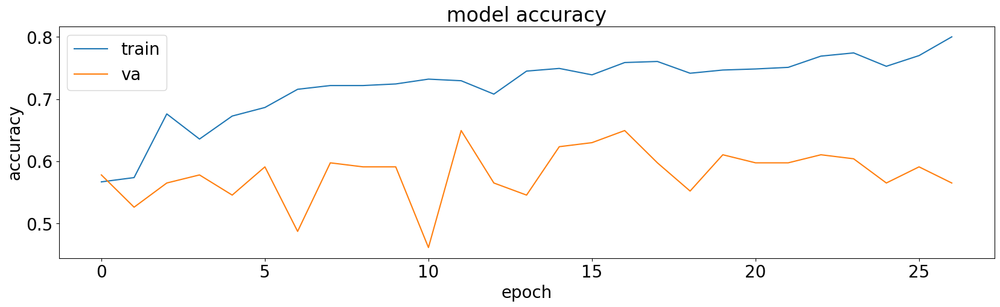

8/8 [==============================] - 1s 13ms/step


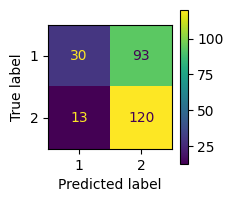

              precision    recall  f1-score   support

           1       0.70      0.24      0.36       123
           2       0.56      0.90      0.69       133

    accuracy                           0.59       256
   macro avg       0.63      0.57      0.53       256
weighted avg       0.63      0.59      0.53       256

5/5 [==============================] - 1s 13ms/step
| 161       | 0.6302    | 6.481     | 0.009087  | 1.865     | 8.481     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


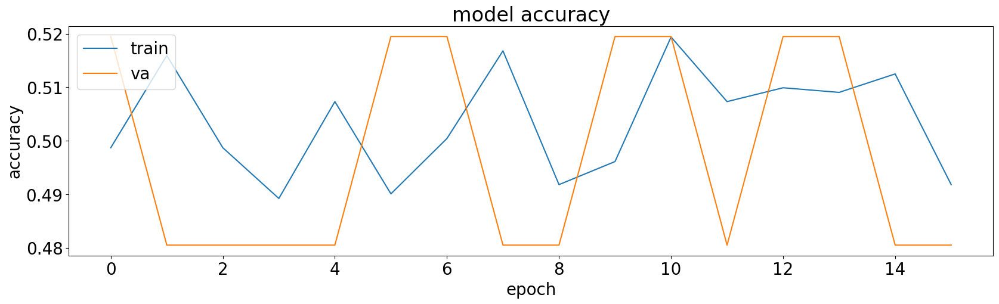

8/8 [==============================] - 2s 163ms/step


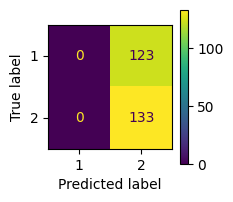

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 287ms/step
| 162       | 0.4214    | 6.218     | 0.02336   | 1.876     | 12.69     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


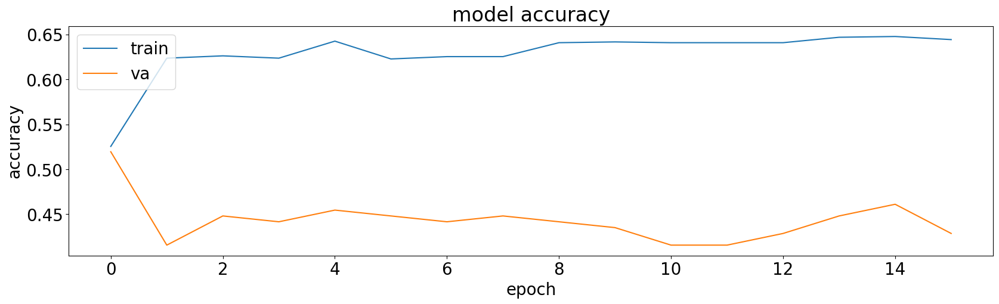

8/8 [==============================] - 2s 214ms/step


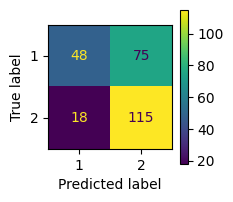

              precision    recall  f1-score   support

           1       0.73      0.39      0.51       123
           2       0.61      0.86      0.71       133

    accuracy                           0.64       256
   macro avg       0.67      0.63      0.61       256
weighted avg       0.66      0.64      0.61       256

5/5 [==============================] - 2s 435ms/step
| 163       | 0.5145    | 7.748     | 0.08127   | 1.277     | 17.05     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


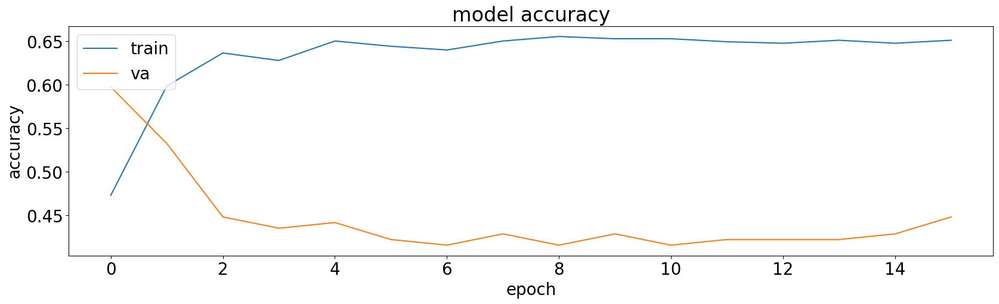

8/8 [==============================] - 2s 213ms/step


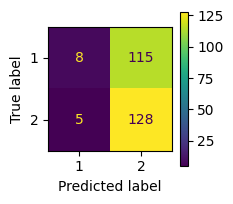

              precision    recall  f1-score   support

           1       0.62      0.07      0.12       123
           2       0.53      0.96      0.68       133

    accuracy                           0.53       256
   macro avg       0.57      0.51      0.40       256
weighted avg       0.57      0.53      0.41       256

5/5 [==============================] - 2s 282ms/step
| 164       | 0.5538    | 7.714     | 0.07935   | 1.364     | 13.24     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


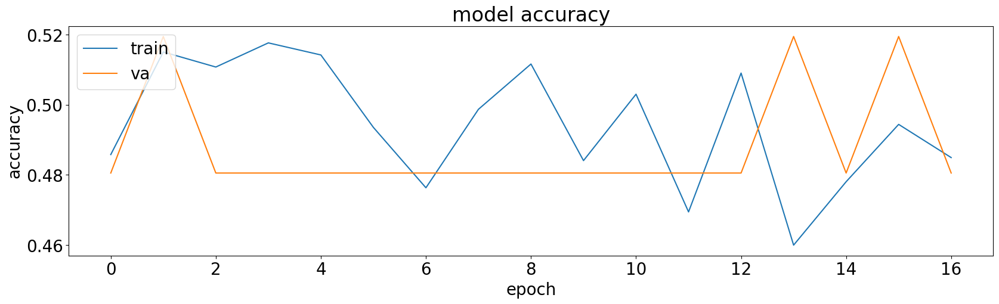

8/8 [==============================] - 2s 209ms/step


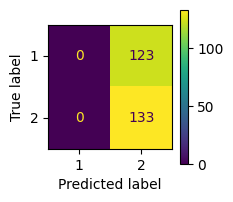

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 501ms/step
| 165       | 0.4214    | 6.752     | 0.07548   | 1.653     | 13.19     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


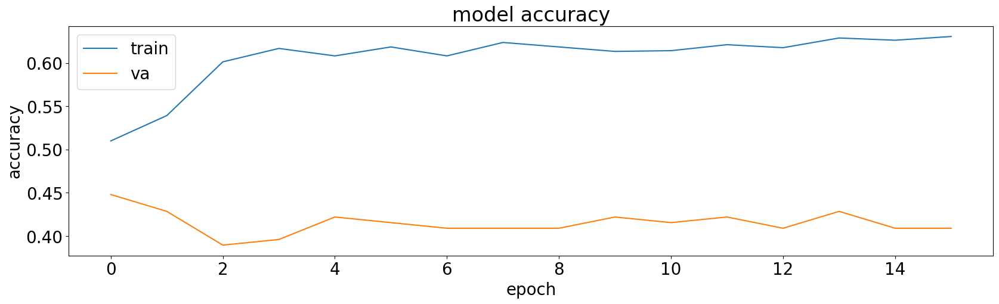

8/8 [==============================] - 1s 18ms/step


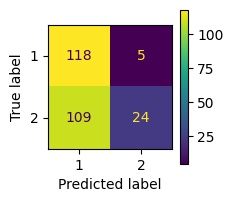

              precision    recall  f1-score   support

           1       0.52      0.96      0.67       123
           2       0.83      0.18      0.30       133

    accuracy                           0.55       256
   macro avg       0.67      0.57      0.49       256
weighted avg       0.68      0.55      0.48       256

5/5 [==============================] - 1s 17ms/step
| 166       | 0.3978    | 6.155     | 0.02946   | 0.754     | 12.02     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


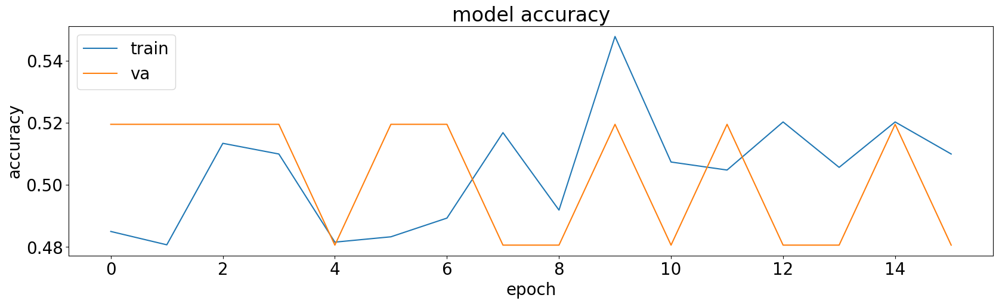

8/8 [==============================] - 2s 215ms/step


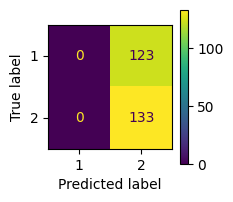

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 428ms/step
| 167       | 0.4214    | 7.006     | 0.07144   | 0.4725    | 17.52     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


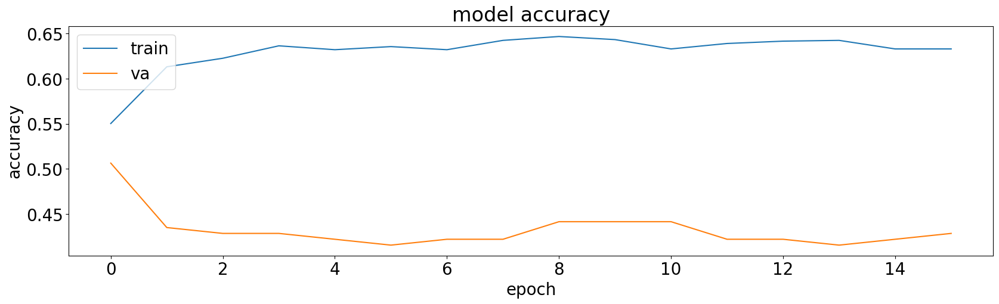

8/8 [==============================] - 1s 20ms/step


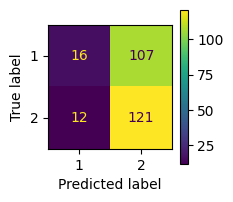

              precision    recall  f1-score   support

           1       0.57      0.13      0.21       123
           2       0.53      0.91      0.67       133

    accuracy                           0.54       256
   macro avg       0.55      0.52      0.44       256
weighted avg       0.55      0.54      0.45       256

5/5 [==============================] - 3s 532ms/step
| 168       | 0.4841    | 7.718     | 0.06137   | 1.381     | 14.95     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


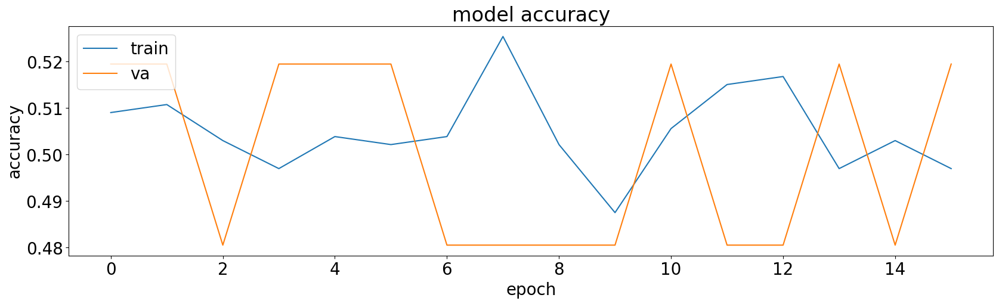

8/8 [==============================] - 2s 233ms/step


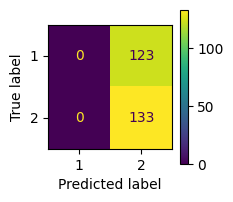

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 529ms/step
| 169       | 0.4214    | 8.914     | 0.04734   | 1.939     | 15.85     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


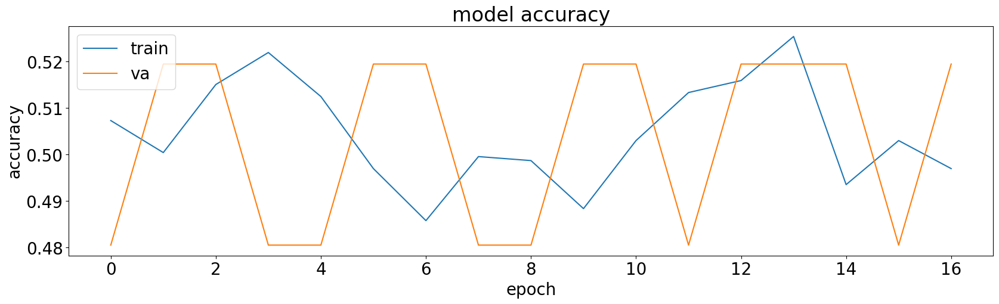

8/8 [==============================] - 3s 312ms/step


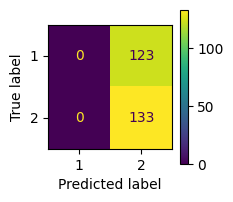

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 530ms/step
| 170       | 0.4214    | 8.189     | 0.06314   | 1.678     | 15.65     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


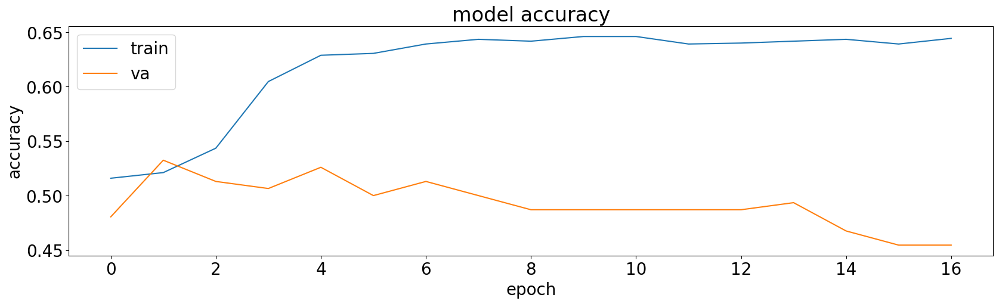

8/8 [==============================] - 3s 308ms/step


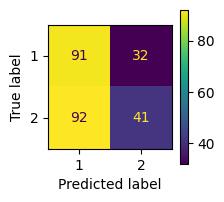

              precision    recall  f1-score   support

           1       0.50      0.74      0.59       123
           2       0.56      0.31      0.40       133

    accuracy                           0.52       256
   macro avg       0.53      0.52      0.50       256
weighted avg       0.53      0.52      0.49       256

5/5 [==============================] - 3s 689ms/step
| 171       | 0.5133    | 8.191     | 0.02554   | 1.486     | 2.782     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


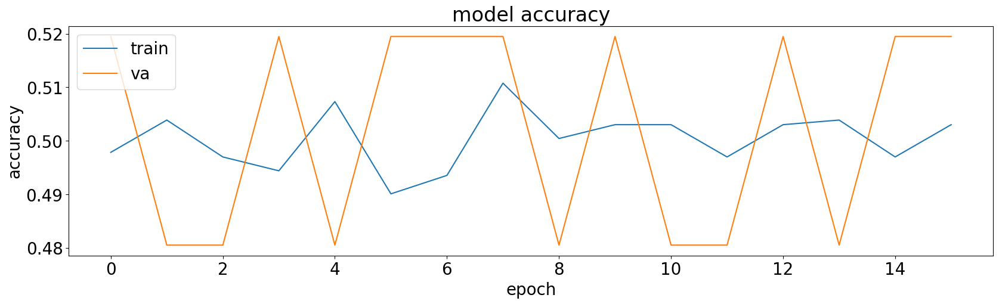

8/8 [==============================] - 1s 27ms/step


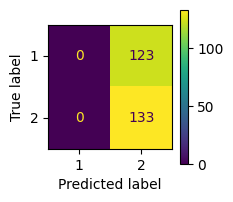

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256

5/5 [==============================] - 1s 25ms/step
| 172       | 0.4214    | 8.717     | 0.02952   | 0.1103    | 18.82     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


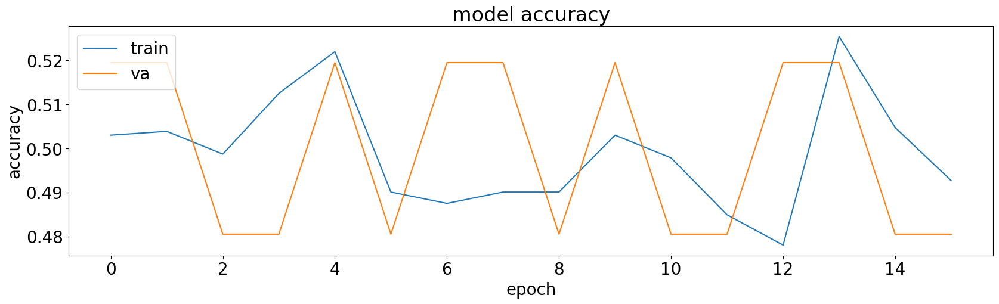

8/8 [==============================] - 3s 300ms/step


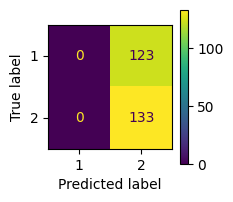

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 445ms/step
| 173       | 0.4214    | 8.344     | 0.03368   | 0.4071    | 19.0      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


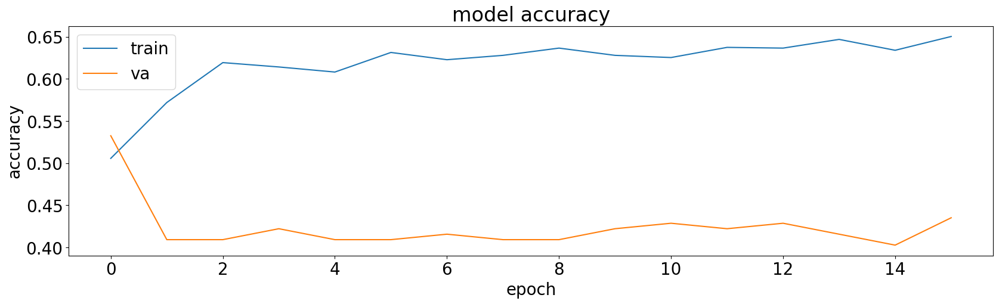

8/8 [==============================] - 3s 265ms/step


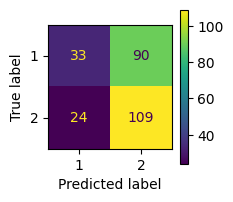

              precision    recall  f1-score   support

           1       0.58      0.27      0.37       123
           2       0.55      0.82      0.66       133

    accuracy                           0.55       256
   macro avg       0.56      0.54      0.51       256
weighted avg       0.56      0.55      0.52       256

5/5 [==============================] - 1s 16ms/step
| 174       | 0.5113    | 7.937     | 0.08762   | 0.6114    | 9.793     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


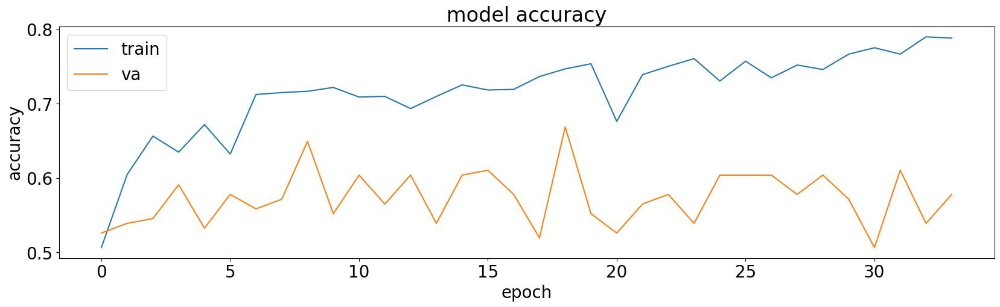

8/8 [==============================] - 2s 169ms/step


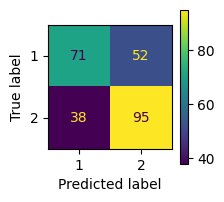

              precision    recall  f1-score   support

           1       0.65      0.58      0.61       123
           2       0.65      0.71      0.68       133

    accuracy                           0.65       256
   macro avg       0.65      0.65      0.65       256
weighted avg       0.65      0.65      0.65       256

5/5 [==============================] - 3s 504ms/step
| 175       | 0.6676    | 7.153     | 0.00463   | 0.1285    | 5.881     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


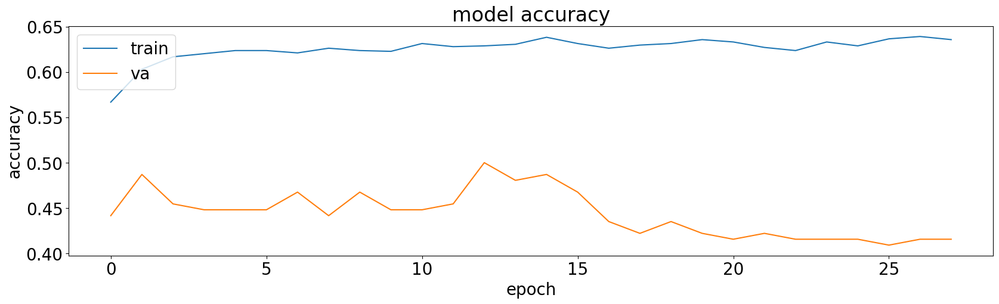

8/8 [==============================] - 3s 251ms/step


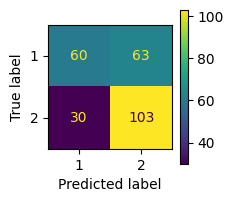

              precision    recall  f1-score   support

           1       0.67      0.49      0.56       123
           2       0.62      0.77      0.69       133

    accuracy                           0.64       256
   macro avg       0.64      0.63      0.63       256
weighted avg       0.64      0.64      0.63       256

5/5 [==============================] - 2s 438ms/step
| 176       | 0.4969    | 8.415     | 0.03198   | 0.752     | 6.683     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


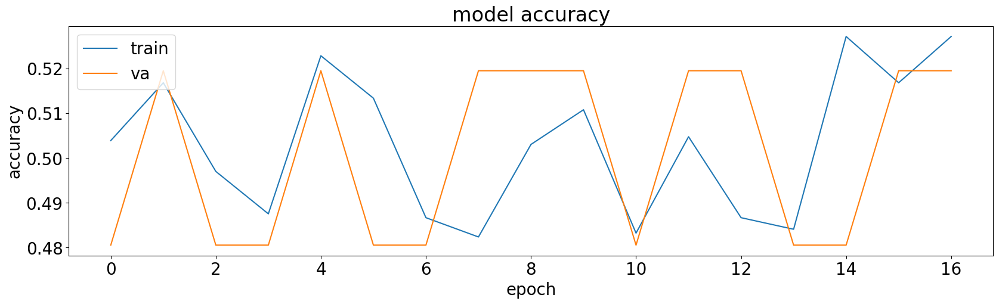

8/8 [==============================] - 3s 240ms/step


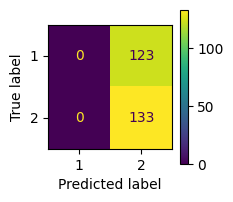

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 492ms/step
| 177       | 0.4214    | 6.515     | 0.0758    | 1.568     | 11.43     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


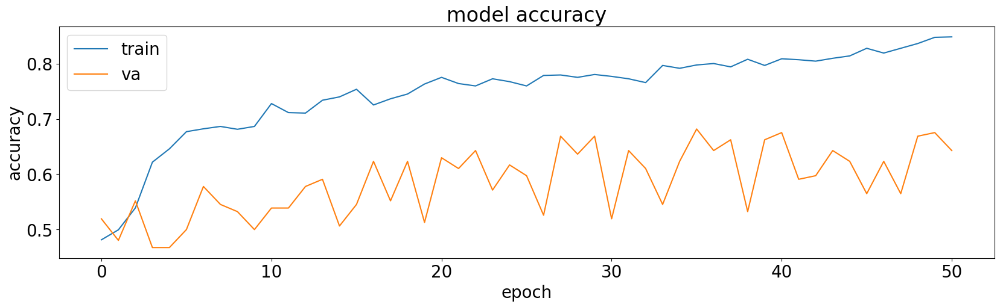

8/8 [==============================] - 1s 12ms/step


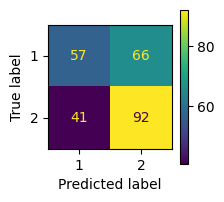

              precision    recall  f1-score   support

           1       0.58      0.46      0.52       123
           2       0.58      0.69      0.63       133

    accuracy                           0.58       256
   macro avg       0.58      0.58      0.57       256
weighted avg       0.58      0.58      0.58       256

5/5 [==============================] - 2s 346ms/step
| 178       | 0.6818    | 7.704     | 0.009662  | 1.64      | 3.462     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


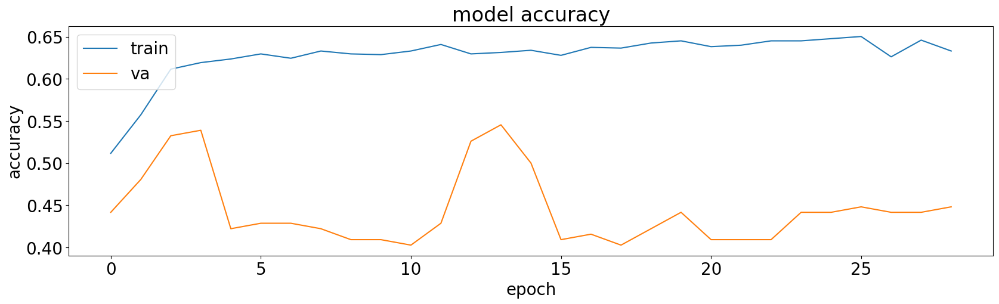

8/8 [==============================] - 3s 299ms/step


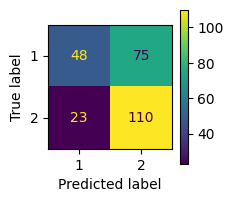

              precision    recall  f1-score   support

           1       0.68      0.39      0.49       123
           2       0.59      0.83      0.69       133

    accuracy                           0.62       256
   macro avg       0.64      0.61      0.59       256
weighted avg       0.63      0.62      0.60       256

5/5 [==============================] - 3s 529ms/step
| 179       | 0.5398    | 6.971     | 0.02161   | 0.827     | 15.53     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

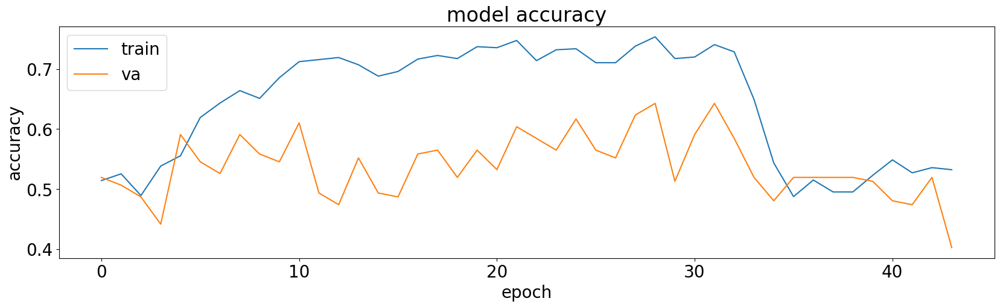

8/8 [==============================] - 1s 18ms/step


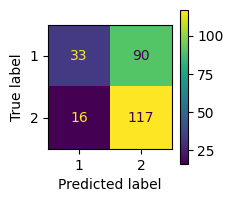

              precision    recall  f1-score   support

           1       0.67      0.27      0.38       123
           2       0.57      0.88      0.69       133

    accuracy                           0.59       256
   macro avg       0.62      0.57      0.54       256
weighted avg       0.62      0.59      0.54       256

5/5 [==============================] - 1s 18ms/step
| 180       | 0.6305    | 7.575     | 0.009503  | 0.1477    | 11.57     |


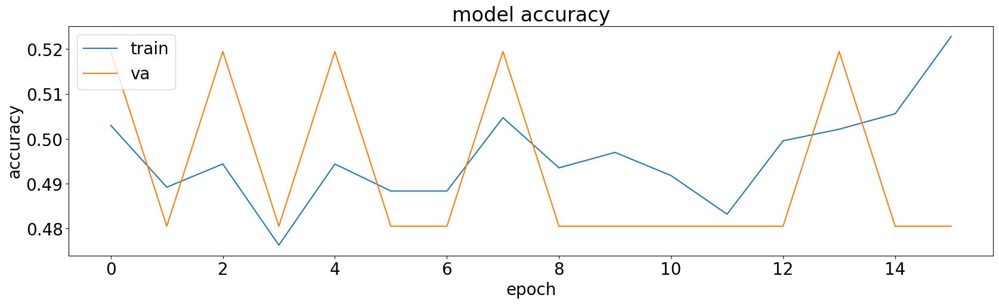

8/8 [==============================] - 1s 12ms/step


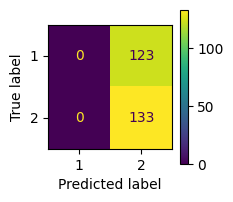

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 362ms/step
| 181       | 0.4214    | 6.856     | 0.07449   | 1.711     | 4.513     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

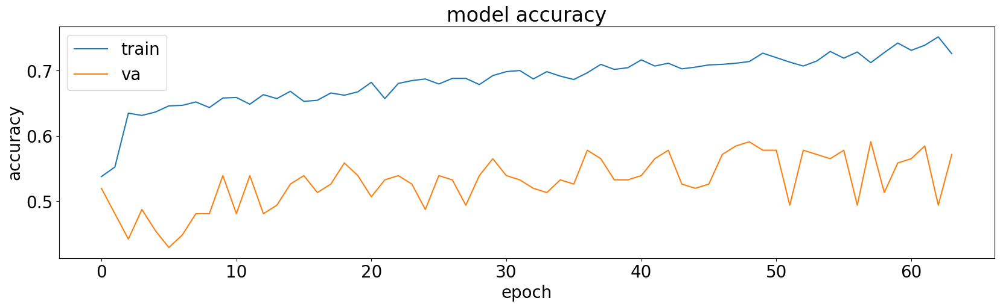

8/8 [==============================] - 2s 204ms/step


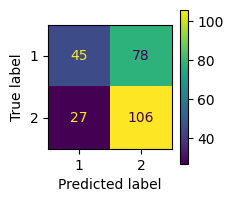

              precision    recall  f1-score   support

           1       0.62      0.37      0.46       123
           2       0.58      0.80      0.67       133

    accuracy                           0.59       256
   macro avg       0.60      0.58      0.57       256
weighted avg       0.60      0.59      0.57       256

5/5 [==============================] - 3s 624ms/step
| 182       | 0.5734    | 7.388     | 0.07294   | 0.5974    | 8.516     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


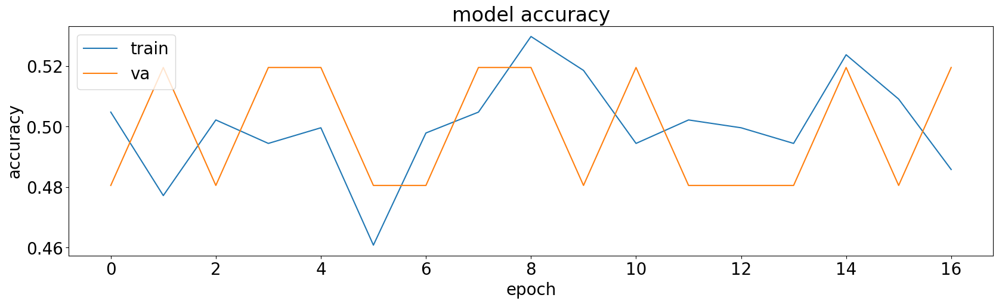

8/8 [==============================] - 3s 307ms/step


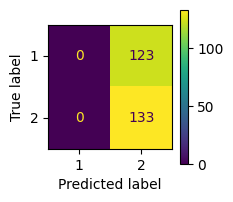

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 368ms/step
| 183       | 0.4214    | 7.161     | 0.0605    | 1.524     | 8.735     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


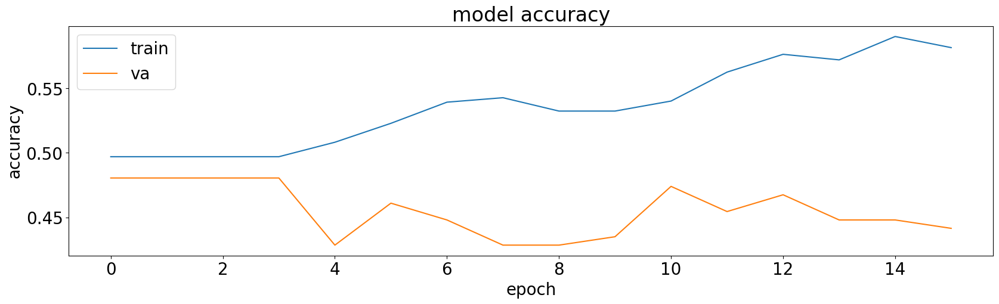

8/8 [==============================] - 2s 220ms/step


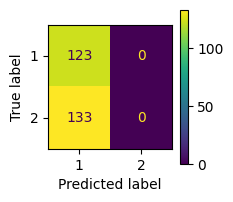

              precision    recall  f1-score   support

           1       0.48      1.00      0.65       123
           2       0.00      0.00      0.00       133

    accuracy                           0.48       256
   macro avg       0.24      0.50      0.32       256
weighted avg       0.23      0.48      0.31       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 281ms/step
| 184       | 0.3949    | 7.237     | 0.01848   | 1.004     | 18.72     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


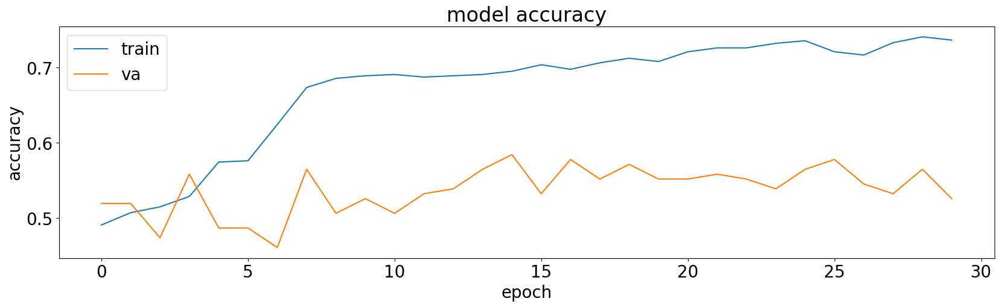

8/8 [==============================] - 1s 12ms/step


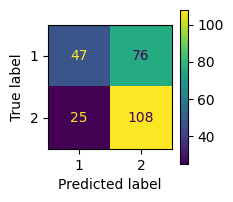

              precision    recall  f1-score   support

           1       0.65      0.38      0.48       123
           2       0.59      0.81      0.68       133

    accuracy                           0.61       256
   macro avg       0.62      0.60      0.58       256
weighted avg       0.62      0.61      0.59       256

5/5 [==============================] - 3s 493ms/step
| 185       | 0.5656    | 7.603     | 0.03652   | 1.966     | 2.526     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


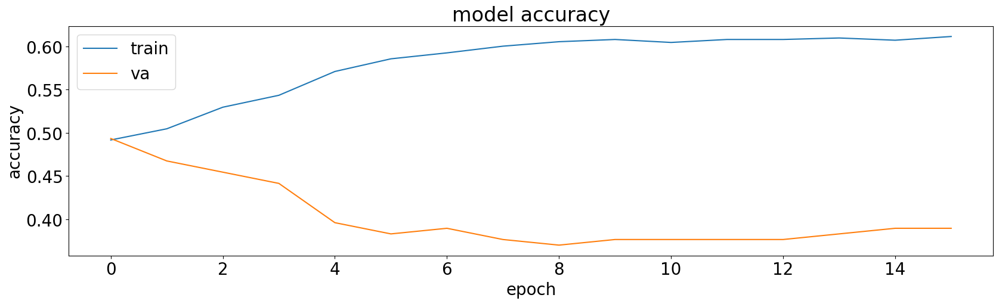

8/8 [==============================] - 1s 12ms/step


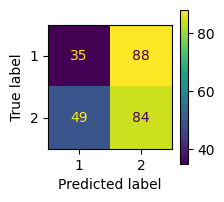

              precision    recall  f1-score   support

           1       0.42      0.28      0.34       123
           2       0.49      0.63      0.55       133

    accuracy                           0.46       256
   macro avg       0.45      0.46      0.44       256
weighted avg       0.45      0.46      0.45       256

5/5 [==============================] - 2s 339ms/step
| 186       | 0.4768    | 7.675     | 0.01892   | 1.237     | 3.467     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


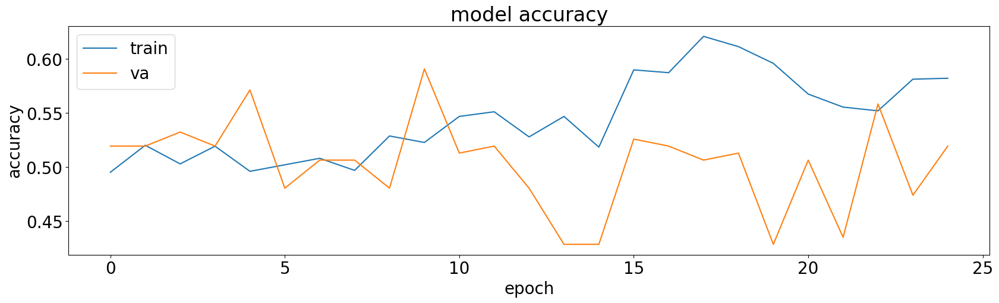

8/8 [==============================] - 3s 306ms/step


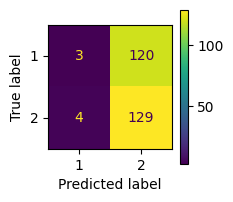

              precision    recall  f1-score   support

           1       0.43      0.02      0.05       123
           2       0.52      0.97      0.68       133

    accuracy                           0.52       256
   macro avg       0.47      0.50      0.36       256
weighted avg       0.48      0.52      0.37       256

5/5 [==============================] - 1s 12ms/step
| 187       | 0.5448    | 7.664     | 0.03389   | 1.603     | 3.543     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


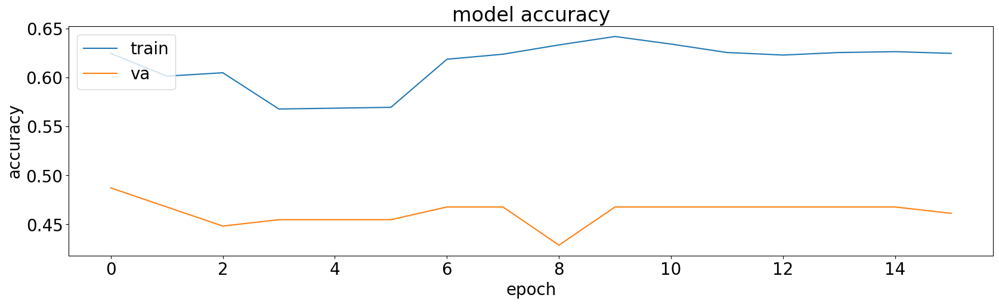

8/8 [==============================] - 3s 343ms/step


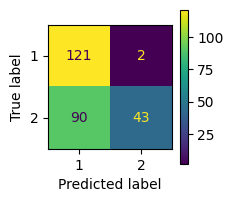

              precision    recall  f1-score   support

           1       0.57      0.98      0.72       123
           2       0.96      0.32      0.48       133

    accuracy                           0.64       256
   macro avg       0.76      0.65      0.60       256
weighted avg       0.77      0.64      0.60       256

5/5 [==============================] - 2s 304ms/step
| 188       | 0.4599    | 7.0       | 0.03803   | 0.6194    | 11.89     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


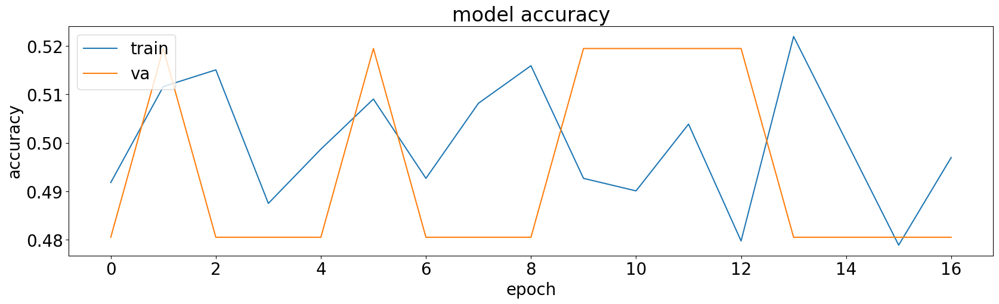

8/8 [==============================] - 4s 456ms/step


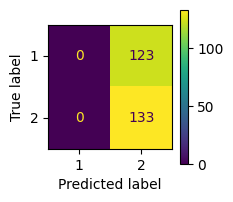

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 484ms/step
| 189       | 0.4214    | 6.011     | 0.08624   | 1.709     | 6.482     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


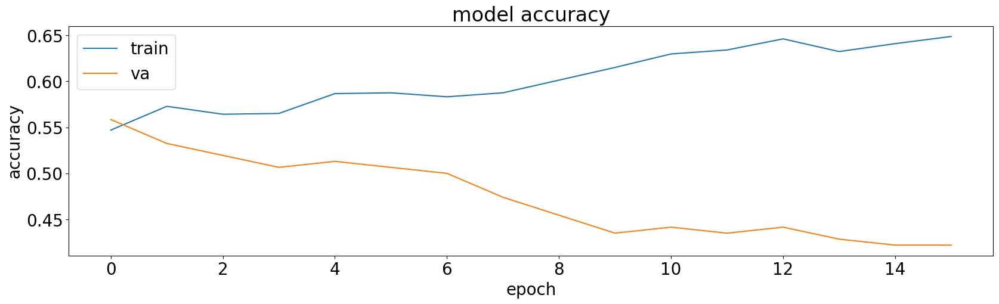

8/8 [==============================] - 1s 13ms/step


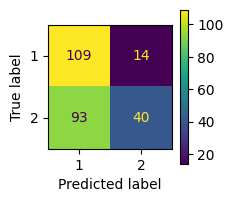

              precision    recall  f1-score   support

           1       0.54      0.89      0.67       123
           2       0.74      0.30      0.43       133

    accuracy                           0.58       256
   macro avg       0.64      0.59      0.55       256
weighted avg       0.64      0.58      0.54       256

5/5 [==============================] - 3s 507ms/step
| 190       | 0.547     | 8.661     | 0.008962  | 0.8259    | 7.571     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


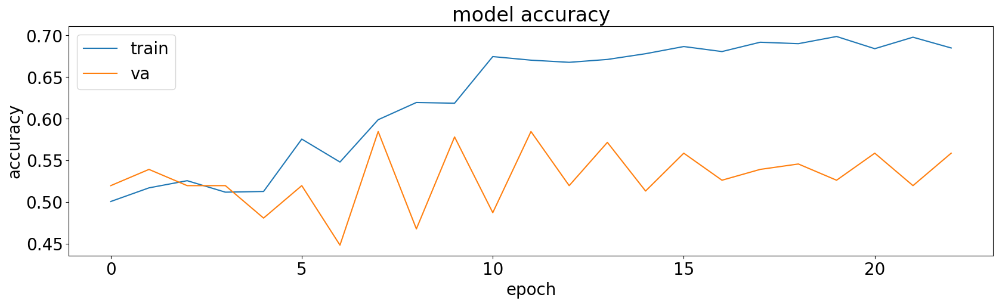

8/8 [==============================] - 2s 224ms/step


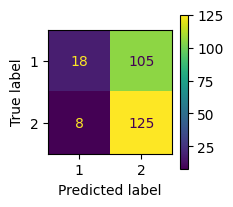

              precision    recall  f1-score   support

           1       0.69      0.15      0.24       123
           2       0.54      0.94      0.69       133

    accuracy                           0.56       256
   macro avg       0.62      0.54      0.47       256
weighted avg       0.61      0.56      0.47       256

5/5 [==============================] - 3s 614ms/step
| 191       | 0.5427    | 8.923     | 0.04399   | 1.621     | 2.786     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


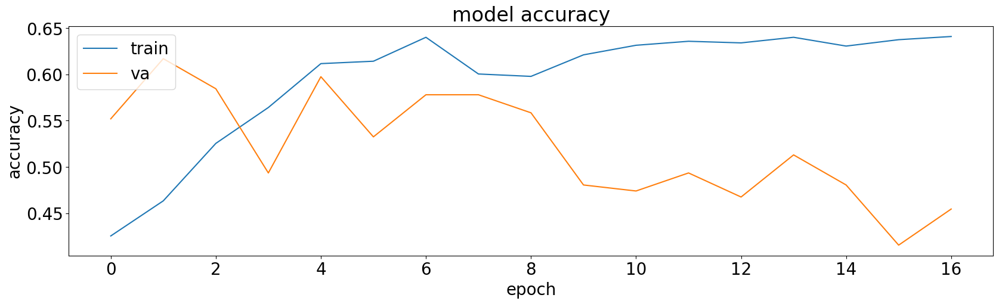

8/8 [==============================] - 2s 262ms/step


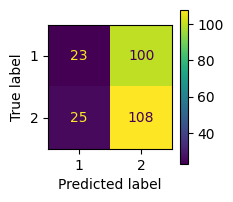

              precision    recall  f1-score   support

           1       0.48      0.19      0.27       123
           2       0.52      0.81      0.63       133

    accuracy                           0.51       256
   macro avg       0.50      0.50      0.45       256
weighted avg       0.50      0.51      0.46       256

5/5 [==============================] - 1s 13ms/step
| 192       | 0.6076    | 8.758     | 0.04517   | 0.8028    | 7.548     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


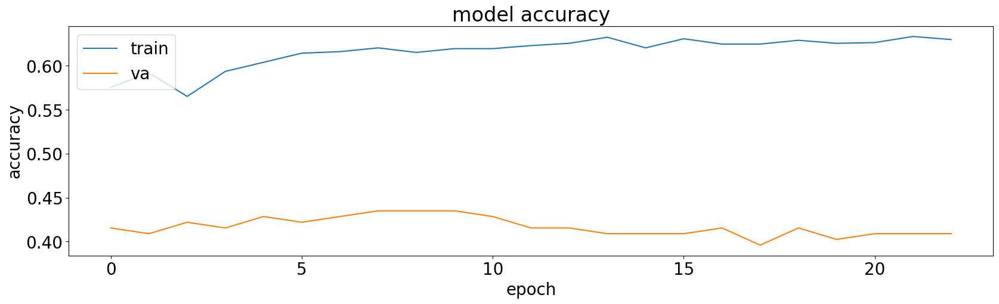

8/8 [==============================] - 2s 212ms/step


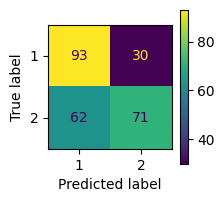

              precision    recall  f1-score   support

           1       0.60      0.76      0.67       123
           2       0.70      0.53      0.61       133

    accuracy                           0.64       256
   macro avg       0.65      0.64      0.64       256
weighted avg       0.65      0.64      0.64       256

5/5 [==============================] - 3s 497ms/step
| 193       | 0.4341    | 6.629     | 0.01616   | 1.302     | 8.538     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


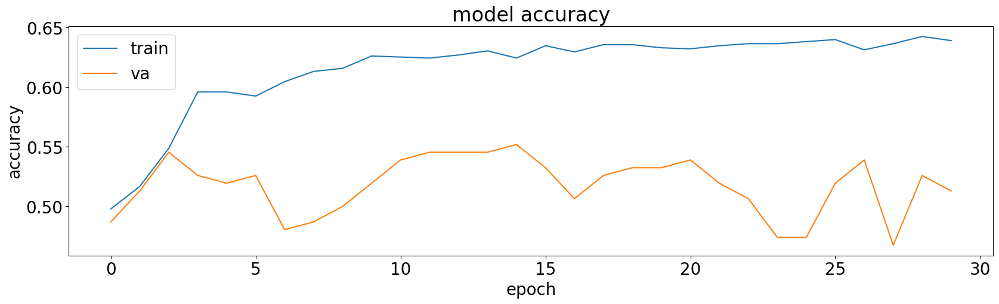

8/8 [==============================] - 3s 348ms/step


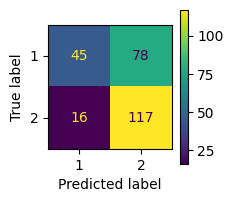

              precision    recall  f1-score   support

           1       0.74      0.37      0.49       123
           2       0.60      0.88      0.71       133

    accuracy                           0.63       256
   macro avg       0.67      0.62      0.60       256
weighted avg       0.67      0.63      0.61       256

5/5 [==============================] - 3s 461ms/step
| 194       | 0.5436    | 8.73      | 0.03259   | 0.7944    | 7.594     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


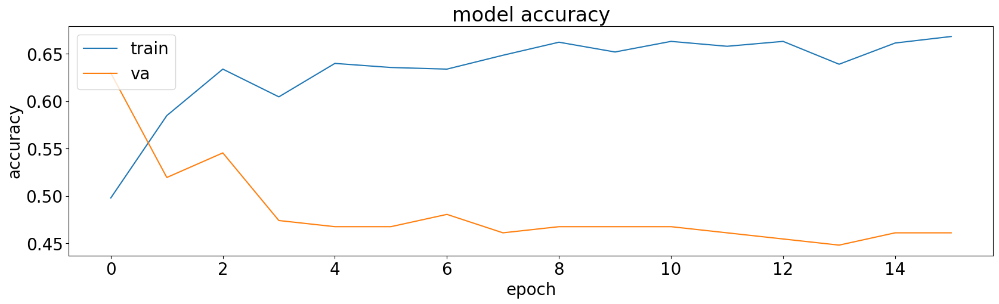

8/8 [==============================] - 3s 355ms/step


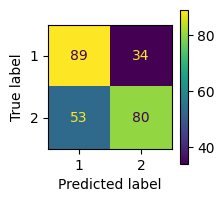

              precision    recall  f1-score   support

           1       0.63      0.72      0.67       123
           2       0.70      0.60      0.65       133

    accuracy                           0.66       256
   macro avg       0.66      0.66      0.66       256
weighted avg       0.67      0.66      0.66       256

5/5 [==============================] - 2s 422ms/step
| 195       | 0.6285    | 7.823     | 0.06903   | 1.023     | 10.23     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


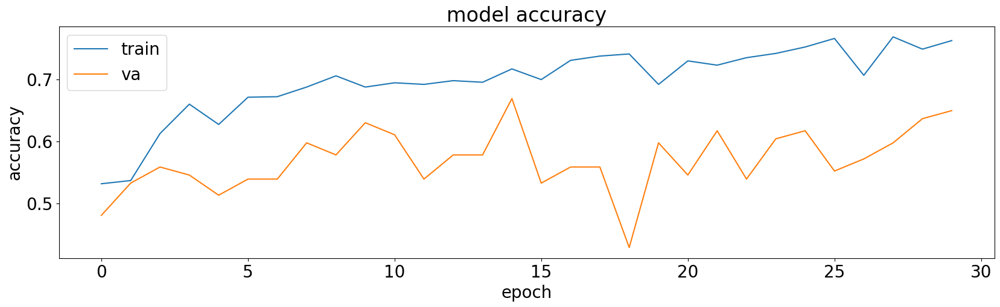

8/8 [==============================] - 1s 12ms/step


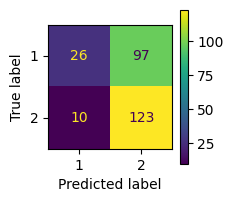

              precision    recall  f1-score   support

           1       0.72      0.21      0.33       123
           2       0.56      0.92      0.70       133

    accuracy                           0.58       256
   macro avg       0.64      0.57      0.51       256
weighted avg       0.64      0.58      0.52       256

5/5 [==============================] - 2s 278ms/step
| 196       | 0.6481    | 8.439     | 0.005095  | 0.07237   | 4.851     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


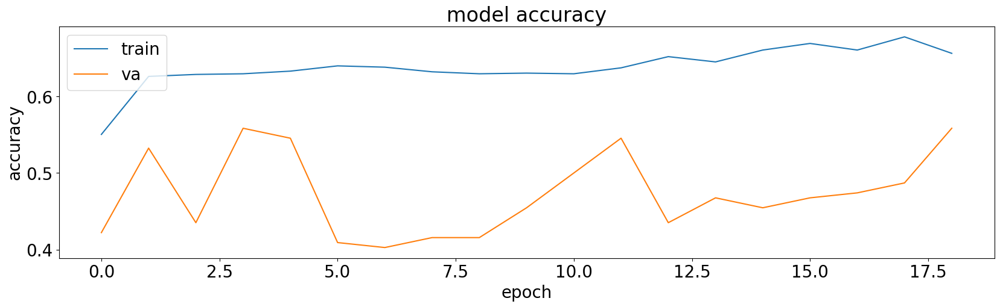

8/8 [==============================] - 3s 268ms/step


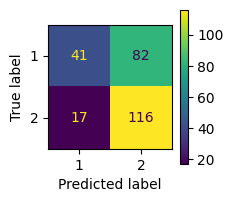

              precision    recall  f1-score   support

           1       0.71      0.33      0.45       123
           2       0.59      0.87      0.70       133

    accuracy                           0.61       256
   macro avg       0.65      0.60      0.58       256
weighted avg       0.64      0.61      0.58       256

5/5 [==============================] - 3s 329ms/step
| 197       | 0.5484    | 7.293     | 0.06259   | 0.8111    | 6.271     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


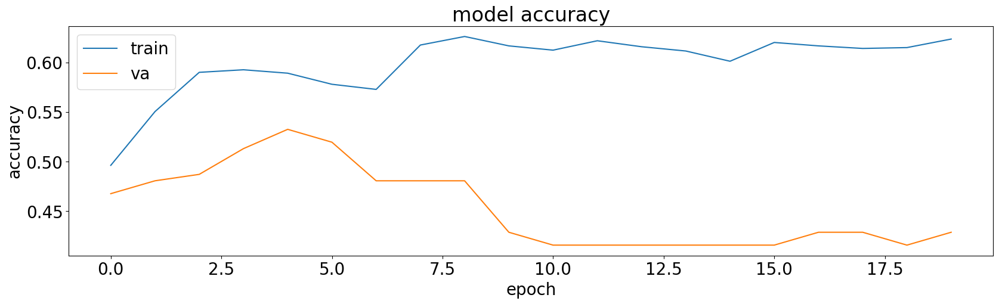

8/8 [==============================] - 3s 307ms/step


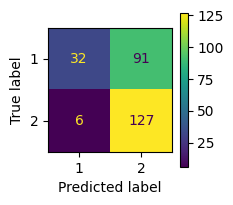

              precision    recall  f1-score   support

           1       0.84      0.26      0.40       123
           2       0.58      0.95      0.72       133

    accuracy                           0.62       256
   macro avg       0.71      0.61      0.56       256
weighted avg       0.71      0.62      0.57       256

5/5 [==============================] - 2s 283ms/step
| 198       | 0.5067    | 8.678     | 0.07218   | 0.805     | 7.601     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


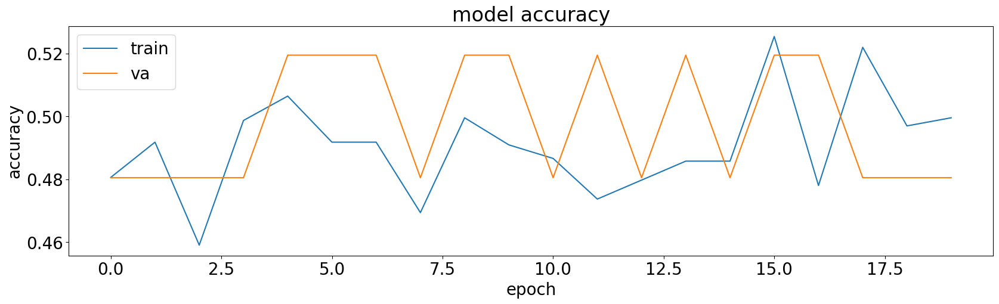

8/8 [==============================] - 3s 283ms/step


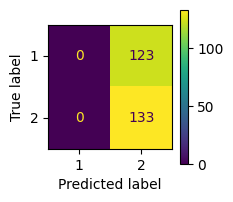

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 438ms/step
| 199       | 0.4214    | 7.11      | 0.0612    | 0.09771   | 5.909     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


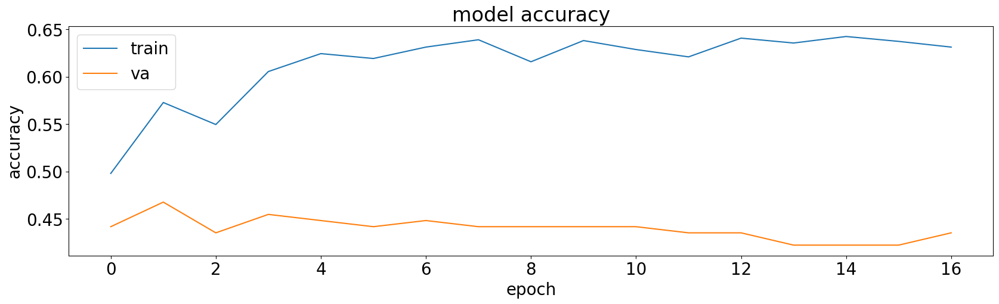

8/8 [==============================] - 2s 206ms/step


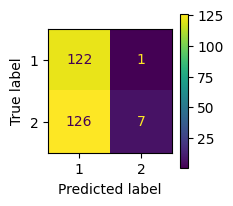

              precision    recall  f1-score   support

           1       0.49      0.99      0.66       123
           2       0.88      0.05      0.10       133

    accuracy                           0.50       256
   macro avg       0.68      0.52      0.38       256
weighted avg       0.69      0.50      0.37       256

5/5 [==============================] - 2s 437ms/step
| 200       | 0.425     | 8.252     | 0.04194   | 1.057     | 15.14     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


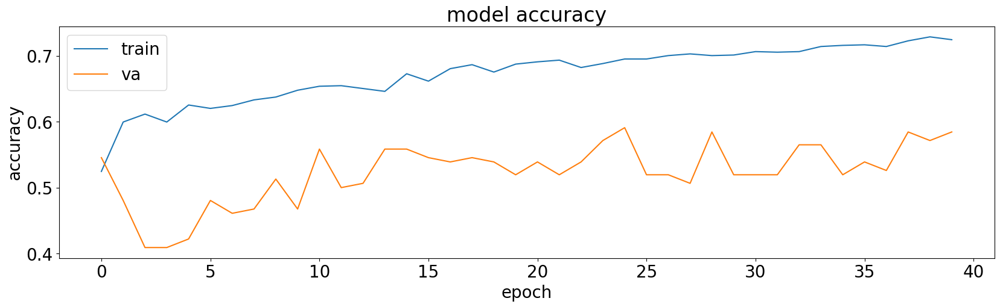

8/8 [==============================] - 1s 12ms/step


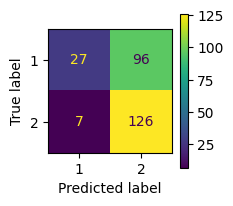

              precision    recall  f1-score   support

           1       0.79      0.22      0.34       123
           2       0.57      0.95      0.71       133

    accuracy                           0.60       256
   macro avg       0.68      0.58      0.53       256
weighted avg       0.68      0.60      0.53       256

5/5 [==============================] - 1s 12ms/step
| 201       | 0.5483    | 6.495     | 0.0583    | 1.046     | 4.16      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


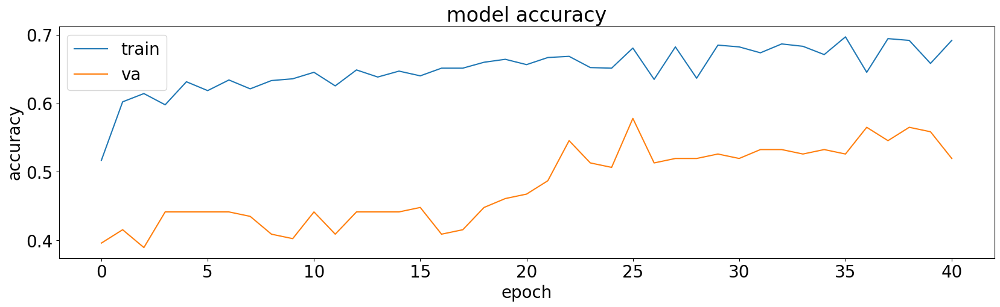

8/8 [==============================] - 3s 310ms/step


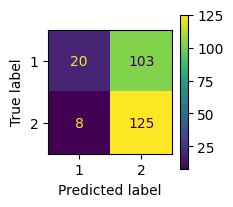

              precision    recall  f1-score   support

           1       0.71      0.16      0.26       123
           2       0.55      0.94      0.69       133

    accuracy                           0.57       256
   macro avg       0.63      0.55      0.48       256
weighted avg       0.63      0.57      0.49       256

5/5 [==============================] - 3s 529ms/step
| 202       | 0.5263    | 7.804     | 0.0819    | 1.009     | 10.19     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


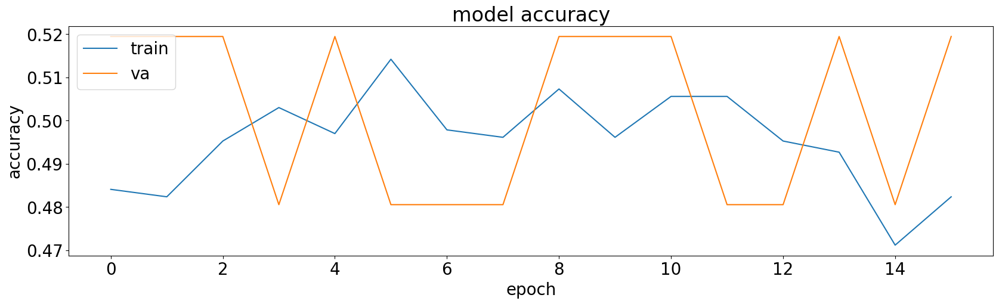

8/8 [==============================] - 3s 271ms/step


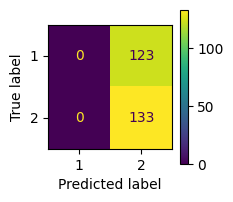

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 510ms/step
| 203       | 0.4214    | 8.299     | 0.05223   | 0.1304    | 19.34     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


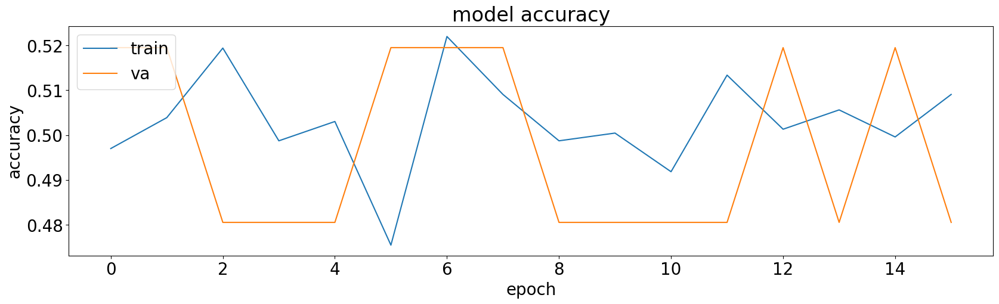

8/8 [==============================] - 2s 139ms/step


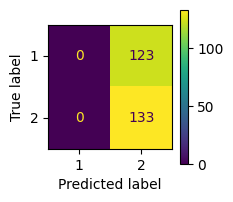

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 2s 419ms/step
| 204       | 0.4214    | 7.579     | 0.07048   | 1.523     | 16.41     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


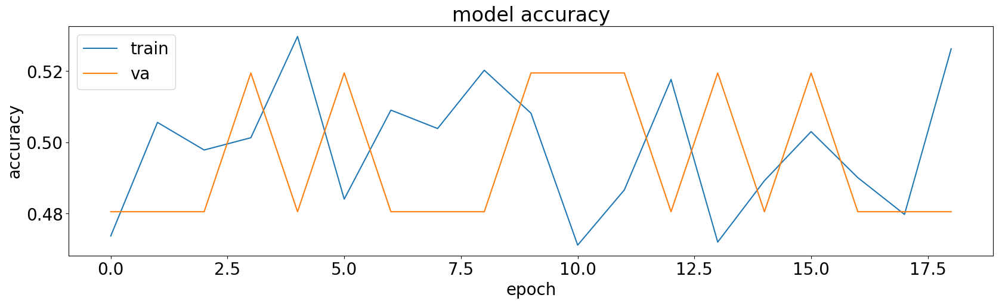

8/8 [==============================] - 3s 305ms/step


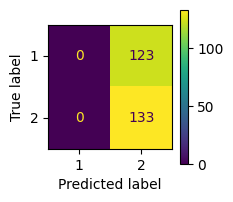

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 526ms/step
| 205       | 0.4214    | 8.208     | 0.04036   | 1.789     | 15.38     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


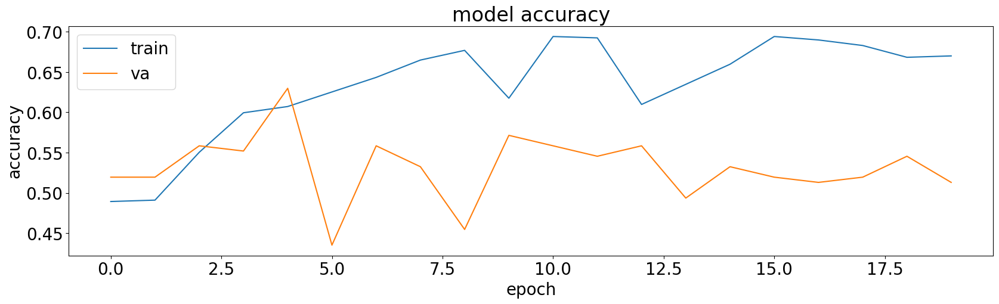

8/8 [==============================] - 3s 293ms/step


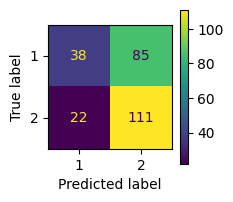

              precision    recall  f1-score   support

           1       0.63      0.31      0.42       123
           2       0.57      0.83      0.67       133

    accuracy                           0.58       256
   macro avg       0.60      0.57      0.55       256
weighted avg       0.60      0.58      0.55       256

5/5 [==============================] - 3s 499ms/step
| 206       | 0.6248    | 6.474     | 0.01918   | 1.836     | 8.476     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


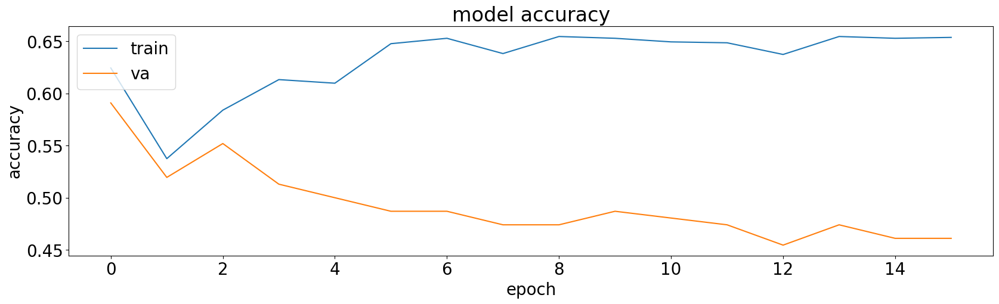

8/8 [==============================] - 3s 301ms/step


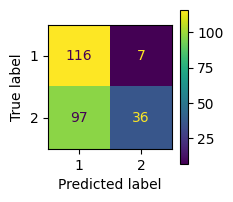

              precision    recall  f1-score   support

           1       0.54      0.94      0.69       123
           2       0.84      0.27      0.41       133

    accuracy                           0.59       256
   macro avg       0.69      0.61      0.55       256
weighted avg       0.70      0.59      0.54       256

5/5 [==============================] - 2s 428ms/step
| 207       | 0.5751    | 8.515     | 0.0752    | 0.5336    | 19.55     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

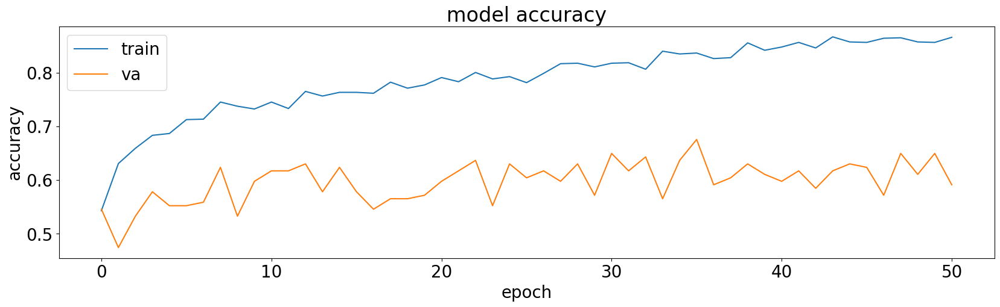

8/8 [==============================] - 1s 17ms/step


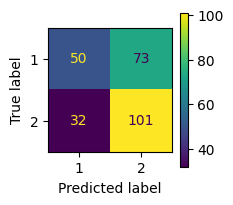

              precision    recall  f1-score   support

           1       0.61      0.41      0.49       123
           2       0.58      0.76      0.66       133

    accuracy                           0.59       256
   macro avg       0.60      0.58      0.57       256
weighted avg       0.59      0.59      0.58       256

5/5 [==============================] - 1s 17ms/step
| 208       | 0.6713    | 7.701     | 0.001002  | 1.673     | 11.7      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


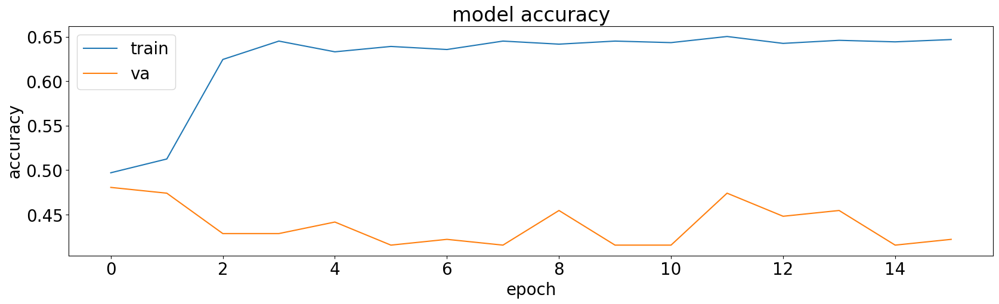

8/8 [==============================] - 3s 395ms/step


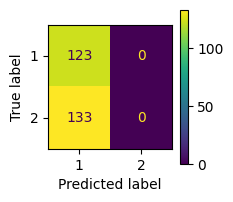

              precision    recall  f1-score   support

           1       0.48      1.00      0.65       123
           2       0.00      0.00      0.00       133

    accuracy                           0.48       256
   macro avg       0.24      0.50      0.32       256
weighted avg       0.23      0.48      0.31       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 501ms/step
| 209       | 0.3949    | 7.904     | 0.09051   | 0.5772    | 9.865     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


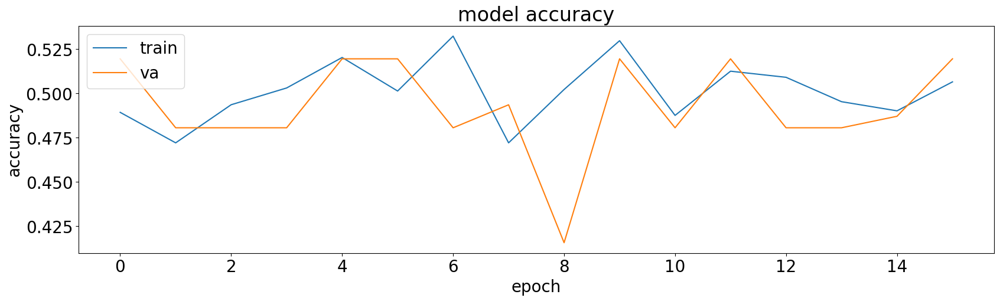

8/8 [==============================] - 3s 300ms/step


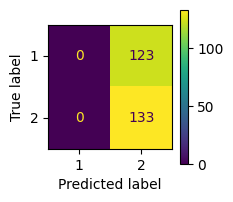

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 3s 485ms/step
| 210       | 0.4214    | 6.516     | 0.006964  | 0.1116    | 10.76     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


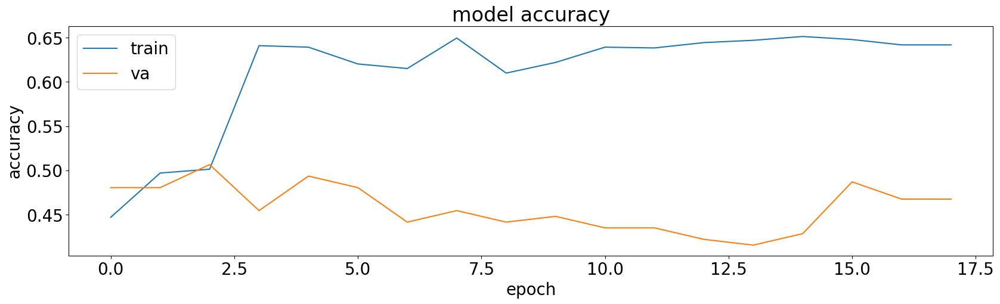

8/8 [==============================] - 3s 315ms/step


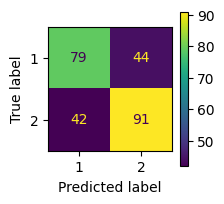

              precision    recall  f1-score   support

           1       0.65      0.64      0.65       123
           2       0.67      0.68      0.68       133

    accuracy                           0.66       256
   macro avg       0.66      0.66      0.66       256
weighted avg       0.66      0.66      0.66       256

5/5 [==============================] - 3s 438ms/step
| 211       | 0.5044    | 8.883     | 0.07889   | 0.9973    | 19.98     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You

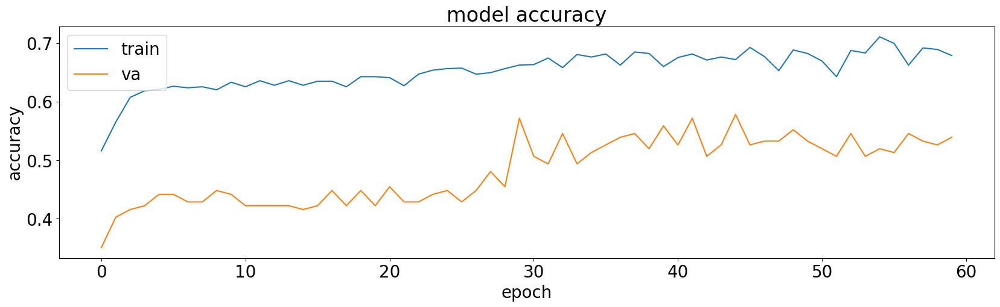

8/8 [==============================] - 3s 295ms/step


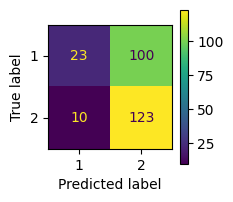

              precision    recall  f1-score   support

           1       0.70      0.19      0.29       123
           2       0.55      0.92      0.69       133

    accuracy                           0.57       256
   macro avg       0.62      0.56      0.49       256
weighted avg       0.62      0.57      0.50       256

5/5 [==============================] - 2s 432ms/step
| 212       | 0.5372    | 7.944     | 0.06888   | 0.6912    | 17.51     |


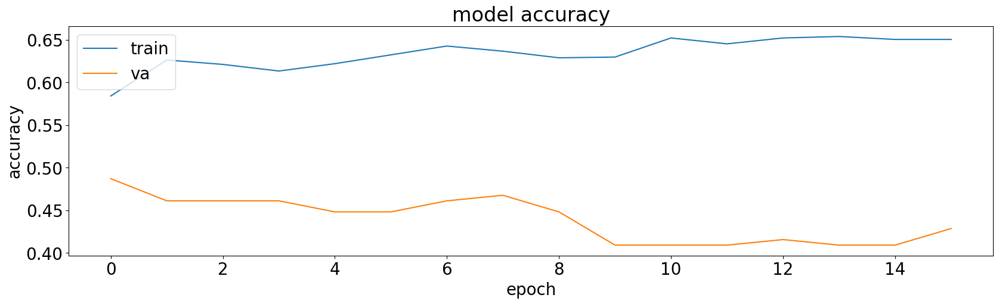

8/8 [==============================] - 3s 295ms/step


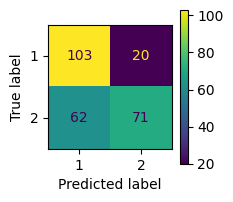

              precision    recall  f1-score   support

           1       0.62      0.84      0.72       123
           2       0.78      0.53      0.63       133

    accuracy                           0.68       256
   macro avg       0.70      0.69      0.67       256
weighted avg       0.71      0.68      0.67       256

5/5 [==============================] - 3s 496ms/step
| 213       | 0.4857    | 7.907     | 0.05842   | 0.5861    | 9.78      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


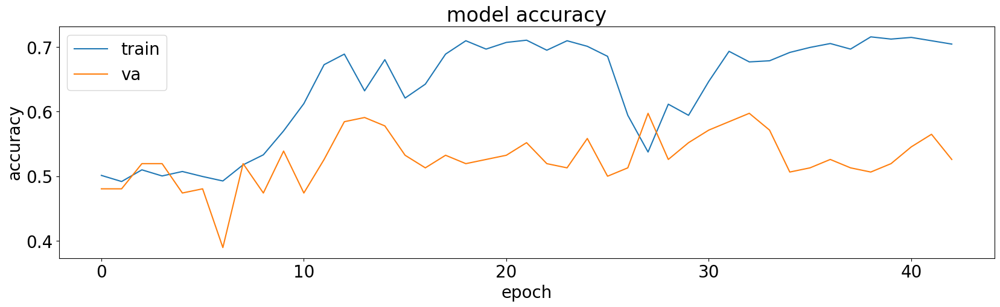

8/8 [==============================] - 3s 261ms/step


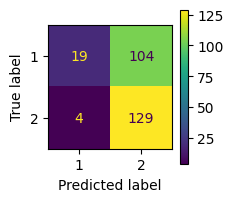

              precision    recall  f1-score   support

           1       0.83      0.15      0.26       123
           2       0.55      0.97      0.70       133

    accuracy                           0.58       256
   macro avg       0.69      0.56      0.48       256
weighted avg       0.68      0.58      0.49       256

5/5 [==============================] - 2s 286ms/step
| 214       | 0.5571    | 7.682     | 0.06507   | 1.649     | 3.436     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


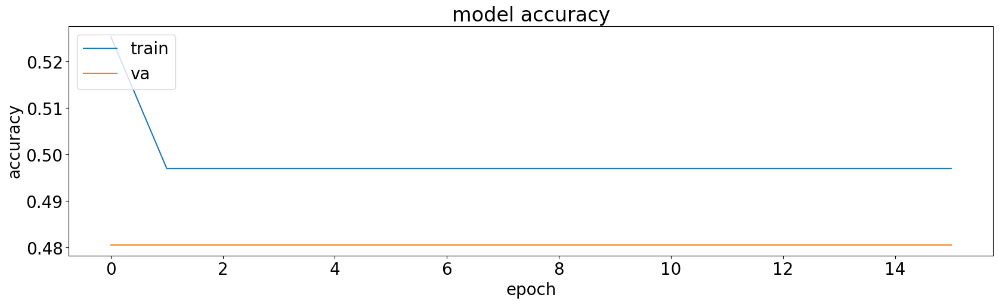

8/8 [==============================] - 1s 12ms/step
| 215       | 0.0       | 7.055     | 0.04177   | 0.08163   | 5.996     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


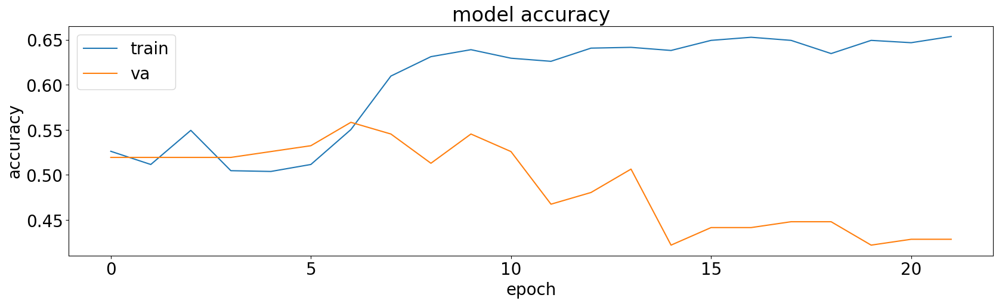

8/8 [==============================] - 2s 226ms/step


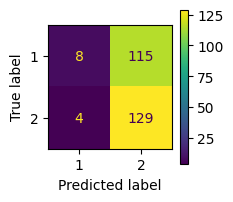

              precision    recall  f1-score   support

           1       0.67      0.07      0.12       123
           2       0.53      0.97      0.68       133

    accuracy                           0.54       256
   macro avg       0.60      0.52      0.40       256
weighted avg       0.59      0.54      0.41       256

5/5 [==============================] - 2s 439ms/step
| 216       | 0.4877    | 8.533     | 0.06493   | 1.373     | 13.46     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


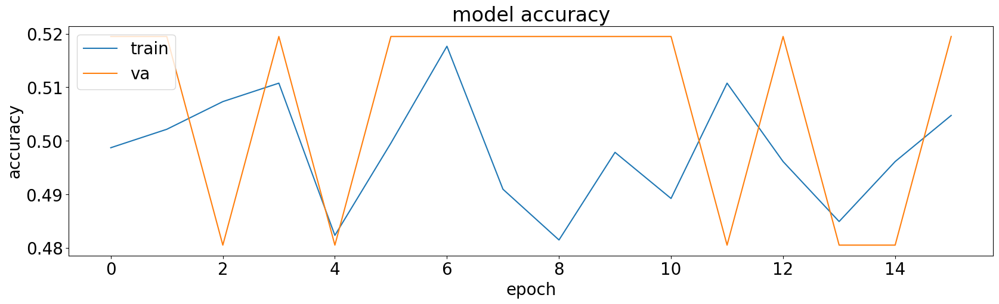

8/8 [==============================] - 1s 9ms/step


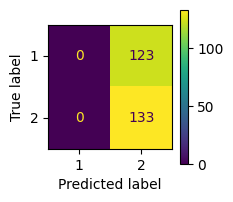

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 14ms/step
| 217       | 0.4214    | 7.589     | 0.03111   | 0.1499    | 11.62     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


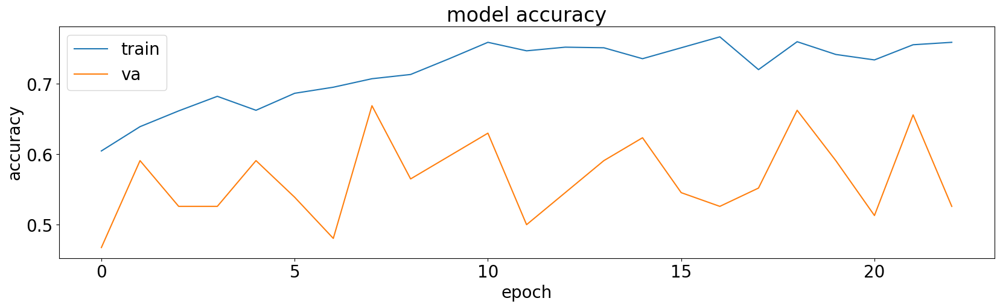

8/8 [==============================] - 1s 10ms/step


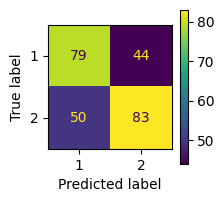

              precision    recall  f1-score   support

           1       0.61      0.64      0.63       123
           2       0.65      0.62      0.64       133

    accuracy                           0.63       256
   macro avg       0.63      0.63      0.63       256
weighted avg       0.63      0.63      0.63       256

5/5 [==============================] - 1s 15ms/step
| 218       | 0.6683    | 6.609     | 0.001033  | 0.1305    | 14.32     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


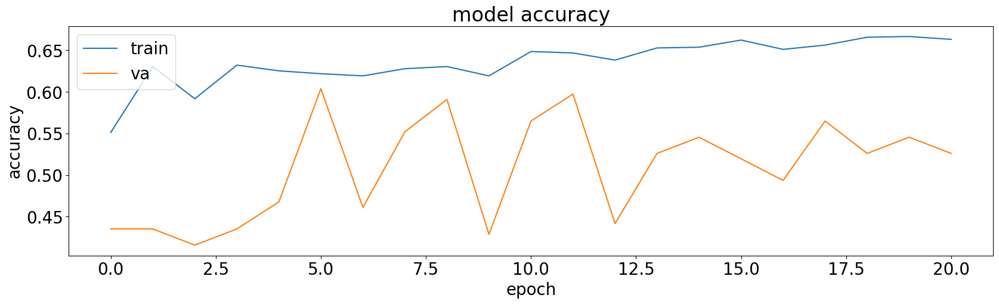

8/8 [==============================] - 1s 10ms/step


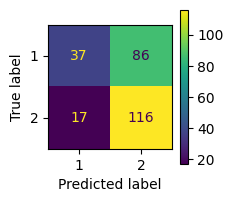

              precision    recall  f1-score   support

           1       0.69      0.30      0.42       123
           2       0.57      0.87      0.69       133

    accuracy                           0.60       256
   macro avg       0.63      0.59      0.56       256
weighted avg       0.63      0.60      0.56       256

5/5 [==============================] - 1s 15ms/step
| 219       | 0.5886    | 7.221     | 0.07754   | 0.8721    | 14.34     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


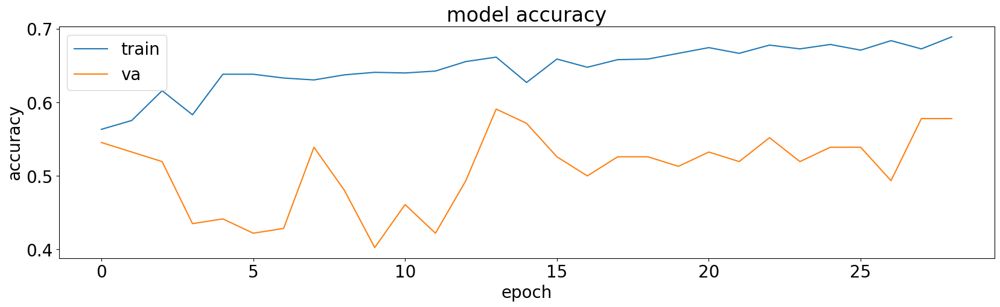

8/8 [==============================] - 1s 10ms/step


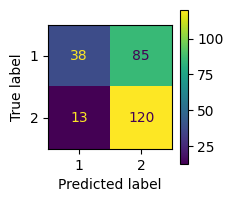

              precision    recall  f1-score   support

           1       0.75      0.31      0.44       123
           2       0.59      0.90      0.71       133

    accuracy                           0.62       256
   macro avg       0.67      0.61      0.57       256
weighted avg       0.66      0.62      0.58       256

5/5 [==============================] - 1s 14ms/step
| 220       | 0.5782    | 6.797     | 0.07272   | 1.261     | 14.39     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


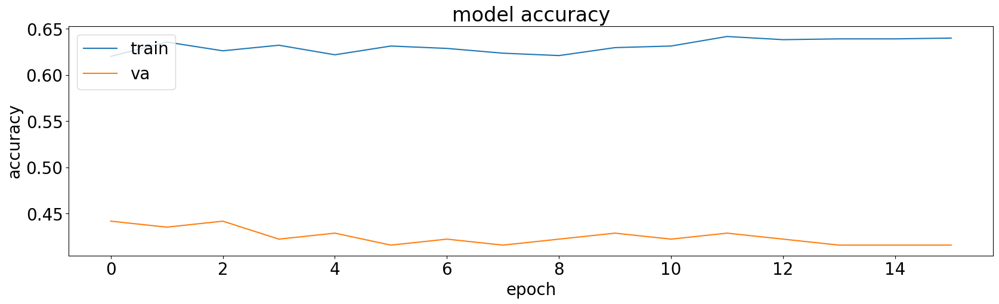

8/8 [==============================] - 1s 8ms/step


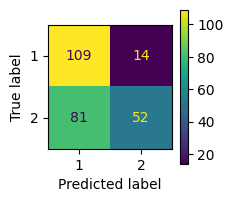

              precision    recall  f1-score   support

           1       0.57      0.89      0.70       123
           2       0.79      0.39      0.52       133

    accuracy                           0.63       256
   macro avg       0.68      0.64      0.61       256
weighted avg       0.68      0.63      0.61       256

5/5 [==============================] - 1s 14ms/step
| 221       | 0.4346    | 7.842     | 0.07256   | 0.9514    | 10.24     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


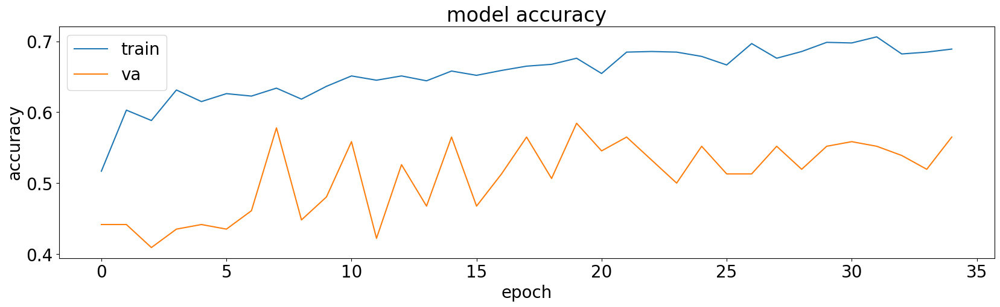

8/8 [==============================] - 1s 13ms/step


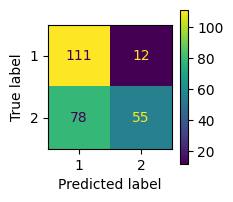

              precision    recall  f1-score   support

           1       0.59      0.90      0.71       123
           2       0.82      0.41      0.55       133

    accuracy                           0.65       256
   macro avg       0.70      0.66      0.63       256
weighted avg       0.71      0.65      0.63       256

5/5 [==============================] - 1s 17ms/step
| 222       | 0.5783    | 6.686     | 0.07853   | 1.279     | 16.92     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


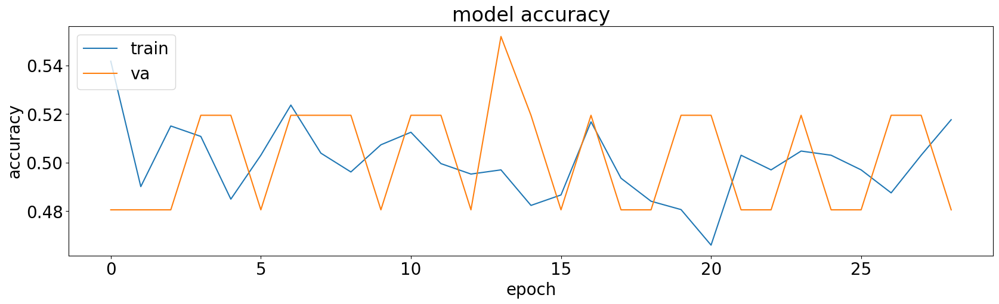

8/8 [==============================] - 1s 11ms/step


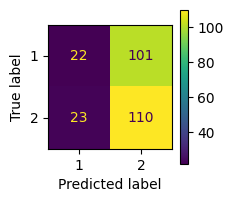

              precision    recall  f1-score   support

           1       0.49      0.18      0.26       123
           2       0.52      0.83      0.64       133

    accuracy                           0.52       256
   macro avg       0.51      0.50      0.45       256
weighted avg       0.51      0.52      0.46       256

5/5 [==============================] - 1s 18ms/step
| 223       | 0.5049    | 8.619     | 0.01      | 0.2471    | 14.61     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


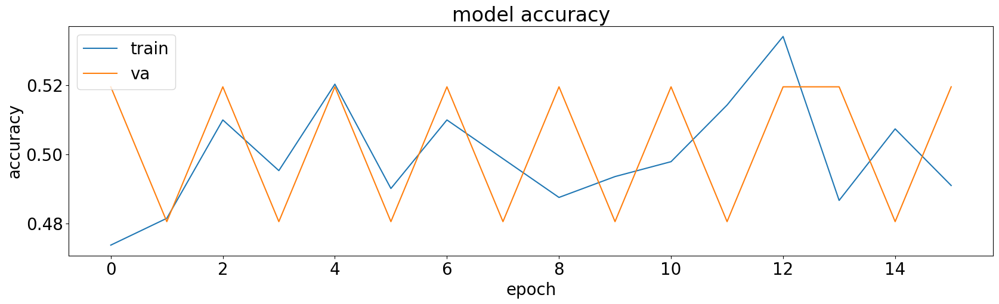

8/8 [==============================] - 1s 13ms/step


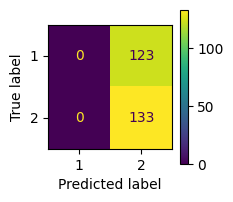

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 13ms/step
| 224       | 0.4214    | 7.759     | 0.04718   | 0.2659    | 18.25     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


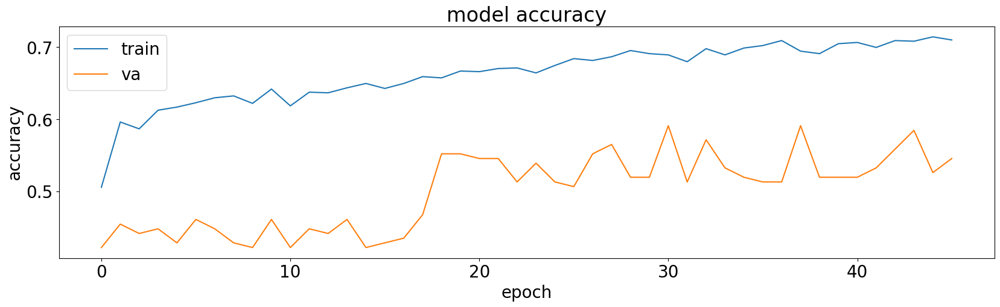

8/8 [==============================] - 1s 8ms/step


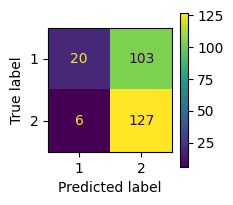

              precision    recall  f1-score   support

           1       0.77      0.16      0.27       123
           2       0.55      0.95      0.70       133

    accuracy                           0.57       256
   macro avg       0.66      0.56      0.48       256
weighted avg       0.66      0.57      0.49       256

5/5 [==============================] - 1s 12ms/step
| 225       | 0.5448    | 7.374     | 0.06135   | 0.5837    | 8.57      |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


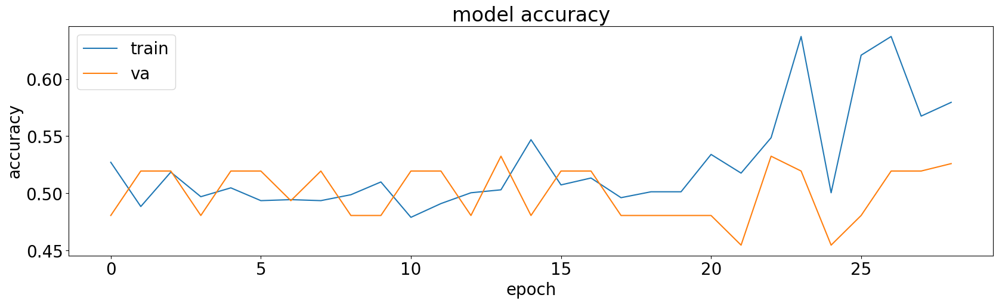

8/8 [==============================] - 1s 10ms/step


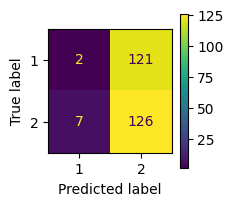

              precision    recall  f1-score   support

           1       0.22      0.02      0.03       123
           2       0.51      0.95      0.66       133

    accuracy                           0.50       256
   macro avg       0.37      0.48      0.35       256
weighted avg       0.37      0.50      0.36       256

5/5 [==============================] - 1s 18ms/step
| 226       | 0.4625    | 6.796     | 0.01533   | 0.2884    | 13.52     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


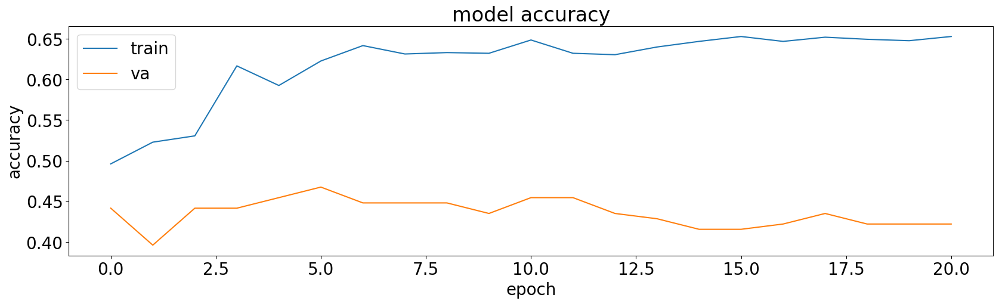

8/8 [==============================] - 1s 13ms/step


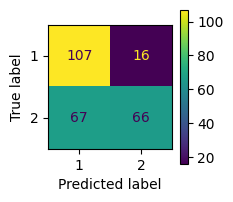

              precision    recall  f1-score   support

           1       0.61      0.87      0.72       123
           2       0.80      0.50      0.61       133

    accuracy                           0.68       256
   macro avg       0.71      0.68      0.67       256
weighted avg       0.71      0.68      0.67       256

5/5 [==============================] - 1s 16ms/step
| 227       | 0.4659    | 7.533     | 0.06896   | 1.316     | 17.29     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


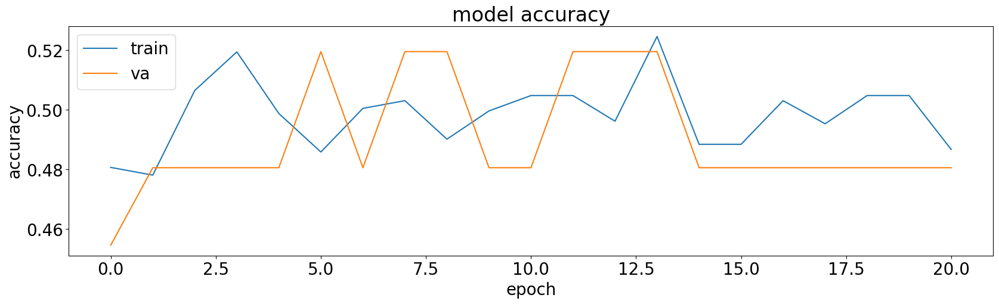

8/8 [==============================] - 1s 12ms/step


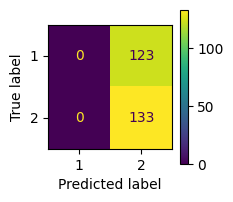

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 16ms/step
| 228       | 0.4214    | 7.94      | 0.006473  | 0.2437    | 17.72     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


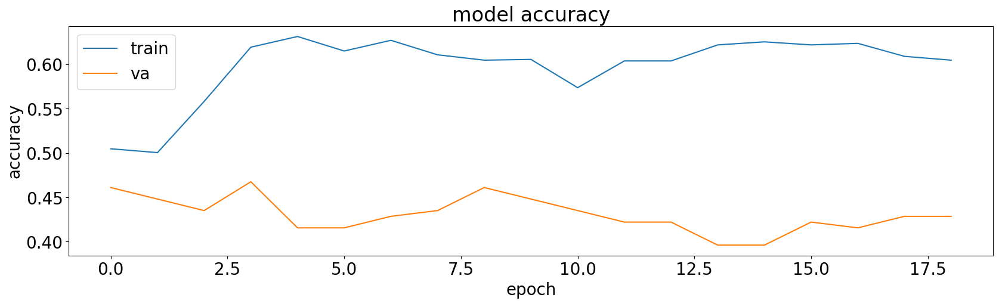

8/8 [==============================] - 1s 13ms/step


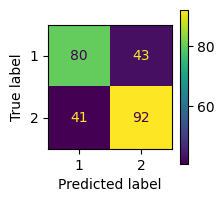

              precision    recall  f1-score   support

           1       0.66      0.65      0.66       123
           2       0.68      0.69      0.69       133

    accuracy                           0.67       256
   macro avg       0.67      0.67      0.67       256
weighted avg       0.67      0.67      0.67       256

5/5 [==============================] - 1s 13ms/step
| 229       | 0.4675    | 6.72      | 0.01987   | 1.229     | 16.96     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


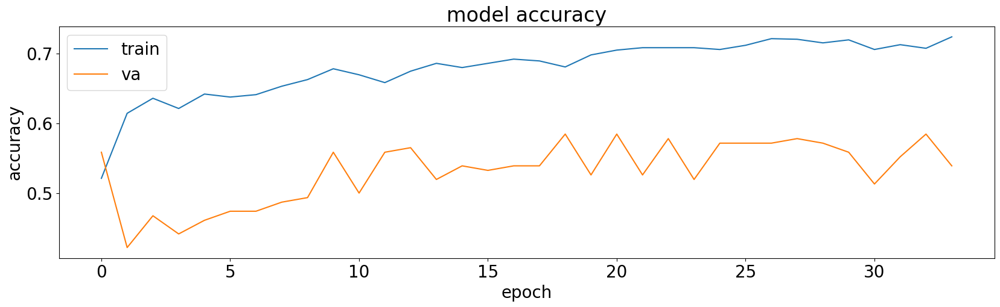

8/8 [==============================] - 1s 8ms/step


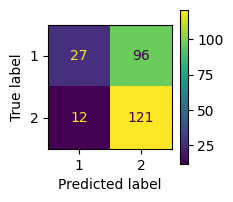

              precision    recall  f1-score   support

           1       0.69      0.22      0.33       123
           2       0.56      0.91      0.69       133

    accuracy                           0.58       256
   macro avg       0.62      0.56      0.51       256
weighted avg       0.62      0.58      0.52       256

5/5 [==============================] - 1s 11ms/step
| 230       | 0.5518    | 6.393     | 0.05588   | 1.262     | 5.415     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


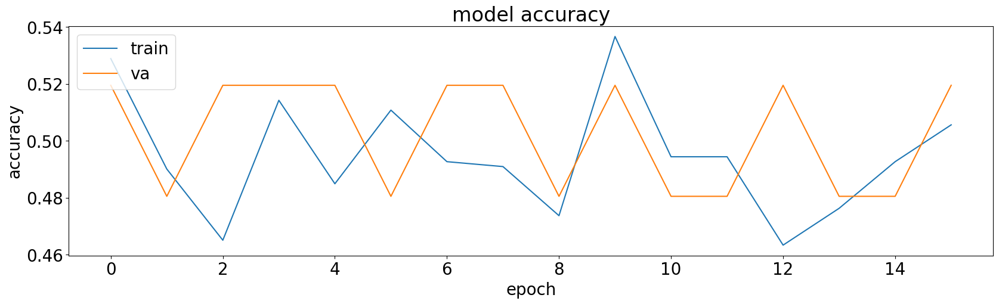

8/8 [==============================] - 1s 7ms/step


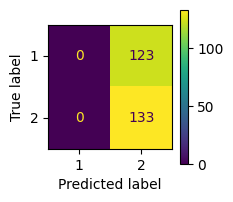

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 12ms/step
| 231       | 0.4214    | 6.661     | 0.0576    | 1.696     | 6.731     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


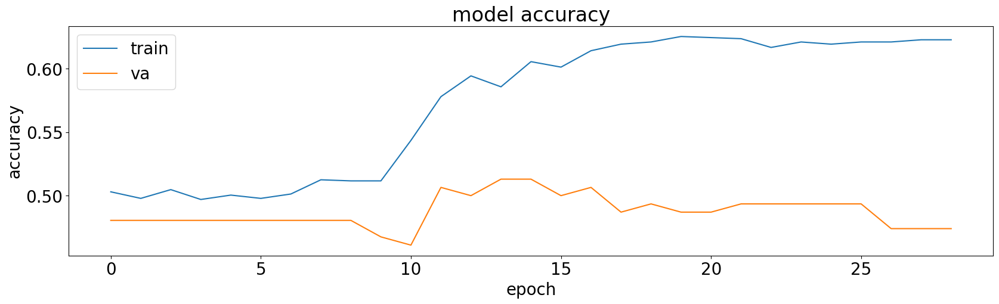

8/8 [==============================] - 1s 8ms/step


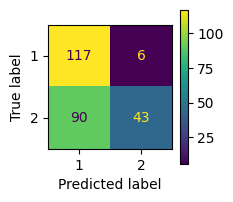

              precision    recall  f1-score   support

           1       0.57      0.95      0.71       123
           2       0.88      0.32      0.47       133

    accuracy                           0.62       256
   macro avg       0.72      0.64      0.59       256
weighted avg       0.73      0.62      0.59       256

5/5 [==============================] - 1s 12ms/step
| 232       | 0.4873    | 6.845     | 0.01042   | 1.246     | 3.088     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


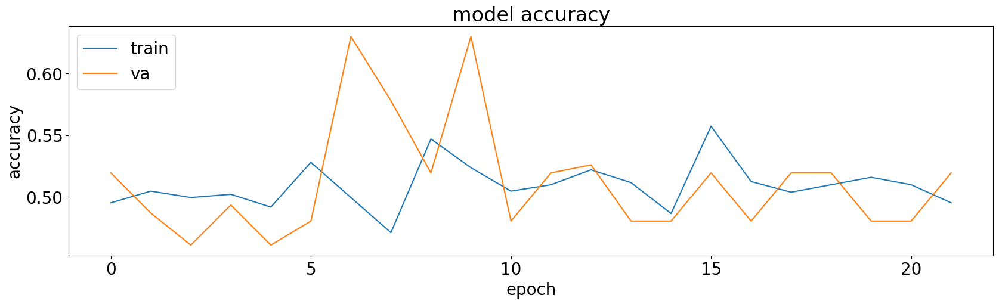

8/8 [==============================] - 1s 7ms/step


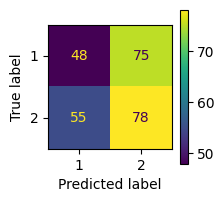

              precision    recall  f1-score   support

           1       0.47      0.39      0.42       123
           2       0.51      0.59      0.55       133

    accuracy                           0.49       256
   macro avg       0.49      0.49      0.49       256
weighted avg       0.49      0.49      0.49       256

5/5 [==============================] - 1s 11ms/step
| 233       | 0.6256    | 7.645     | 0.07017   | 1.588     | 3.475     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


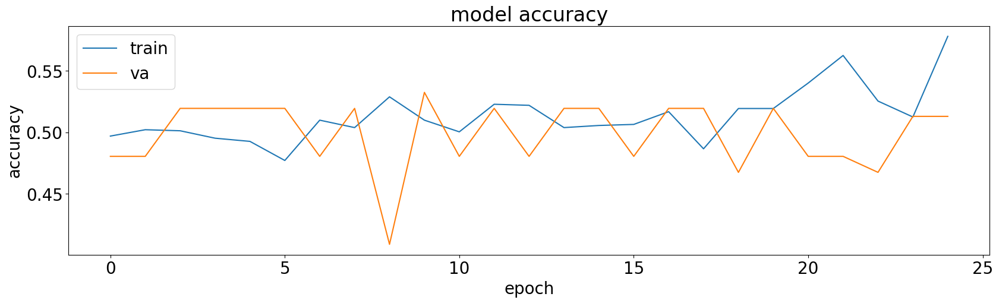

8/8 [==============================] - 1s 7ms/step


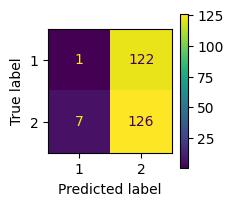

              precision    recall  f1-score   support

           1       0.12      0.01      0.02       123
           2       0.51      0.95      0.66       133

    accuracy                           0.50       256
   macro avg       0.32      0.48      0.34       256
weighted avg       0.32      0.50      0.35       256

5/5 [==============================] - 1s 12ms/step
| 234       | 0.4445    | 6.054     | 0.01473   | 0.06865   | 6.401     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


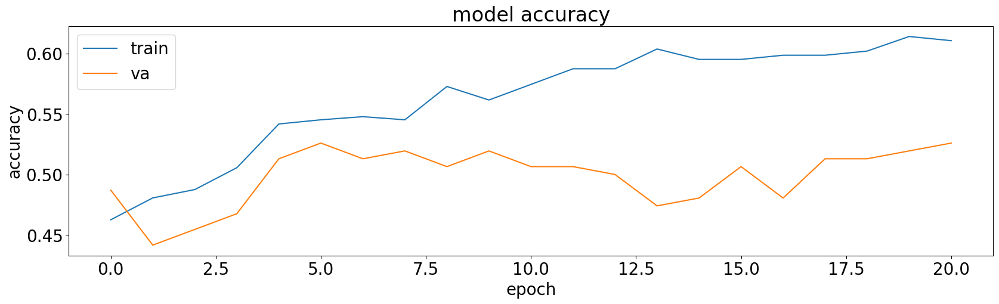

8/8 [==============================] - 1s 7ms/step


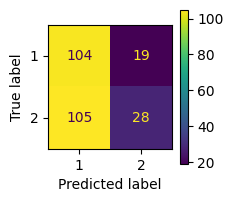

              precision    recall  f1-score   support

           1       0.50      0.85      0.63       123
           2       0.60      0.21      0.31       133

    accuracy                           0.52       256
   macro avg       0.55      0.53      0.47       256
weighted avg       0.55      0.52      0.46       256

5/5 [==============================] - 1s 12ms/step
| 235       | 0.5034    | 8.322     | 0.01066   | 1.163     | 4.755     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


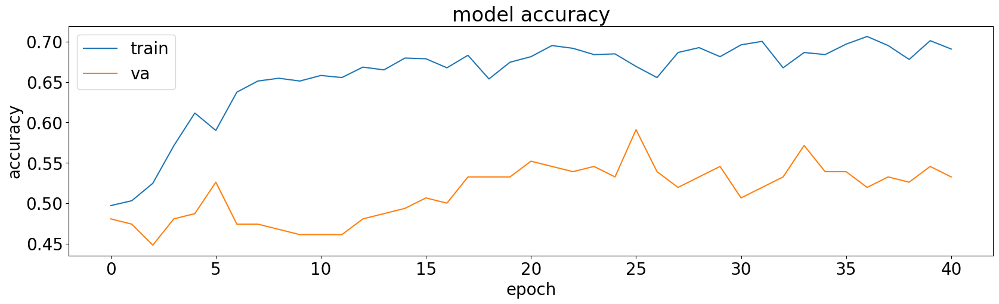

8/8 [==============================] - 1s 7ms/step


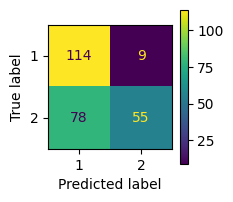

              precision    recall  f1-score   support

           1       0.59      0.93      0.72       123
           2       0.86      0.41      0.56       133

    accuracy                           0.66       256
   macro avg       0.73      0.67      0.64       256
weighted avg       0.73      0.66      0.64       256

5/5 [==============================] - 1s 12ms/step
| 236       | 0.5833    | 8.267     | 0.07244   | 1.447     | 4.216     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


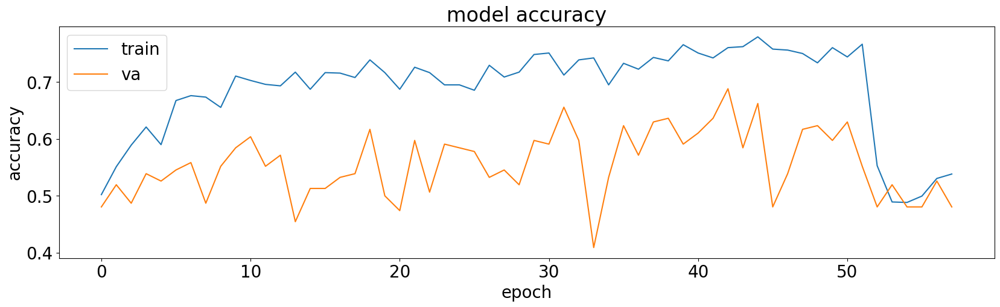

8/8 [==============================] - 1s 10ms/step


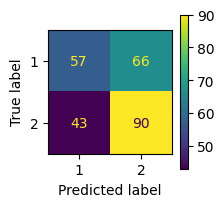

              precision    recall  f1-score   support

           1       0.57      0.46      0.51       123
           2       0.58      0.68      0.62       133

    accuracy                           0.57       256
   macro avg       0.57      0.57      0.57       256
weighted avg       0.57      0.57      0.57       256

5/5 [==============================] - 1s 15ms/step
| 237       | 0.6874    | 6.799     | 0.005776  | 0.3372    | 13.52     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


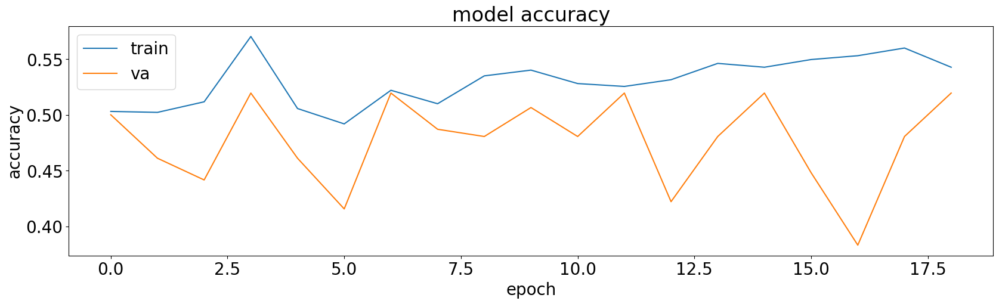

8/8 [==============================] - 1s 6ms/step


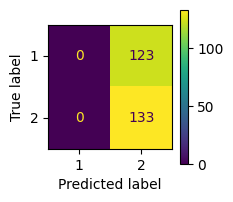

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 12ms/step
| 238       | 0.4214    | 6.961     | 0.06684   | 0.01326   | 3.406     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


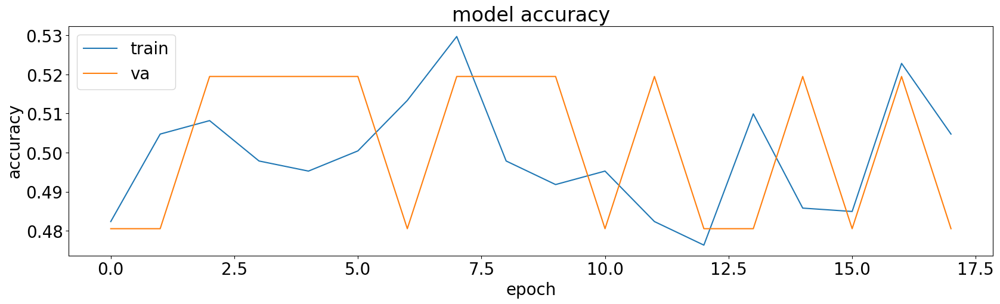

8/8 [==============================] - 1s 9ms/step


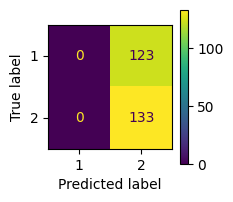

              precision    recall  f1-score   support

           1       0.00      0.00      0.00       123
           2       0.52      1.00      0.68       133

    accuracy                           0.52       256
   macro avg       0.26      0.50      0.34       256
weighted avg       0.27      0.52      0.36       256



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/5 [==============================] - 1s 15ms/step
| 239       | 0.4214    | 7.428     | 0.07384   | 1.556     | 11.89     |


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


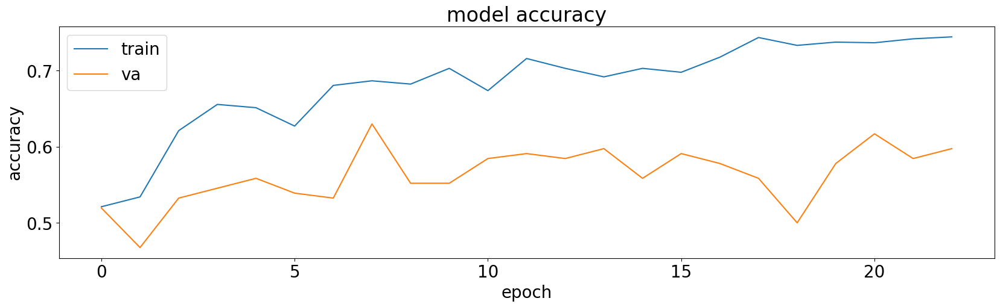

8/8 [==============================] - 1s 9ms/step


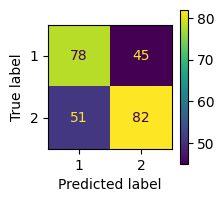

              precision    recall  f1-score   support

           1       0.60      0.63      0.62       123
           2       0.65      0.62      0.63       133

    accuracy                           0.62       256
   macro avg       0.63      0.63      0.62       256
weighted avg       0.63      0.62      0.63       256

5/5 [==============================] - 1s 16ms/step
| 240       | 0.6298    | 7.202     | 0.01191   | 1.978     | 11.42     |


In [42]:
pbounds = {'units': (2, 20),
          'optimizer': (0, 2),
          'batch_size': (6, 9),
          'learning_rate': (0.001, 0.1),
        }

optimizer = BayesianOptimization(
    f=evaluate_network,
    pbounds=pbounds,
    random_state=1
)

# load_logs(optimizer, logs=["./logs.json"])
# logger = JSONLogger(path="./logs.json")
# optimizer.subscribe(Events.OPTIMIZATION_STEP, logger)
optimizer.maximize(init_points=50, n_iter=190)

In [ ]:
run["data"].upload_files("./logs.json")

In [ ]:
run.stop()

In [ ]:
# evaluate_network(batch_size = 6.267, dense_layers = 3.928 , dropout = 0.4027, learning_rate = 0.9463 , lstm_layers = 2.375 , neurons_ini = 5.145,
#                  optimizer = 4.466, units  = 5.031)

#7.174     | 2.517     | 0.5257    | 0.9912    | 1.403     | 6.825     | 0.4284    | 6.115
# evaluate_network(batch_size = 7.174, dense_layers = 2.517 , dropout = 0.5257, learning_rate = 0.9912 , lstm_layers = 1.403 , neurons_ini = 6.825,
#                  optimizer = 0.4284, units  = 6.115)

#  8.67      | 2.654     | 0.5151    | 0.5792    | 1.866     | 6.218     | 4.438     | 4.806
model, _ = evaluate_network(batch_size = 8.67, dense_layers = 2.654 , dropout = 0.5151, learning_rate = 0.5792 , lstm_layers = 1.866 , neurons_ini = 6.218,
                 optimizer = 1, units  = 4.806)

In [ ]:
model = load_model('/content/_melhores_pesos.h5')

In [ ]:
y_pred = model.predict(x_valid)

y_pred = pd.DataFrame(y_pred)
y_pred.columns = [1, 2]
y_pred = y_pred.idxmax(axis=1)

y_te = pd.DataFrame(y_valid)
y_te.columns = [1, 2]
y_te = y_te.idxmax(axis=1)

cf_matrix = confusion_matrix(y_te, y_pred)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cf_matrix, display_labels = ['1','2'])
cm_display.plot()
plt.show()

relatorio = classification_report(y_te, y_pred, target_names = ['1','2'])
print(relatorio)

In [ ]:
def print_history(history, n):
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('accuracy ' + str(n))
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'valid'], loc='upper left')
    # plt.savefig('plot '+classe+'.png')
    plt.show()

In [ ]:
def generate_report(classificador, x_valid, y_valid, columns):
  y_pred = classificador.predict(x_valid)
  y_pred = pd.DataFrame(y_pred)
  y_pred.columns = columns
  y_pred = y_pred.idxmax(axis=1)

  y_valid = pd.DataFrame(y_valid)
  y_valid.columns = columns
  y_valid = y_valid.idxmax(axis=1)

  relatorio = classification_report(y_valid, y_pred)
  print(relatorio)

In [ ]:
class AdaBoost:

    def __init__(self):
        self.alphas = []
        self.G_M = []
        self.M = None
        self.training_errors = []
        self.prediction_errors = []

    def __not_eq(self, a, b):
      if np.array_equal(a, b):
        return 0
      else:
        return 1

    def __idmax(self, y_pred):
      result = []
      for val in y_pred:
        idx = np.argmax(val)
        aux = np.zeros(len(val))
        aux[idx] = 1
        result.append(aux)

      return np.array(result)

    def __compute_error(self, y, y_pred, w_i):
        error = 0
        for i in range(len(y)):
          error += w_i[i] * self.__not_eq(y[i], y_pred[i])
        error = error/sum(w_i)
        return error

    def __compute_alpha(self, error):
        return np.log((1 - error) / error)

    def __update_weights(self, w_i, alpha, y, y_pred):
        return w_i * np.exp(alpha * (self.__not_eq(y, y_pred)))

    def fit(self, x, y, validation_data=None, M=100, epochs=None, batch_size=None, callbacks=None):

        # Clear before calling
        self.alphas = []
        self.training_errors = []
        self.M = M
        best_acc = []
        best_h = []
        best_G = []

        # Iterate over M weak classifiers
        for m in range(0, M):

            # Set weights for current boosting iteration
            if m == 0:
                w_i = np.ones(len(y)) * 1 / len(y)  # At m = 0, weights are all the same and equal to 1 / N
            else:
                # (d) Update w_i
                w_i = self.__update_weights(w_i, alpha_m, y, y_pred)

            # (a) Fit weak classifier and predict labels

            #G_m = create_cnn(self.optimizer)
            G_m = load_model("_melhores_pesos.h5")


            checkpoint = ModelCheckpoint('_pesos_cnn1d.hdf5', monitor="val_accuracy", verbose=1,
                                      save_best_only=True, mode='max')

            history = G_m.fit(x, y, sample_weight = w_i, validation_data=validation_data,
                    epochs=epochs, batch_size=batch_size, callbacks=[checkpoint, callbacks])

            print_history(history, m)

            G_m = load_model('_pesos_cnn1d.hdf5')

            os.remove('_pesos_cnn1d.hdf5')
            # open('_pesos_cnn1d.hdf5', 'w').close()

            #Calcula a acurácia sobre a validação
            y_pred = G_m.predict(validation_data[0])

            idx = np.argmax(y_pred, axis=-1)
            y_pred = np.zeros( y_pred.shape )
            y_pred[ np.arange(y_pred.shape[0]), idx] = 1

            acc= accuracy_score(validation_data[1], y_pred)

            best_acc.append(acc)
            best_h.append(history)
            best_G.append(G_m)


            # if m == 0 or (acc > best_acc):
            #   best_acc = acc
            #   best_G = G_m
            #   best_h = history

            y_pred = G_m.predict(x)
            y_pred = self.__idmax(y_pred)

            self.G_M.append(G_m) # Save to list of weak classifiers

            # (b) Compute error
            error_m = self.__compute_error(y, y_pred, w_i)
            self.training_errors.append(error_m)

            # (c) Compute alpha
            alpha_m = self.__compute_alpha(error_m)
            self.alphas.append(alpha_m)

        assert len(self.G_M) == len(self.alphas)

        return best_G, best_h, best_acc

    def predict(self, x):

        # Initialise dataframe with weak predictions for each observation
        weak_preds = pd.DataFrame(index = range(len(x)), columns = range(self.M))

        # Predict class label for each weak classifier, weighted by alpha_m
        for m in range(self.M):
            y_pred_m = self.G_M[m].predict(x) * self.alphas[m]
            for i in range(weak_preds.shape[0]):
              weak_preds.iloc[i,m] = y_pred_m[i]

        # Calculate final predictions
        y_pred = weak_preds.T.sum()
        y_pred =  self.__idmax(y_pred)

        return y_pred

In [ ]:
columns = y_train.columns

In [ ]:
y_train = np.array(y_train, dtype=int)
y_valid = np.array(y_valid, dtype=int)

print(columns)

# checkpoint = ModelCheckpoint('_pesos_cnn1d.hdf5', monitor="val_accuracy", verbose=1,
#                                     save_best_only=True, mode='max')

es = EarlyStopping(monitor="val_accuracy", mode='max', verbose=0, patience=15)

adaboost = AdaBoost()

best_G, best_h, best_acc = adaboost.fit(x_train, y_train, validation_data = (x_valid, y_valid),
                     M=10, epochs=100, batch_size=64, callbacks=es)

generate_report(adaboost, x_valid, y_valid, columns)

plt.plot(best_acc)
plt.title("Acurácia de cada modelo")
plt.show()


In [ ]:
def eq_w(model1, model2):
  model1_weights = [layer.get_weights() for layer in model1.layers]
  model2_weights = [layer.get_weights() for layer in model2.layers]

  for (w1, w2) in zip(model1_weights, model2_weights):
      if not all(np.array_equal(x, y) for (x, y) in zip(w1, w2)):
          print("The models have different weights.")
          break
  else:
      print("The models have the same weights.")


In [ ]:
eq_w(best_G[0], best_G[1])

In [ ]:
y_pred = adaboost.predict(x_valid)
y_pred = pd.DataFrame(y_pred)
y_pred.columns = ['1', '2']
y_pred = y_pred.idxmax(axis=1)
y_te = pd.DataFrame(y_valid)
y_te.columns = ['1', '2']
y_te = y_te.idxmax(axis=1)

plt.rcParams['figure.figsize']=(20,5)
plt.rcParams.update({'font.size': 20})

cf_matrix = confusion_matrix(y_te, y_pred)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cf_matrix, display_labels = ['1','2'])
cm_display.plot()
plt.show()

relatorio = classification_report(y_te, y_pred, target_names = ['1','2'])
print(relatorio)

In [ ]:
y_pred = adaboost.predict(x_test)
y_pred = pd.DataFrame(y_pred)
y_pred.columns = ['1', '2']
y_pred = y_pred.idxmax(axis=1)
y_te = pd.DataFrame(y_test)
y_te.columns = ['1', '2']
y_te = y_te.idxmax(axis=1)

plt.rcParams['figure.figsize']=(20,5)
plt.rcParams.update({'font.size': 20})

cf_matrix = confusion_matrix(y_te, y_pred)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cf_matrix, display_labels = ['1','2'])
cm_display.plot()
plt.show()

relatorio = classification_report(y_te, y_pred, target_names = ['1','2'])
print(relatorio)

In [ ]:
# |   iter    |  target   | batch_... | dense_... |  dropout  | learni... | lstm_l... | neuron... | optimizer |   units
# | 36        | 0.73      | 8.489     | 3.39      | 0.4147    | 0.6446    | 3.537     | 6.876     | 3.949     | 3.693
# | 108       | 0.701     | 6.267     | 3.928     | 0.4027    | 0.9463    | 2.375     | 5.145     | 4.466     | 5.031
# evaluate_network(batch_size = 8.489, dense_layers = 3.39, dropout = 0.4147, learning_rate = 0.6446, lstm_layers = 3.537, neurons_ini = 6.876,
#                  optimizer = 3.949, units  = 3.693)

# evaluate_network(batch_size = 6.267, dense_layers = 3.928 , dropout = 0.4027, learning_rate = 0.9463 , lstm_layers = 2.375 , neurons_ini = 5.145,
#                  optimizer = 4.466, units  = 5.031)

In [ ]:
model = load_model('/content/_melhores_pesos.h5')

In [ ]:
for i,signal in enumerate(raw_x_test):
  s, _ = split_beats([signal], [raw_y_test[i]], bps)
  raw_x_test[i] = norm_len_2(s, lim)

### Usando a moda

In [ ]:
y_pred = []
for signal in raw_x_test:

  prediction = model.predict(np.array(signal))
  prediction = pd.DataFrame(prediction)
  prediction.columns = [1,2]
  prediction = prediction.idxmax(axis=1)
  val = prediction.mode()[0]
  y_pred.append(val)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn import metrics

plt.rcParams['figure.figsize']=(2,2)
plt.rcParams.update({'font.size': 10})

cf_matrix = confusion_matrix(y_test, y_pred)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cf_matrix, display_labels = ['1','2'])
cm_display.plot()

In [ ]:
from sklearn.metrics import classification_report

relatorio = classification_report(y_test, y_pred, target_names = ['1','2'])
print(relatorio)

### Usando a soma das probabilidades

In [ ]:
y_pred = []
for signal in raw_x_test:

  prediction = model.predict(np.array(signal))
  prediction = np.sum(prediction, axis=0)
  prediction = pd.DataFrame([prediction])
  prediction.columns = [1,2]
  val = prediction.idxmax(axis=1)[0]
  y_pred.append(val)

In [ ]:
y_pred

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn import metrics

plt.rcParams['figure.figsize']=(2,2)
plt.rcParams.update({'font.size': 10})

cf_matrix = confusion_matrix(y_test, y_pred)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cf_matrix, display_labels = ['1','2'])
cm_display.plot()

In [ ]:
from sklearn.metrics import classification_report

relatorio = classification_report(y_test, y_pred, target_names = ['1','2'])
print(relatorio)